In [1]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import AlgoLoop
import StatisticFunc

plt.style.use('Solarize_Light2')                     # 绘图风格
matplotlib.rcParams['font.sans-serif'] = ['SimHei']  # 字体雅黑
matplotlib.rcParams['font.family'] = 'sans-serif'
matplotlib.rcParams['axes.unicode_minus'] = False    # 处理负号

# 预处理

## 提取并处理数据

### 权益类资产换手率

In [2]:
Turnovers = pd.read_excel(io="Raw/国内资产换手率.xlsx")                      # 读取数据
Turnovers = Turnovers.drop([0], axis=0)                                   # 删除多余行
Turnovers["日期"] = pd.DatetimeIndex(Turnovers["日期"])                    # 类型转换
Turnovers = Turnovers.set_index("日期")                                   # 设置索引

In [3]:
Turnovers = Turnovers.drop(Turnovers.index[0], axis=0)                   # 日期对齐

### GC007利率

In [4]:
Rates = pd.read_excel(io="Raw/GC007利率.xlsx")           #  读取数据
Rates = Rates.drop([0, 1, 2], axis=0)                   # 删除多余行
Rates.columns = ['日期', 'GC007']                        # 修改列名
Rates["日期"] = pd.DatetimeIndex(Rates["日期"])           # 类型转换
Rates = Rates.set_index("日期")                          # 设置索引

In [5]:
Rates = Rates.drop(Rates.index[0], axis=0)                     # 日期对齐

### 十年国债收益率

In [6]:
BondRates = pd.read_excel(io="Raw/中债国债到期收益率(中债)(日).xls")        # 读取数据
BondRates.columns = ['日期', '十年国债收益率']                             # 修改列名
BondRates = BondRates.drop([0, 3870, 3871], axis=0)                     # 删除多余行
BondRates["日期"] = pd.DatetimeIndex(BondRates["日期"])                   # 类型转换
BondRates = BondRates.set_index("日期")                                  # 设置索引

### 各资产收盘价

In [7]:
Assets = pd.read_excel(io="Raw/国内资产收盘价.xlsx")
Assets = Assets.drop([0], axis=0)                                   # 删除多余行
Assets["日期"] = pd.DatetimeIndex(Assets["日期"])                    # 类型转换
Assets = Assets.set_index("日期")                                   # 设置索引

## 衍生数据生成

### 铜金价格比 & 铜油价格比

In [8]:
Data = Assets.merge(BondRates, how='left', left_index=True, right_index=True)

In [9]:
Data = Data.merge(Rates, how='left', left_index=True, right_index=True)

In [10]:
Data['铜金价格比'] = Data['中信证券COMEX铜期货'] / Data['中信证券COMEX黄金期货']
Data['铜油价格比'] = Data['中信证券COMEX铜期货'] / Data['中信证券WTI原油期货']

### 十年国债价格指数

In [11]:
Data['持有时长'] = (Data.index - Data.index[0]).days
Data['10年国债价格指数'] = 100 - (Data['十年国债收益率'] - 3.0) * 8.2 + 3.0 * Data['持有时长'] / 365.0
Data['10年国债价格指数'] = Data['10年国债价格指数'].fillna(method='ffill')

## 计算各资产收益率

### 日内损益

In [12]:
# 利用自制10年国债价格指数，替换上证10年国债
Assets['上证10年国债'] = Data['10年国债价格指数'].values

In [13]:
Returns = Assets.pct_change(axis=0)
Returns = Returns.dropna(axis=0, how='all')           # 删除无数据日

### 累计损益

In [14]:
cumReturns = (1.0 + Returns)
cumReturns = cumReturns.fillna(1.0)                    # 填充空值
cumReturns = cumReturns.cumprod()                      # 计算各资产累计收益率

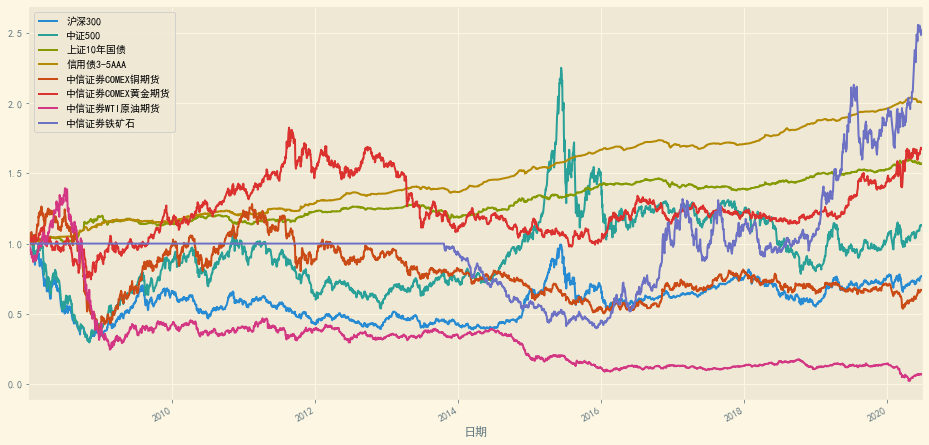

In [15]:
cumReturns.plot(figsize=(16, 8))

# 风险平价 （指数权重EMA）

**资产明细**
- 沪深300指数
- 中证500指数
- 三年期3A信用债全价指数
- 十年期国债全价指数(自制)
- COMEX铜
- COMEX黄金
- NYMEX原油
- 铁矿石期货

回溯时间：2008年初-至今

买卖单笔手续费：千1

## 程序运行

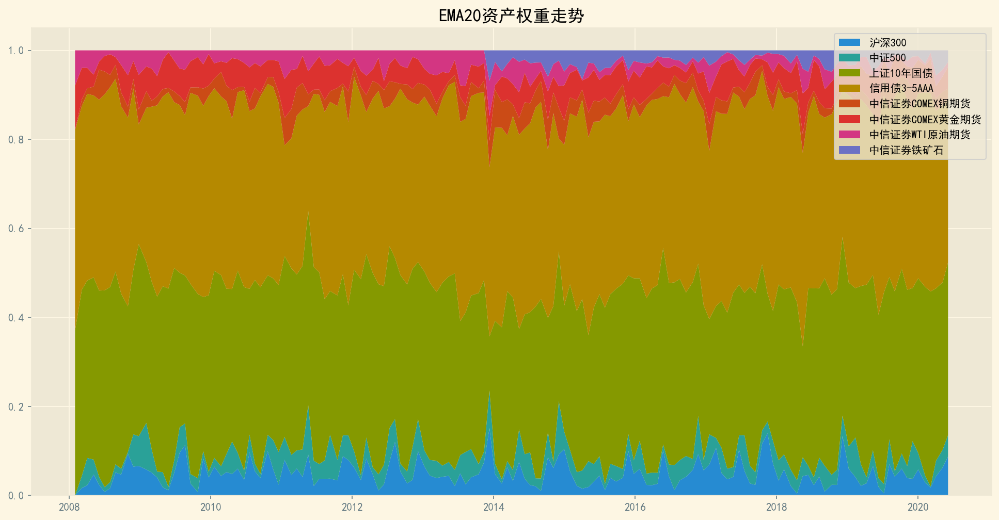

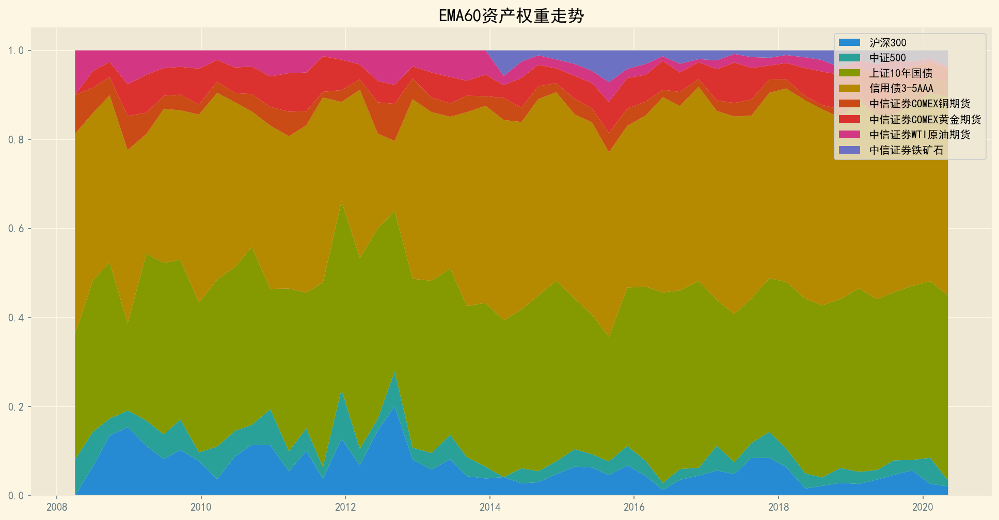

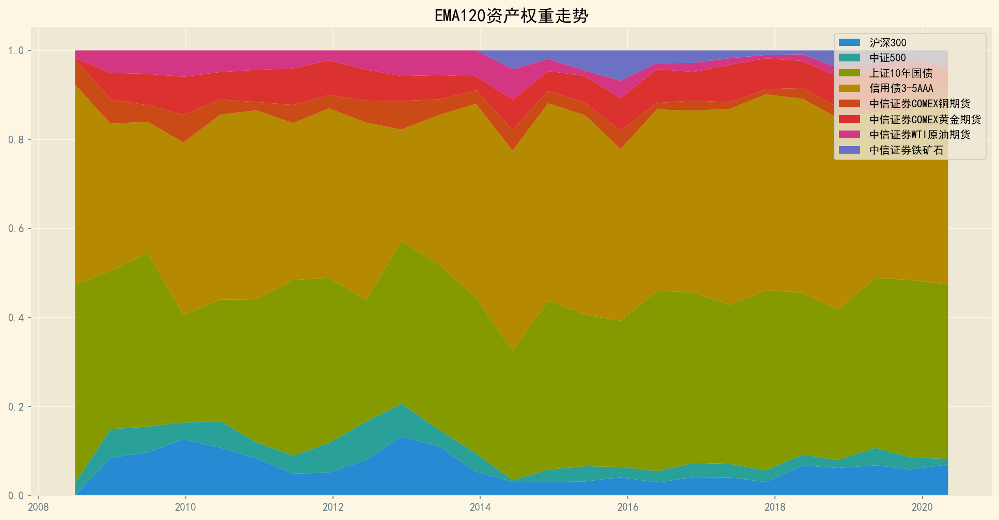

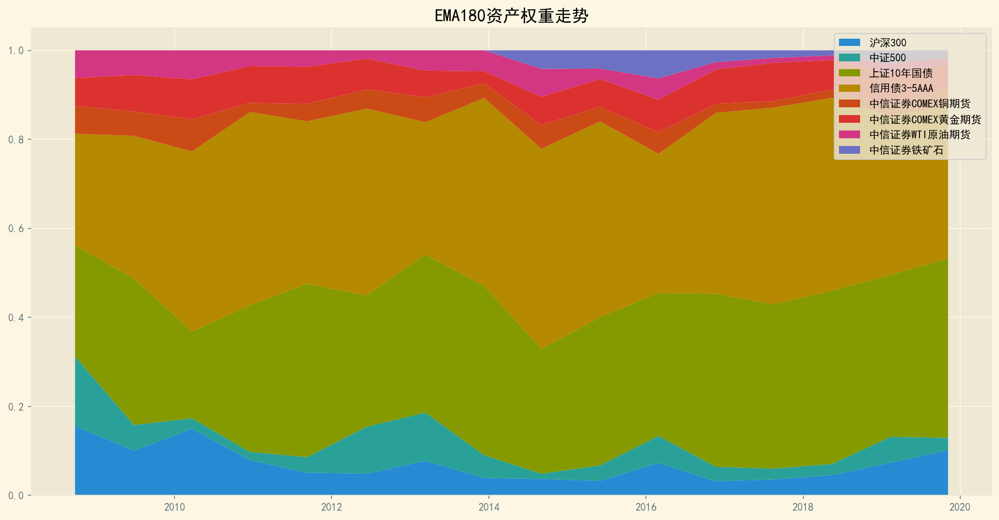

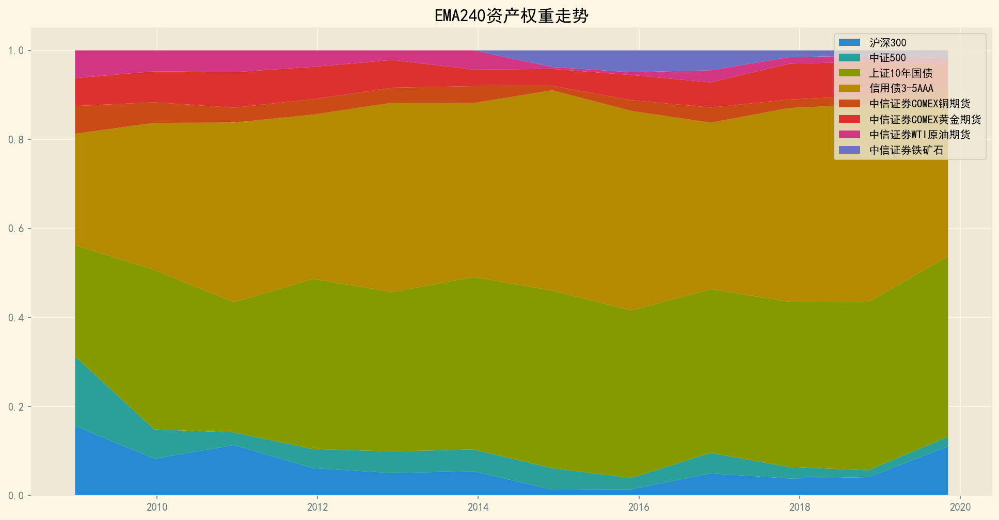

In [16]:
# 运行
timeWindow = [20, 60, 120, 180, 240]           # 调仓周期

NetValueDF_ema = pd.DataFrame(index=Returns.index)
DailyPnlDF_ema = pd.DataFrame(index=Returns.index) 
DrawDownDF_ema = pd.DataFrame(index=Returns.index)

for dtime in timeWindow:
    tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, Returns, cumReturns, Turnovers, mode='ema', dt=dtime)
    StatisticFunc.WeightPlot(tradeDF, weightDF, 'EMA'+str(dtime))
    
    NetValueDF_ema[str(dtime)+'组合净值'] = tradeDF['投资组合净值'] / 10000  
    DailyPnlDF_ema[str(dtime)+'组合日收益率'] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
    DrawDownDF_ema[str(dtime)+'最大回撤'] = tradeDF['最大回撤']                      

## 回测表现汇总

In [17]:
# 汇总
summaryDF_ema = pd.DataFrame(index=['每月调仓', '每季度调仓', '每半年调仓', 
                                    '每三季度调仓', '每年调仓'])

summaryDF_ema["年平均收益率"] = DailyPnlDF_ema.mean(axis=0).values * 250
summaryDF_ema["年平均标准差"] = DailyPnlDF_ema.std(axis=0).values * np.sqrt(250)
summaryDF_ema["无基准夏普比率"] = summaryDF_ema["年平均收益率"] / summaryDF_ema["年平均标准差"]
summaryDF_ema["最大回撤"] = DrawDownDF_ema.min(axis=0).values
summaryDF_ema

,年平均收益率,年平均标准差,无基准夏普比率,最大回撤
每月调仓,0.033828,0.039312,0.860506,-0.068157
每季度调仓,0.052620,0.049520,1.062597,-0.100331
每半年调仓,0.055143,0.046333,1.190158,-0.078946
每三季度调仓,0.056347,0.056922,0.989898,-0.132513
每年调仓,0.074895,0.059094,1.267371,-0.104662


## 各投资组合净值曲线

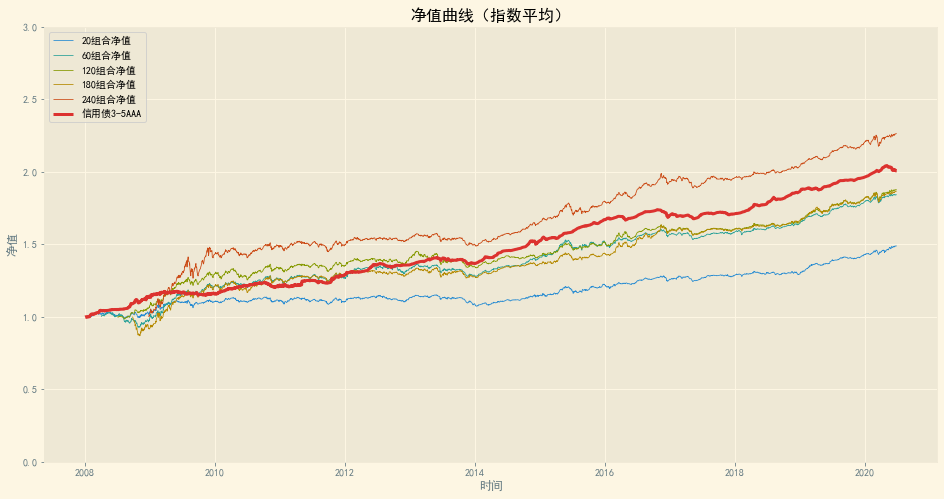

In [18]:
fig = plt.figure(figsize=(16, 8))

for col in NetValueDF_ema.columns:
    plt.plot(NetValueDF_ema.index, NetValueDF_ema[col], lw=0.8, label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 3.0)
plt.legend(loc='upper left')
plt.title('净值曲线（指数平均）')
plt.show()

## 年间收益率分布

In [ ]:
yearReturns_ema = StatisticFunc.annualReturns(NetValueDF_ema)

In [ ]:
StatisticFunc.ReturnDist(yearReturns_ema, 2)

## 月间收益率分布

In [ ]:
monthlyReturns_ema = StatisticFunc.monthlyReturns(NetValueDF_ema)

In [ ]:
StatisticFunc.ReturnDist(monthlyReturns_ema, 2)

# 风险平价 + 杠杆策略（指数权重EMA）

## 杠杆调整后的债券净值

In [19]:
lever = 2.0                                 # 杠杆
leverReturns = Returns.copy()               # 创建副本 
leverCumReturns = cumReturns.copy()   

# 更新杠杆调整后的债券净值
leverReturns.loc[:, ['上证10年国债', '信用债3-5AAA']] = Returns.loc[:, ['上证10年国债', '信用债3-5AAA']] * (1.0 + lever) - Rates.values * lever / (365.0 * 100)

# 更新累计净值
leverCumReturns = (1.0 + leverReturns)
leverCumReturns = leverCumReturns.fillna(1.0)                    # 填充空值
leverCumReturns = leverCumReturns.cumprod()                      # 计算各资产累计收益率

In [20]:
leverReturns

,沪深300,中证500,上证10年国债,信用债3-5AAA,中信证券COMEX铜期货,中信证券COMEX黄金期货,中信证券WTI原油期货,中信证券铁矿石
日期,,,,,,,,
2008-01-03,0.006858,0.020846,0.00291366,-0.00496922,0.037320,0.007522,-0.007431,NaN
2008-01-04,0.011364,0.002348,0.00708695,0.00101937,-0.009513,-0.003857,-0.012751,NaN
2008-01-07,0.013302,0.019983,0.00249391,0.000364268,-0.006374,-0.005423,-0.029923,NaN
2008-01-08,-0.005136,-0.027535,-0.00194137,-0.00423672,0.051530,0.022578,0.014378,NaN
2008-01-09,0.015503,0.029983,0.000214022,-0.00138699,-0.005478,0.000652,-0.008178,NaN
...,...,...,...,...,...,...,...,...
2020-06-19,0.013432,0.009198,-0.0039725,-0.00024998,0.006846,0.012794,0.020118,0.004563
2020-06-22,0.000814,-0.000539,-0.00676313,-0.00322565,0.012442,0.006962,0.021904,-0.014276
2020-06-23,0.004814,0.003512,0.000476333,-0.00583903,-0.000490,0.006070,-0.011552,-0.005267


## 程序运行

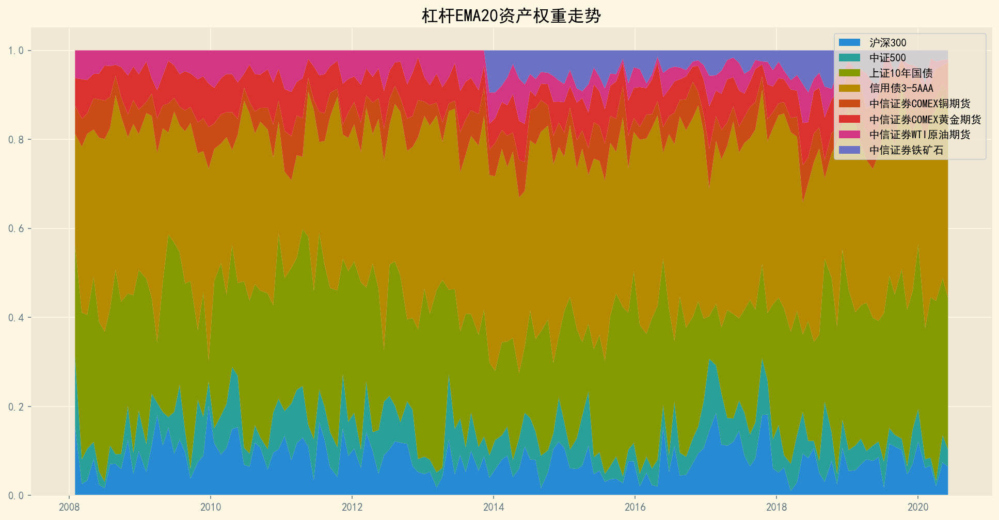

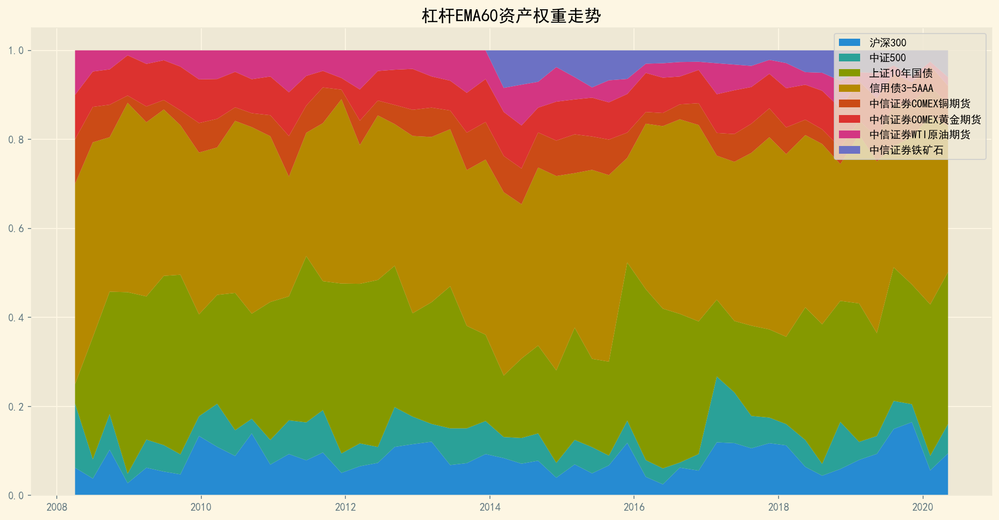

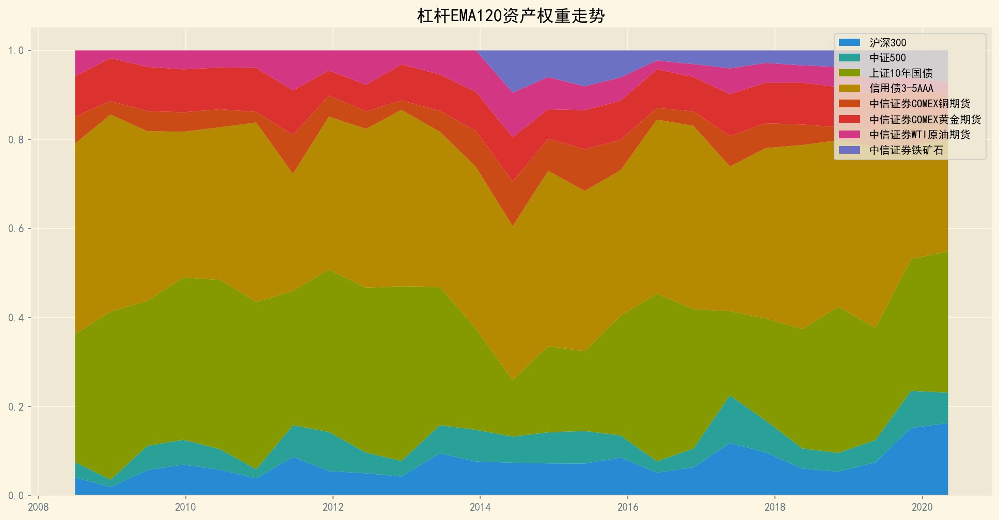

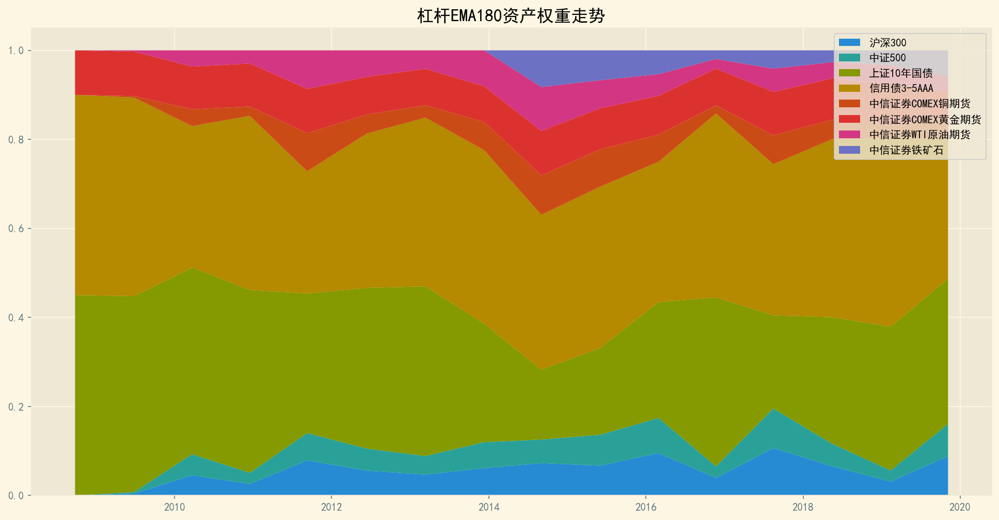

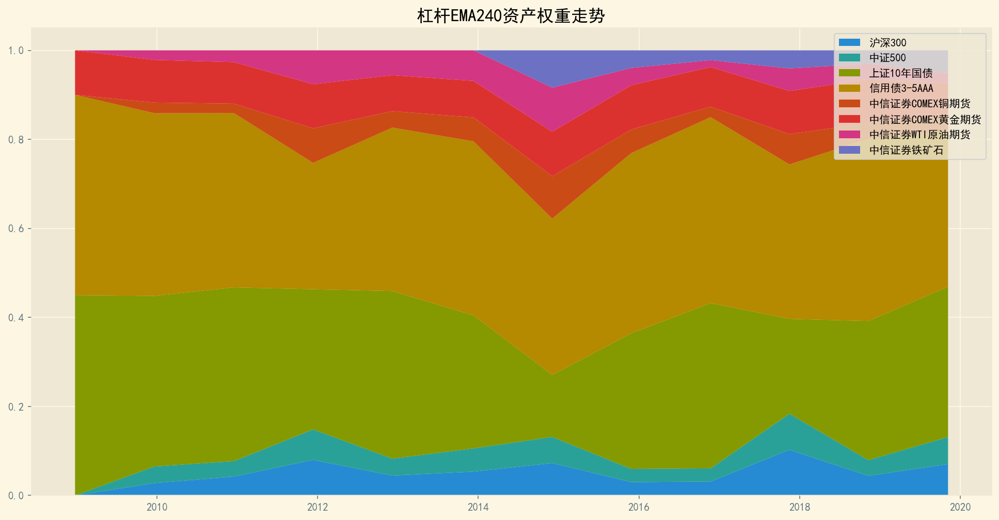

In [21]:
# 运行
timeWindow = [20, 60, 120, 180, 240]           # 调仓周期

leverNetValueDF_ema = pd.DataFrame(index=Returns.index)
leverDailyPnlDF_ema = pd.DataFrame(index=Returns.index) 
leverDrawDownDF_ema = pd.DataFrame(index=Returns.index)

for dtime in timeWindow:
    tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, mode='ema', dt=dtime)
    StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆EMA'+str(dtime))
    
    leverNetValueDF_ema[str(dtime)+'组合净值'] = tradeDF['投资组合净值'] / 10000  
    leverDailyPnlDF_ema[str(dtime)+'组合日收益率'] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
    leverDrawDownDF_ema[str(dtime)+'最大回撤'] = tradeDF['最大回撤']                      

## 回测表现汇总

In [22]:
# 汇总
leverSummaryDF_ema = pd.DataFrame(index=['每月调仓', '每季度调仓', '每半年调仓', 
                                    '每三季度调仓', '每年调仓'])

leverSummaryDF_ema["年平均收益率"] = leverDailyPnlDF_ema.mean(axis=0).values * 250
leverSummaryDF_ema["年平均标准差"] = leverDailyPnlDF_ema.std(axis=0).values * np.sqrt(250)
leverSummaryDF_ema["无基准夏普比率"] = leverSummaryDF_ema["年平均收益率"] / leverSummaryDF_ema["年平均标准差"]
leverSummaryDF_ema["最大回撤"] = leverDrawDownDF_ema.min(axis=0).values
leverSummaryDF_ema

,年平均收益率,年平均标准差,无基准夏普比率,最大回撤
每月调仓,0.073364,0.069669,1.053046,-0.157648
每季度调仓,0.066190,0.068100,0.971952,-0.143157
每半年调仓,0.077886,0.066753,1.166772,-0.135065
每三季度调仓,0.070110,0.065055,1.077703,-0.152795
每年调仓,0.057341,0.061943,0.925708,-0.147245


## 各投资组合净值曲线

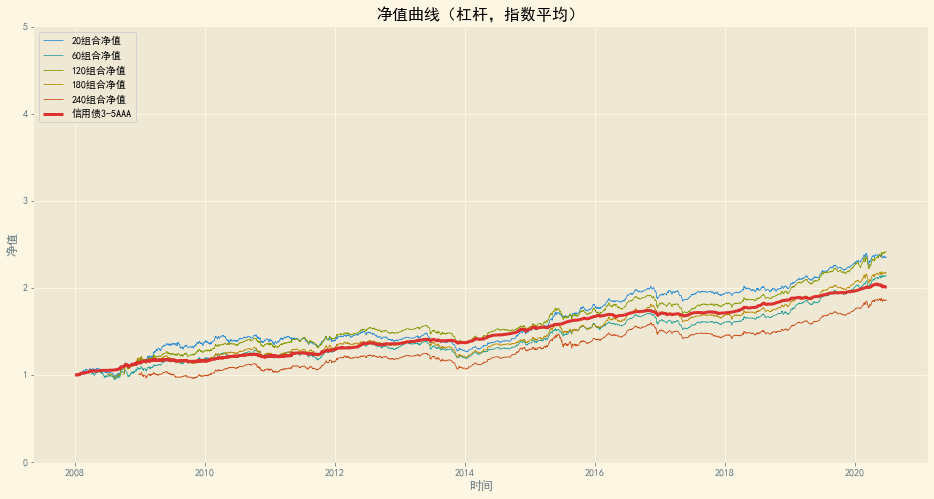

In [23]:
fig = plt.figure(figsize=(16, 8))

for col in leverNetValueDF_ema.columns:
    plt.plot(leverNetValueDF_ema.index, leverNetValueDF_ema[col], lw=0.8, label=col)
    
# plt.plot(cumReturns.index, cumReturns['中证500'], lw=1.5, label='中证500')
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('净值曲线（杠杆，指数平均）')
plt.show()

## 年间收益率分布

In [ ]:
yearReturns_ema = StatisticFunc.annualReturns(NetValueDF_ema)

In [ ]:
StatisticFunc.ReturnDist(yearReturns_ema, 2)

## 月间收益率分布

In [ ]:
monthlyReturns_ema = StatisticFunc.monthlyReturns(NetValueDF_ema)

In [ ]:
StatisticFunc.ReturnDist(monthlyReturns_ema, 2)

# 风险平价 + 杠杆 + 因子策略（指数权重EMA）

## 动量因子（横向比较）

### 程序运行

In [40]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]        # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_momentumX = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_momentumX = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_momentumX = pd.DataFrame(index=Returns.index, columns=multiIDX)

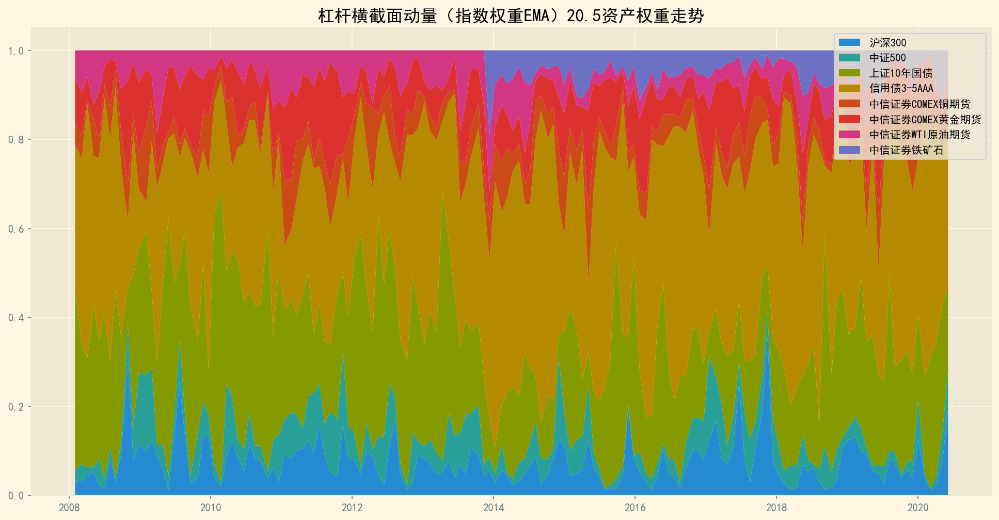

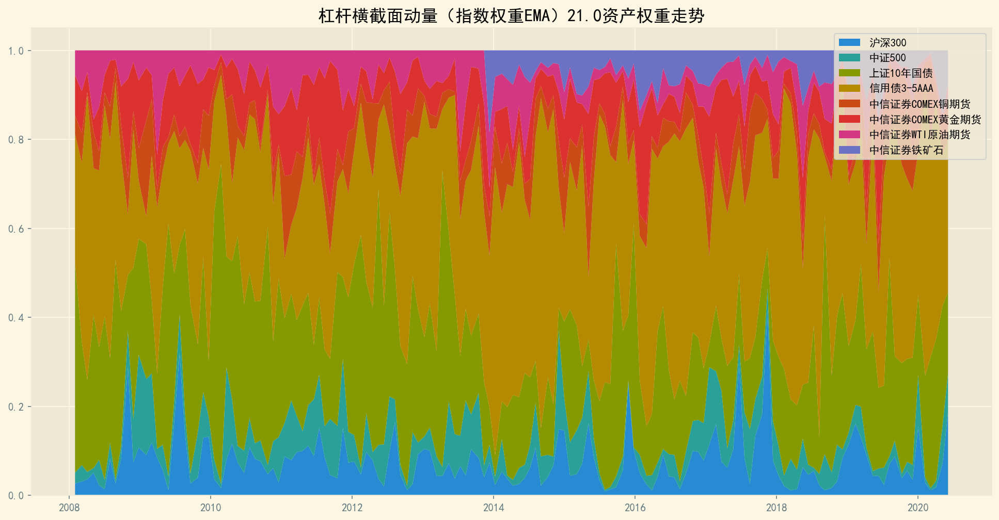

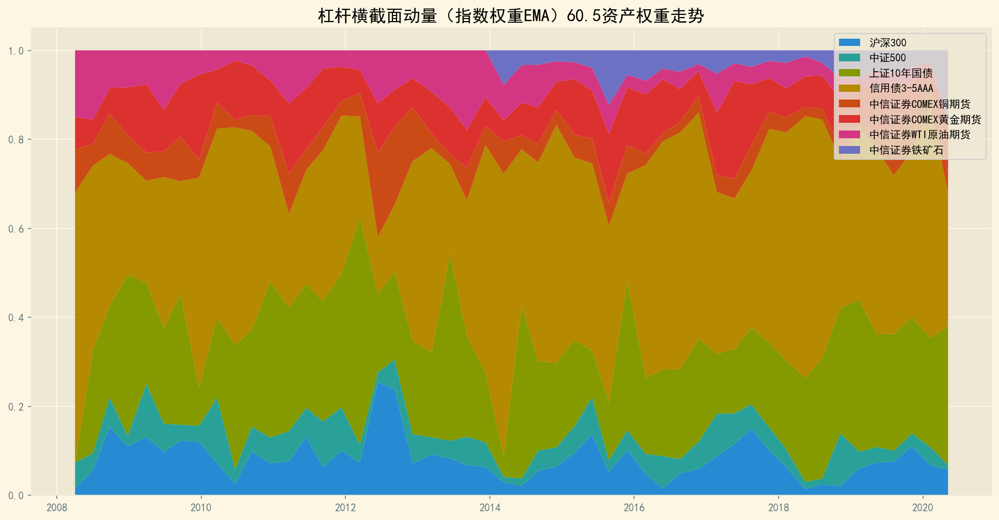

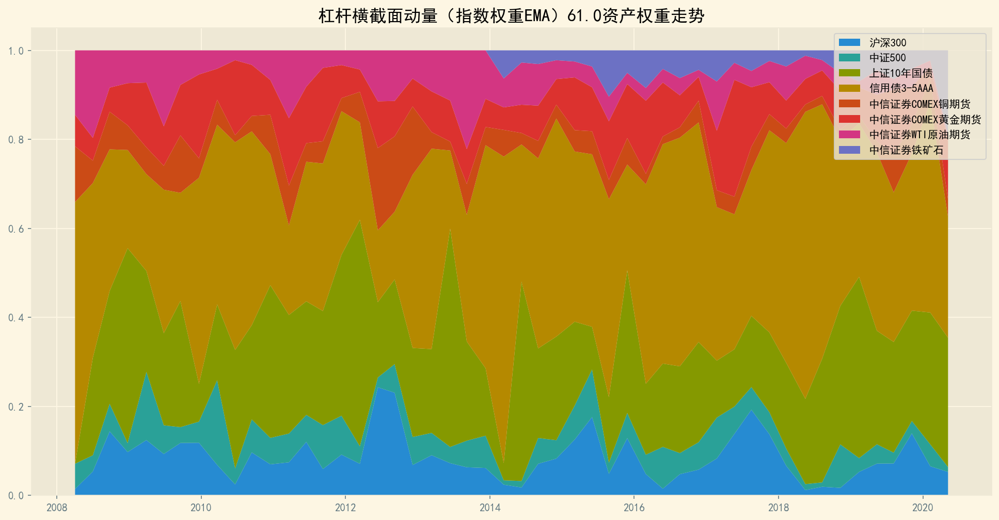

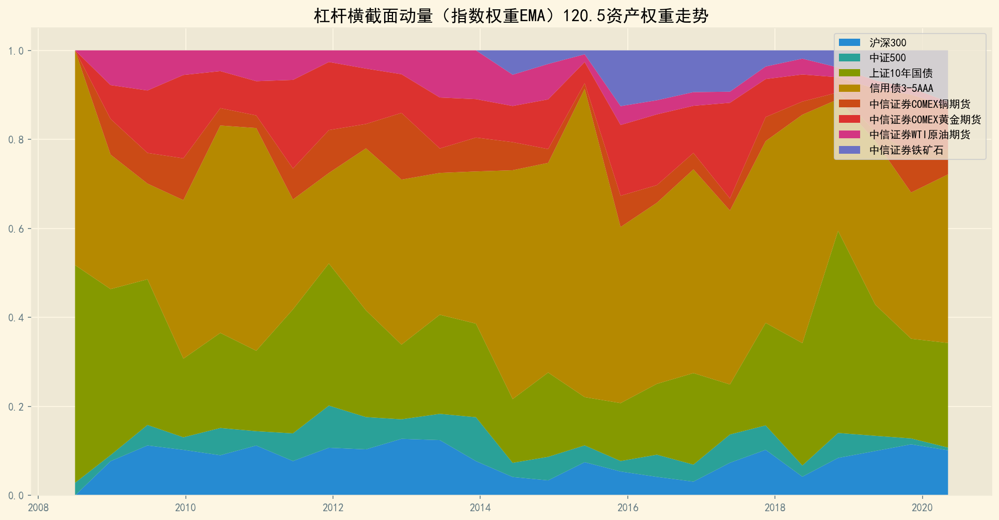

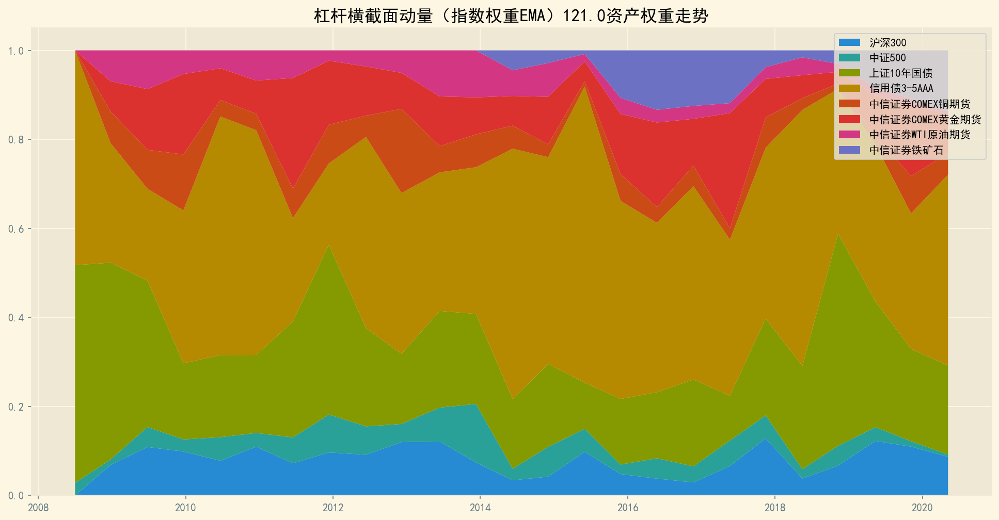

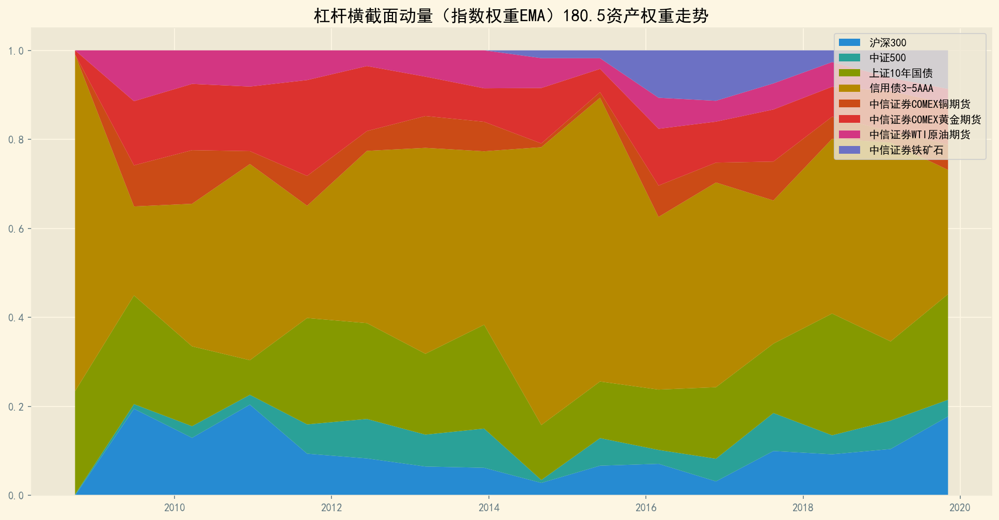

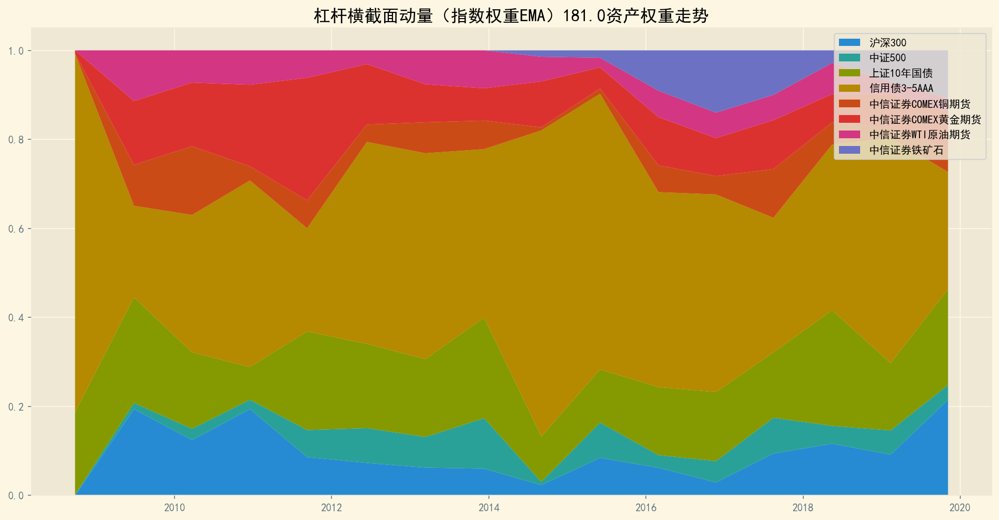

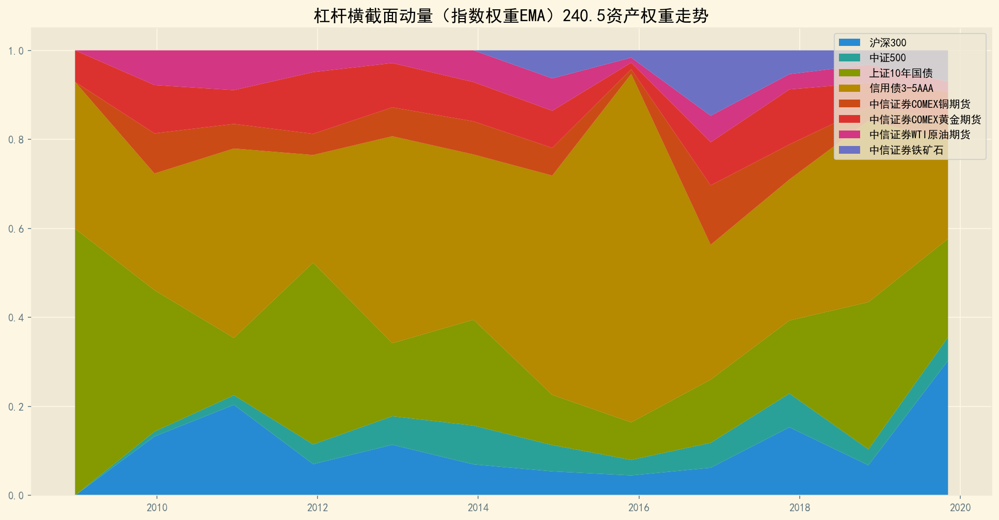

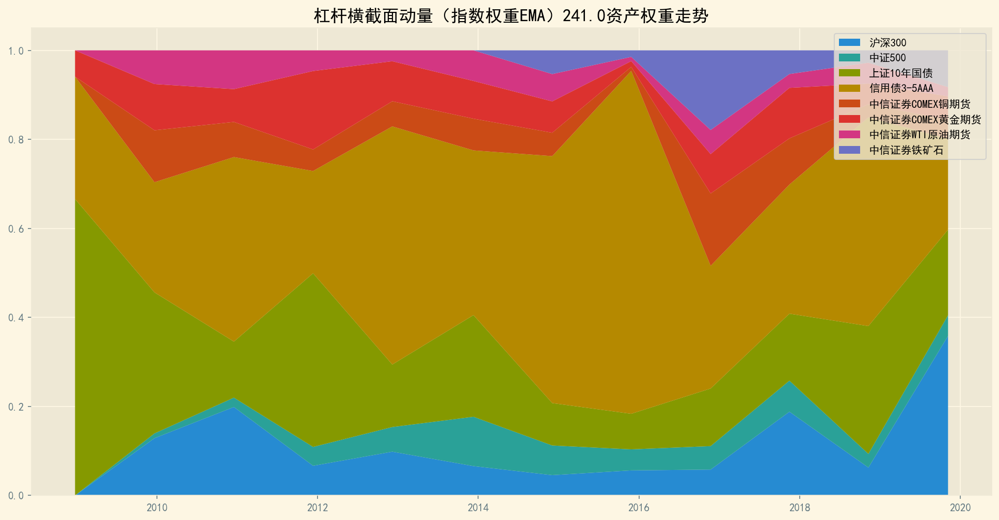

In [41]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':True, 'momentumT':False, 
           'reverseX':False, 'reverseT':False, 
           'turnover':False,  
           'copperGold':False, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='ema', dt=t, up=u, thresholds=thrds,
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆横截面动量（指数权重EMA）'+str(t+u))

        leverNetValueDF_momentumX.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000
        leverDailyPnlDF_momentumX.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_momentumX.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [42]:
# 汇总
leverSummaryDF_momentumX = pd.DataFrame(index=multiIDX)

leverSummaryDF_momentumX["年平均收益率"] = leverDailyPnlDF_momentumX.mean(axis=0).values * 250
leverSummaryDF_momentumX["年平均标准差"] = leverDailyPnlDF_momentumX.std(axis=0).values * np.sqrt(250)
leverSummaryDF_momentumX["无基准夏普比率"] = leverSummaryDF_momentumX["年平均收益率"] / leverSummaryDF_momentumX["年平均标准差"]
leverSummaryDF_momentumX["最大回撤"] = leverDrawDownDF_momentumX.min(axis=0).values

leverSummaryDF_momentumX

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.081012  0.075895  1.067428 -0.155108
     1.0   0.084920  0.078531  1.081351 -0.170288
60   0.5   0.079105  0.075725  1.044630 -0.147947
     1.0   0.075363  0.078199  0.963733 -0.160630
120  0.5   0.118133  0.075757  1.559364 -0.142066
     1.0   0.117756  0.077028  1.528745 -0.145037
180  0.5   0.090308  0.075866  1.190362 -0.123071
     1.0   0.088760  0.077993  1.138043 -0.121513
240  0.5   0.057281  0.068468  0.836616 -0.122590
     1.0   0.057155  0.071384  0.800666 -0.123610

### 各投资组合净值曲线

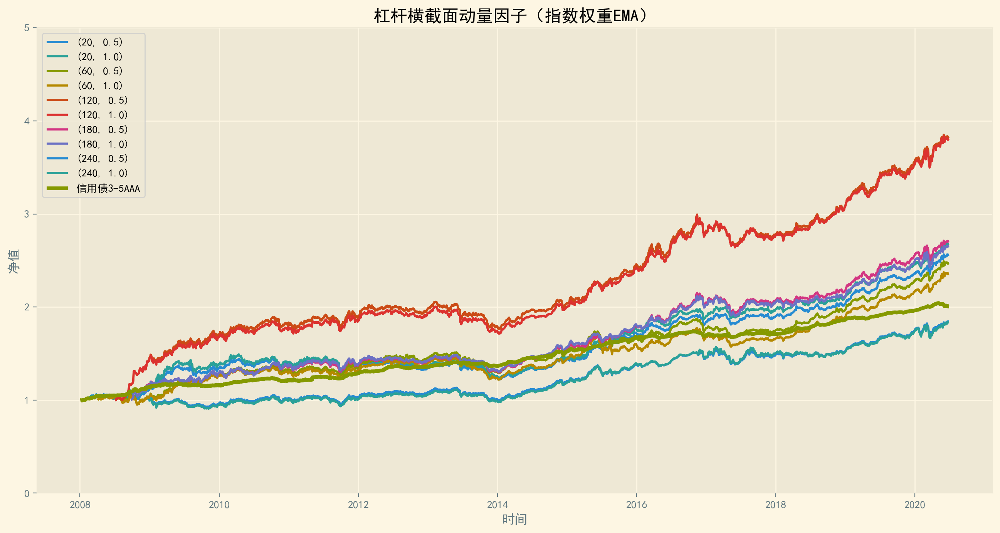

In [43]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_momentumX.columns:
    plt.plot(leverNetValueDF_momentumX.index, leverNetValueDF_momentumX[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.5, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆横截面动量因子（指数权重EMA）')
plt.show()

## 动量因子（时序比较）

### 程序运行

In [62]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_momentumT = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_momentumT = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_momentumT = pd.DataFrame(index=Returns.index, columns=multiIDX)

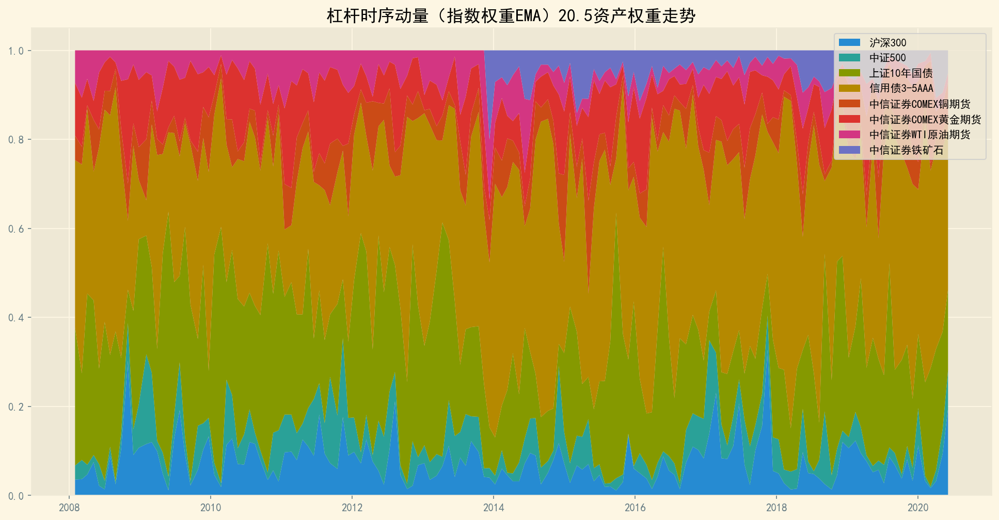

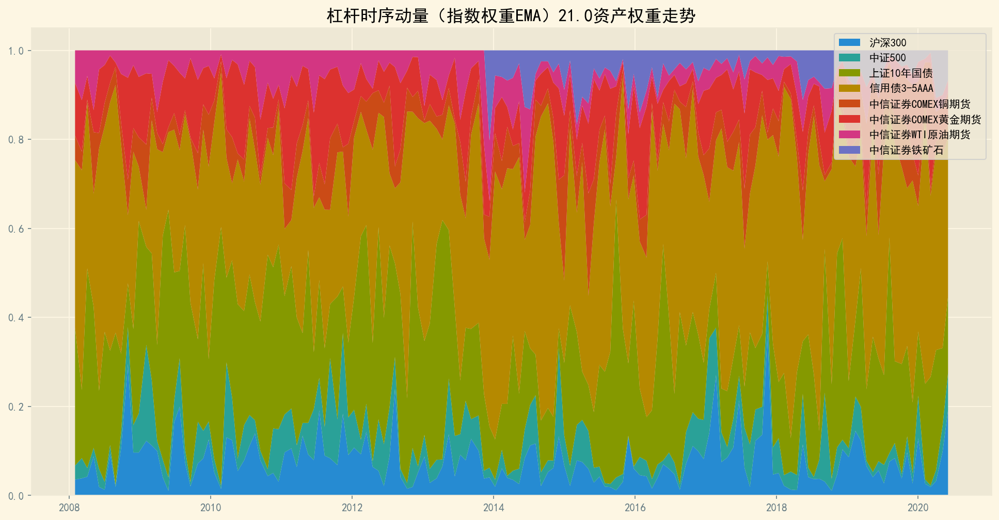

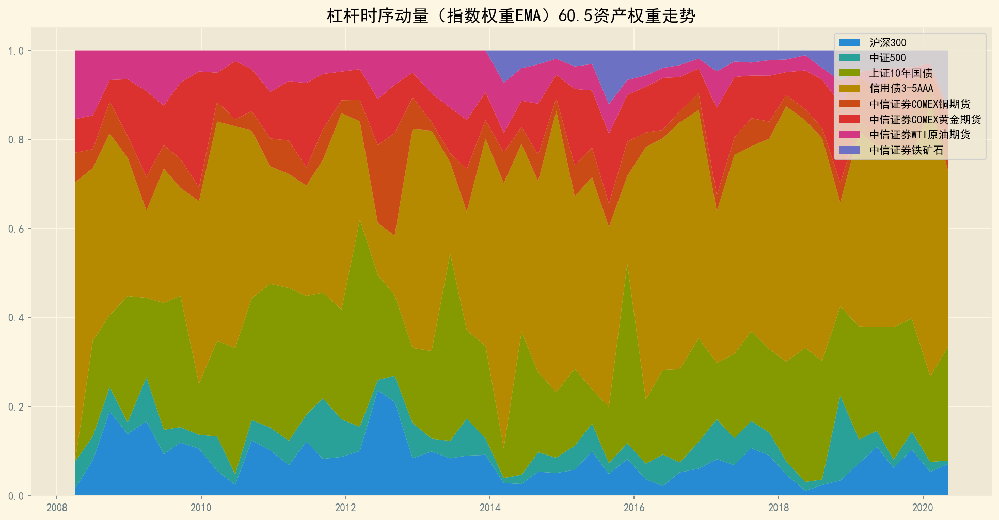

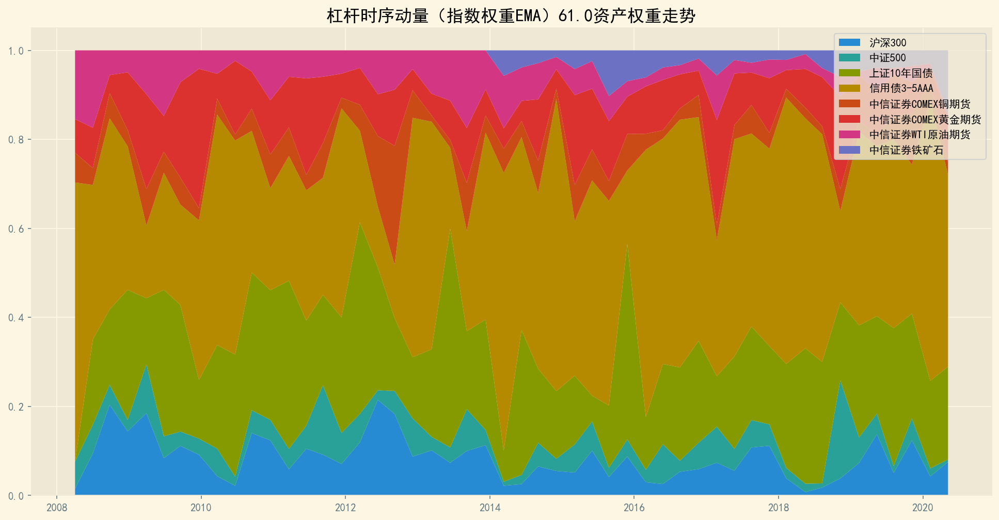

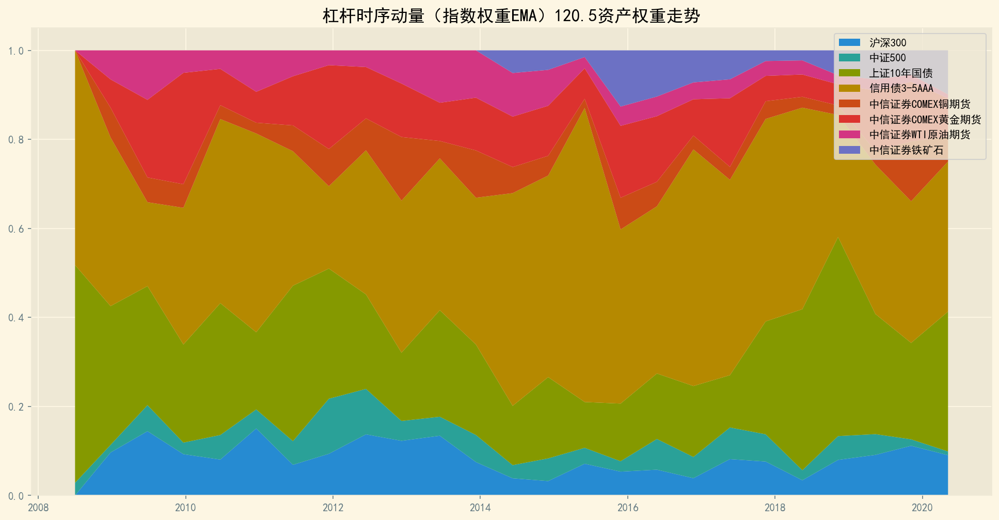

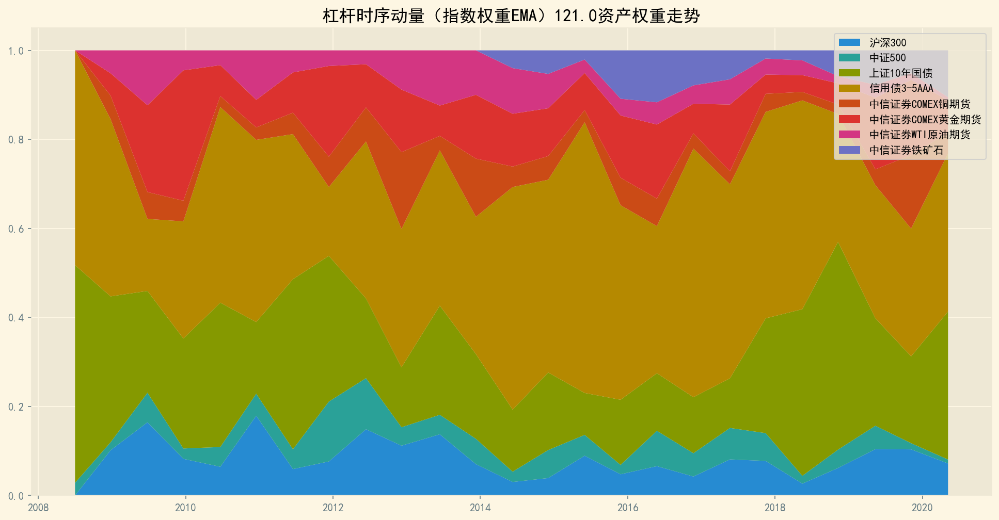

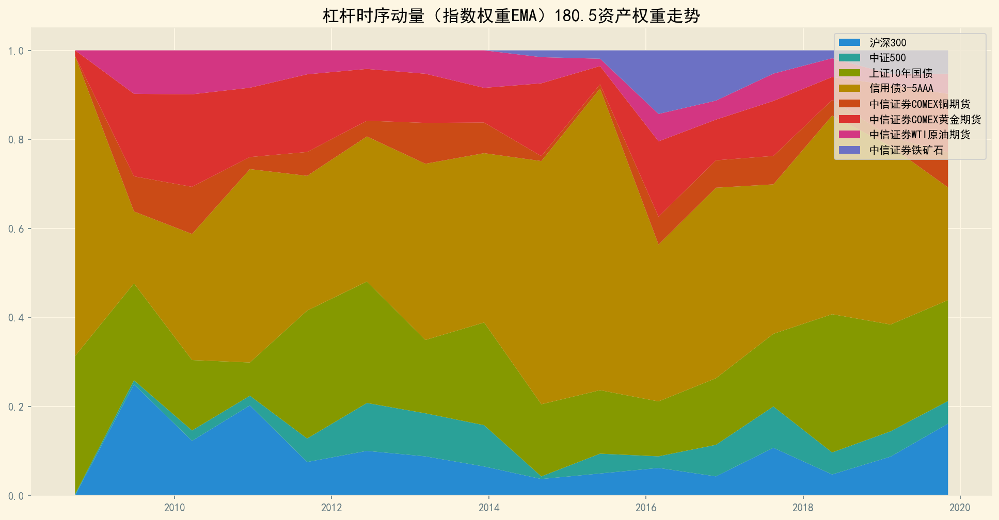

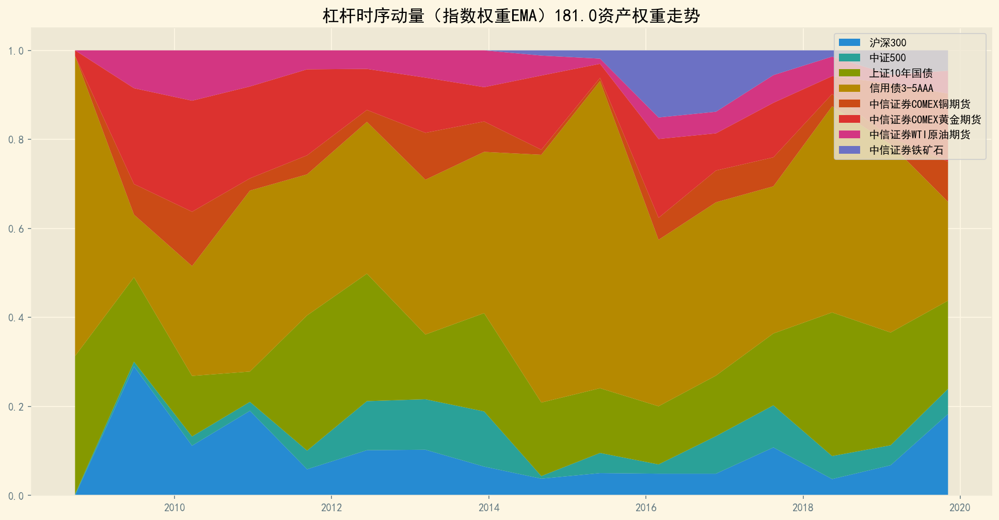

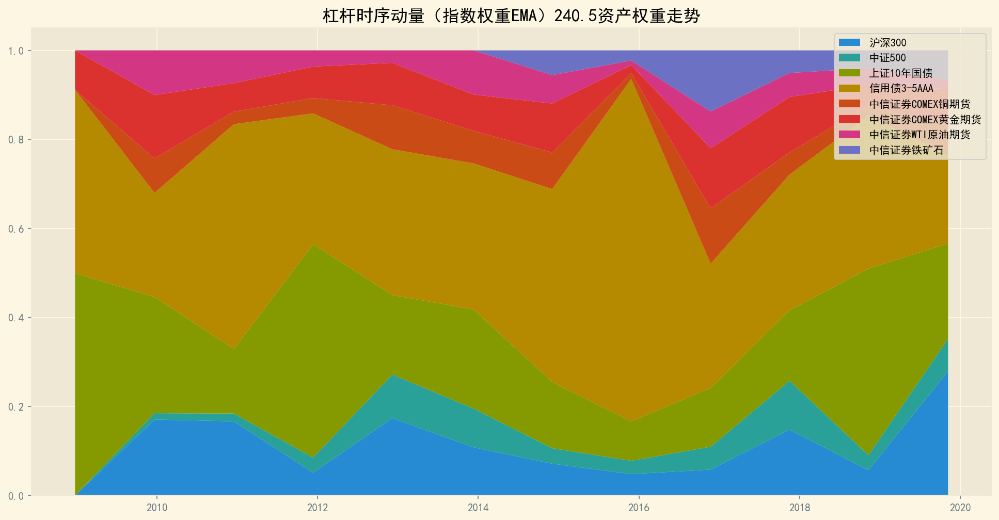

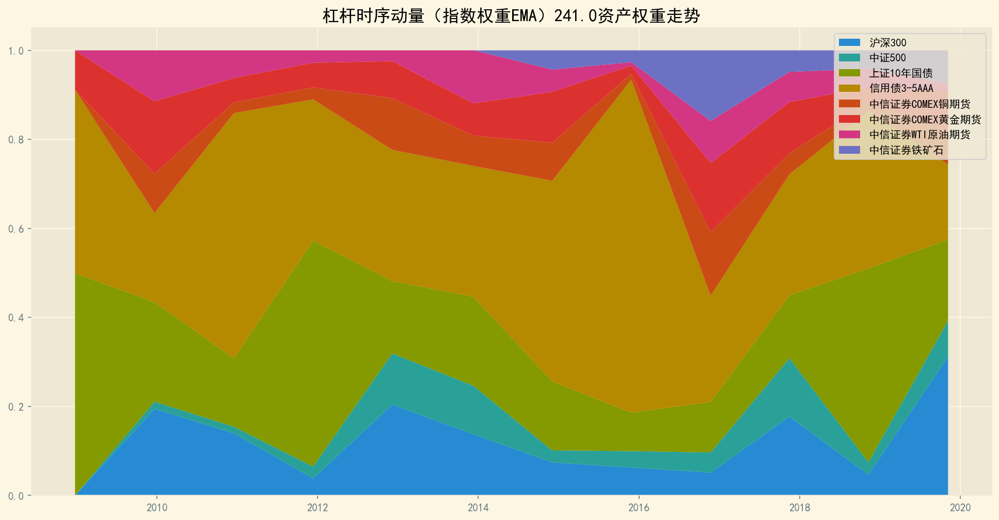

In [63]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':True, 
           'reverseX':False, 'reverseT':False, 
           'turnover':False, 
           'copperGold':False, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='ema', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆时序动量（指数权重EMA）'+str(t+u))

        leverNetValueDF_momentumT.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_momentumT.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_momentumT.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [64]:
# 汇总
leverSummaryDF_momentumT = pd.DataFrame(index=multiIDX)

leverSummaryDF_momentumT["年平均收益率"] = leverDailyPnlDF_momentumT.mean(axis=0).values * 250
leverSummaryDF_momentumT["年平均标准差"] = leverDailyPnlDF_momentumT.std(axis=0).values * np.sqrt(250)
leverSummaryDF_momentumT["无基准夏普比率"] = leverSummaryDF_momentumT["年平均收益率"] / leverSummaryDF_momentumT["年平均标准差"]
leverSummaryDF_momentumT["最大回撤"] = leverDrawDownDF_momentumT.min(axis=0).values

leverSummaryDF_momentumT

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.077583  0.074393  1.042878 -0.139645
     1.0   0.078220  0.075680  1.033559 -0.135430
60   0.5   0.083394  0.073977  1.127291 -0.142478
     1.0   0.082321  0.075199  1.094704 -0.150674
120  0.5   0.114486  0.075646  1.513458 -0.149052
     1.0   0.111489  0.077013  1.447663 -0.163388
180  0.5   0.098983  0.076750  1.289675 -0.117666
     1.0   0.103924  0.079403  1.308826 -0.112955
240  0.5   0.062103  0.070383  0.882353 -0.122800
     1.0   0.065065  0.074846  0.869317 -0.125381

### 各投资组合净值曲线

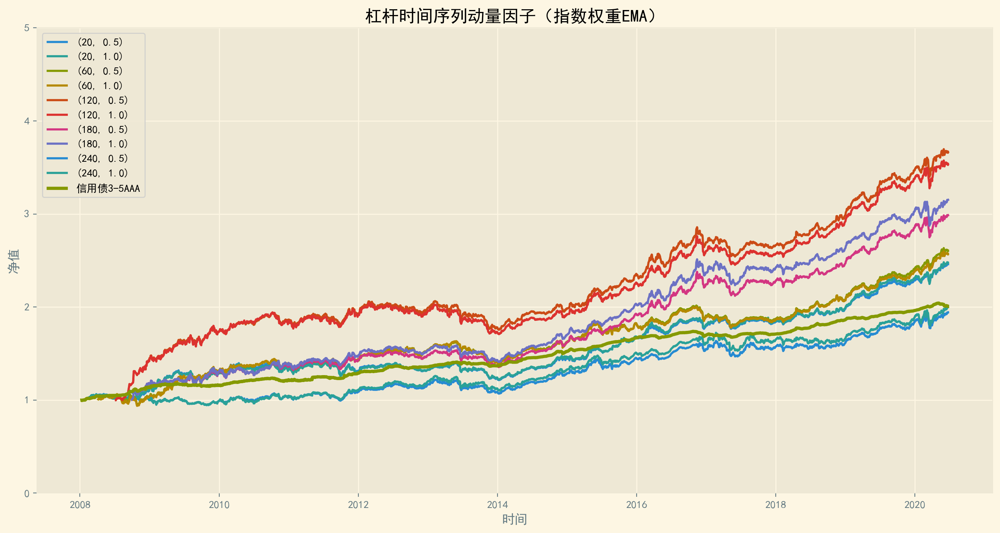

In [65]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_momentumT.columns:
    plt.plot(leverNetValueDF_momentumT.index, leverNetValueDF_momentumT[col], label=col)

plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')
    
plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆时间序列动量因子（指数权重EMA）')
plt.show()

## 反转因子（横向比较）

### 程序运行

In [26]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_reverseX = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_reverseX = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_reverseX = pd.DataFrame(index=Returns.index, columns=multiIDX)

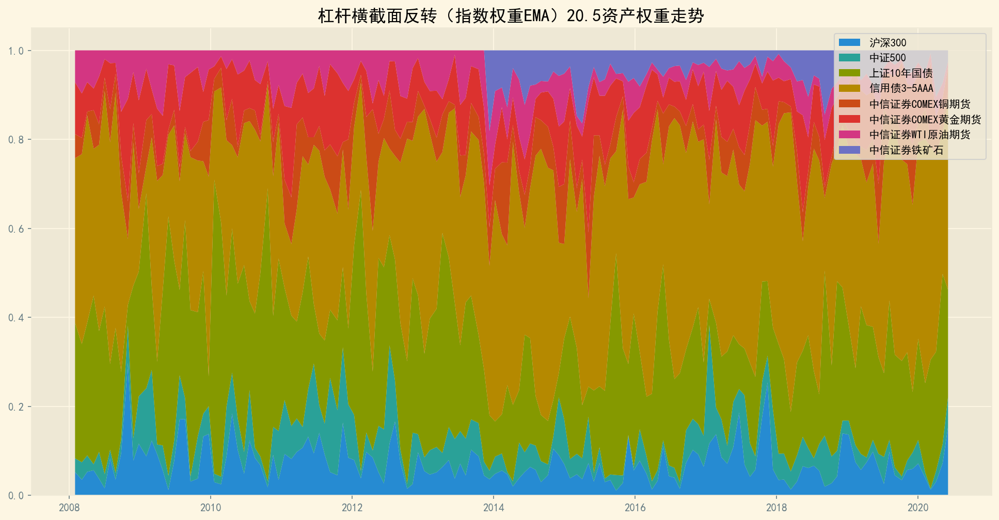

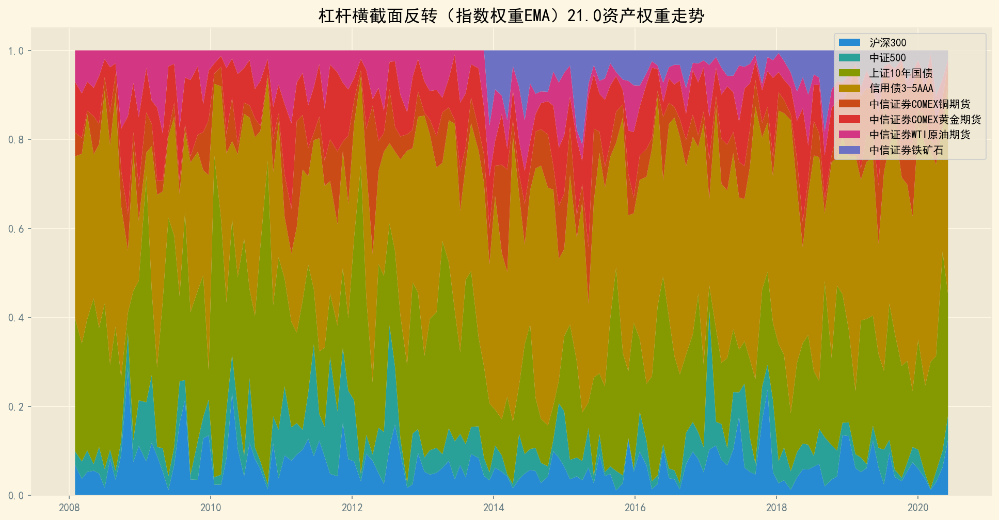

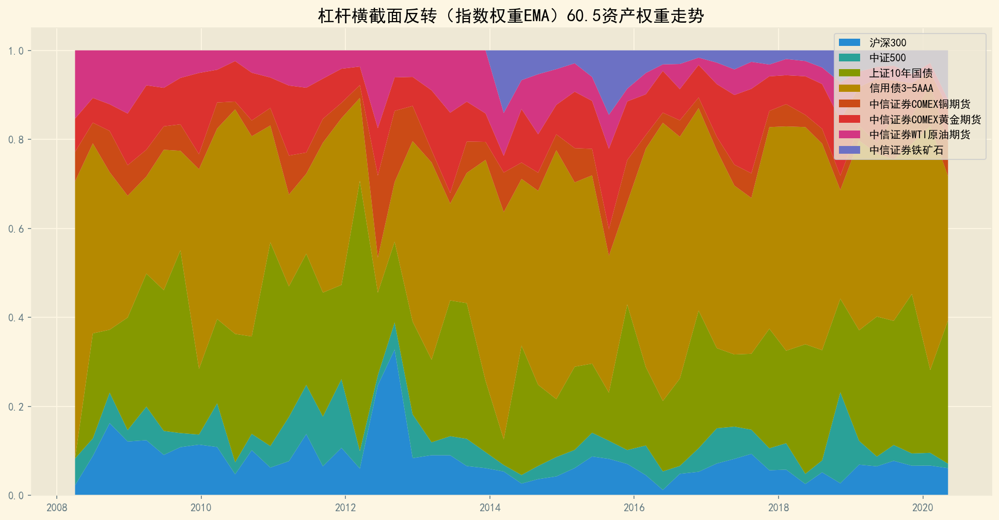

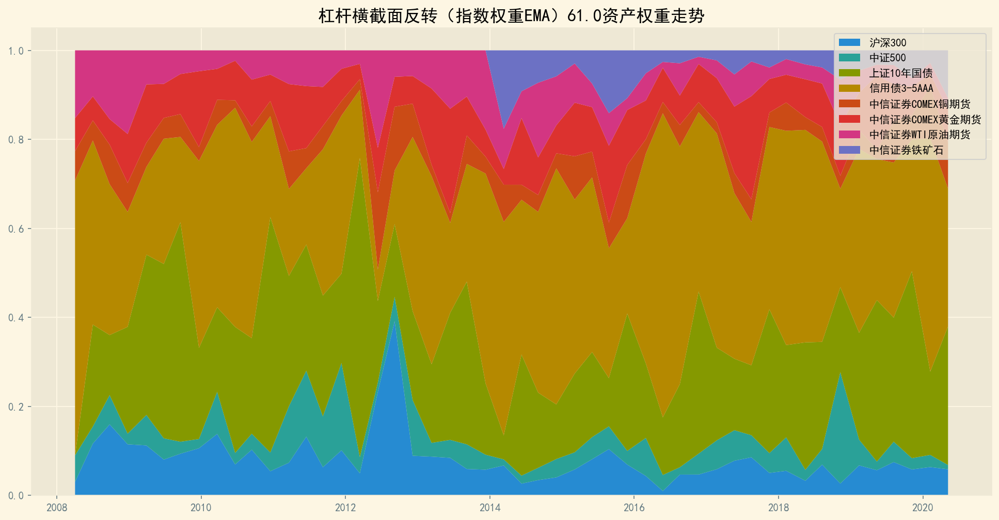

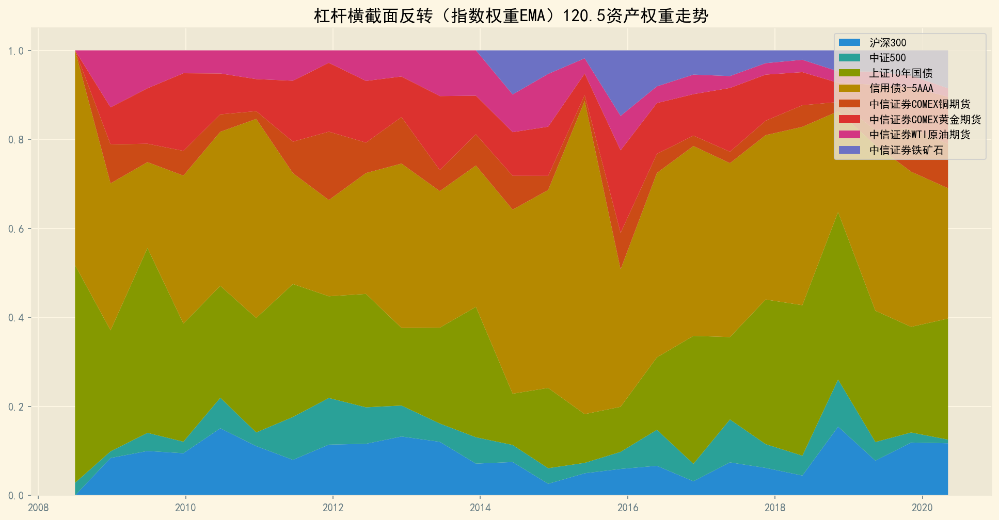

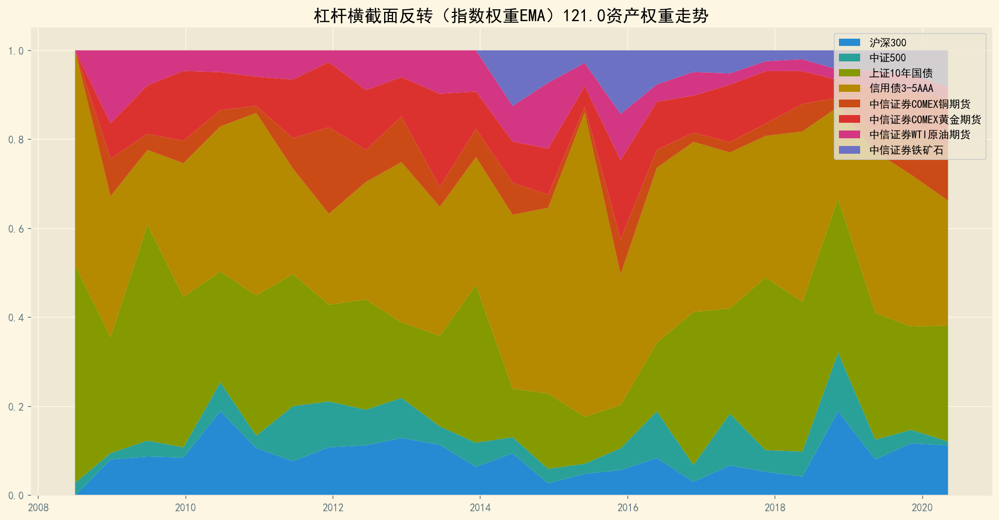

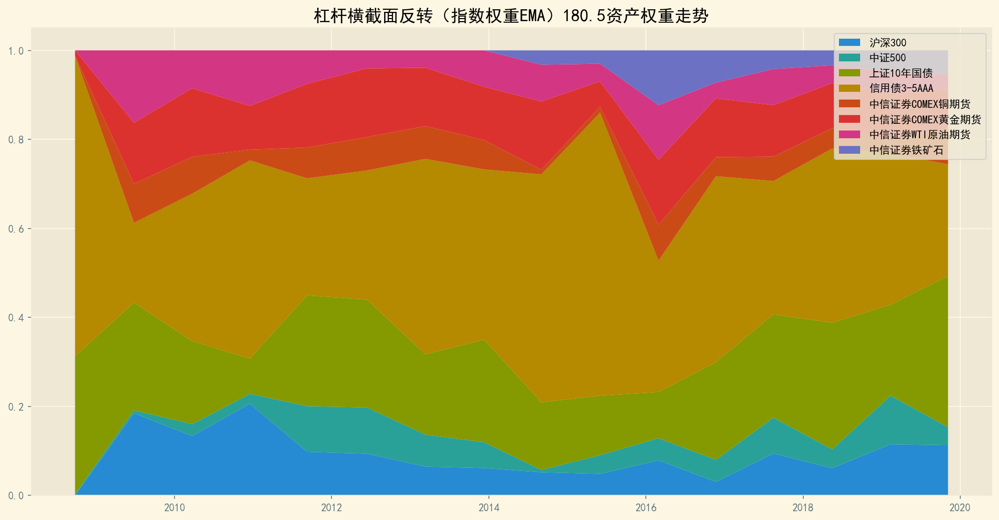

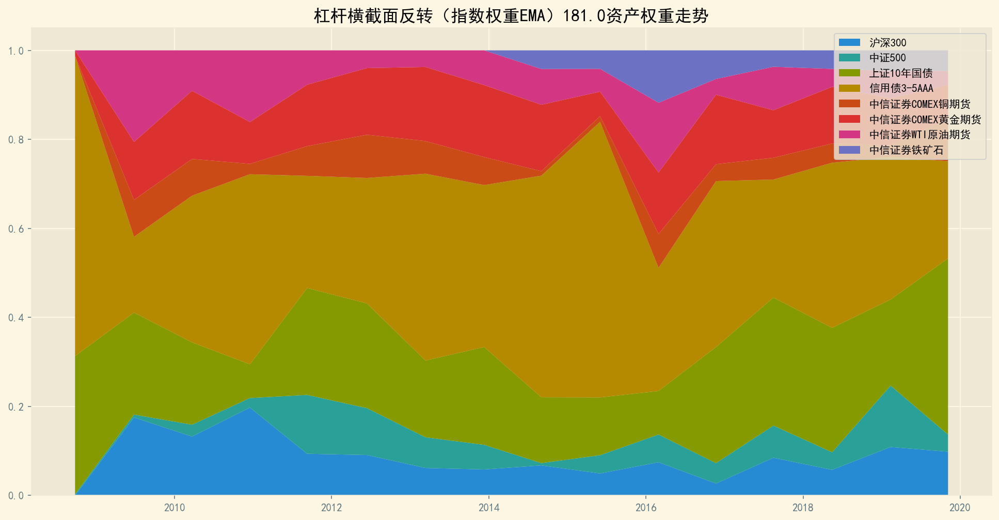

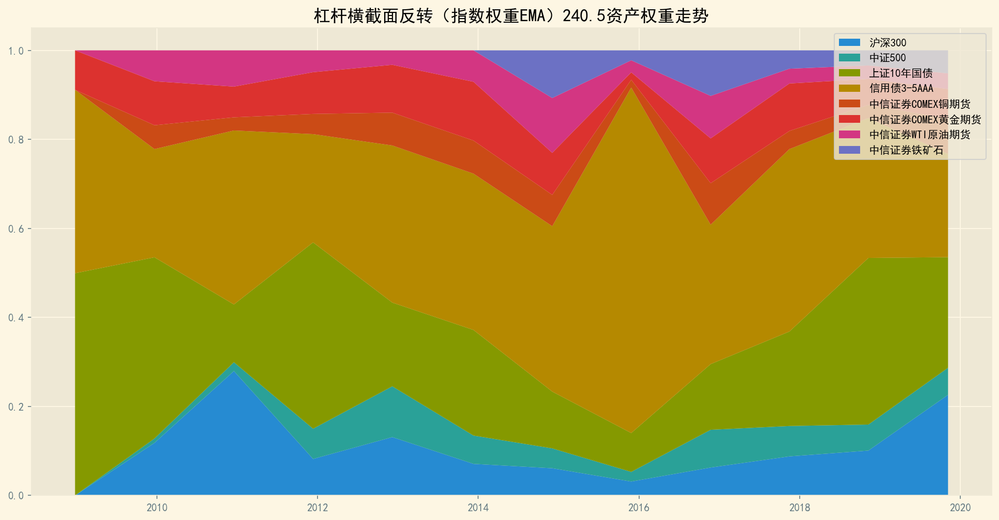

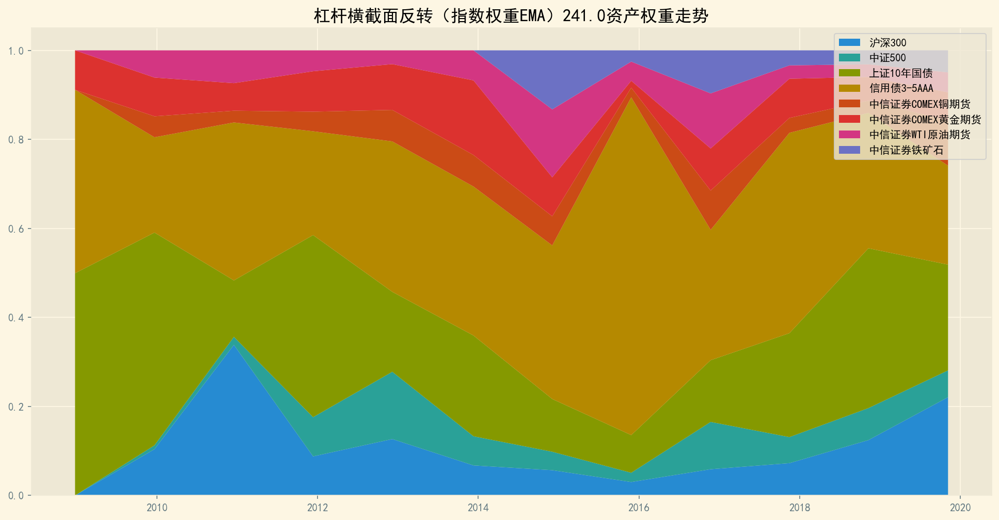

In [27]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
           'reverseX':True, 'reverseT':False, 
           'turnover':False,
           'copperGold':False, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='ema', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆横截面反转（指数权重EMA）'+str(t+u))

        leverNetValueDF_reverseX.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_reverseX.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_reverseX.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [28]:
# 汇总
leverSummaryDF_reverseX = pd.DataFrame(index=multiIDX)

leverSummaryDF_reverseX["年平均收益率"] = leverDailyPnlDF_reverseX.mean(axis=0).values * 250
leverSummaryDF_reverseX["年平均标准差"] = leverDailyPnlDF_reverseX.std(axis=0).values * np.sqrt(250)
leverSummaryDF_reverseX["无基准夏普比率"] = leverSummaryDF_reverseX["年平均收益率"] / leverSummaryDF_reverseX["年平均标准差"]
leverSummaryDF_reverseX["最大回撤"] = leverDrawDownDF_reverseX.min(axis=0).values

leverSummaryDF_reverseX

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.071433  0.076914  0.928729 -0.168751
     1.0   0.066701  0.080666  0.826882 -0.179850
60   0.5   0.077133  0.077499  0.995269 -0.136928
     1.0   0.071637  0.081498  0.879007 -0.148079
120  0.5   0.115353  0.078298  1.473255 -0.140012
     1.0   0.112407  0.081483  1.379522 -0.140201
180  0.5   0.090574  0.076941  1.177196 -0.130525
     1.0   0.089413  0.079607  1.123175 -0.137673
240  0.5   0.054336  0.068084  0.798069 -0.115346
     1.0   0.051489  0.070733  0.727940 -0.128111

### 各投资组合净值曲线

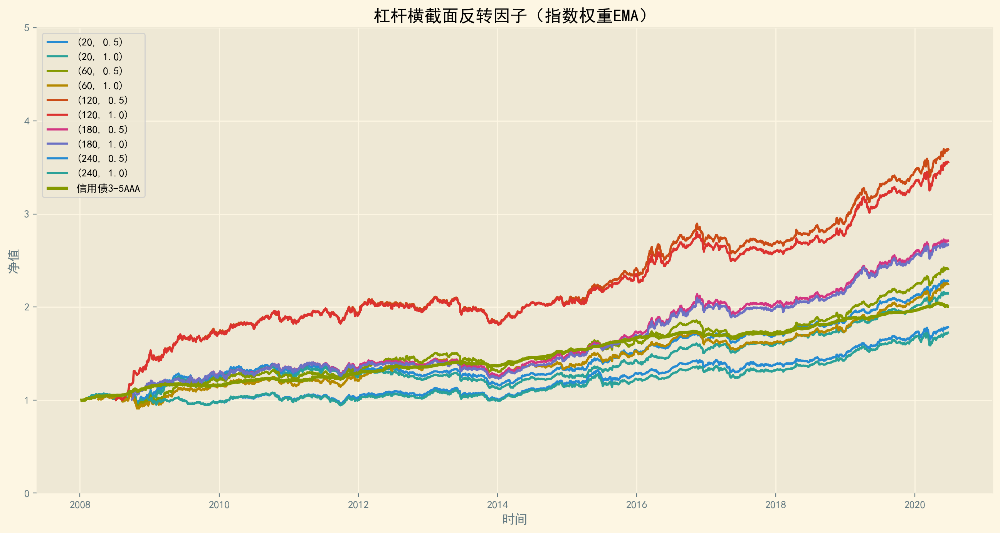

In [29]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_reverseX.columns:
    plt.plot(leverNetValueDF_reverseX.index, leverNetValueDF_reverseX[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆横截面反转因子（指数权重EMA）')
plt.show()

## 反转因子 （时序比较）

### 程序运行

In [71]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_reverseT = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_reverseT = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_reverseT = pd.DataFrame(index=Returns.index, columns=multiIDX)

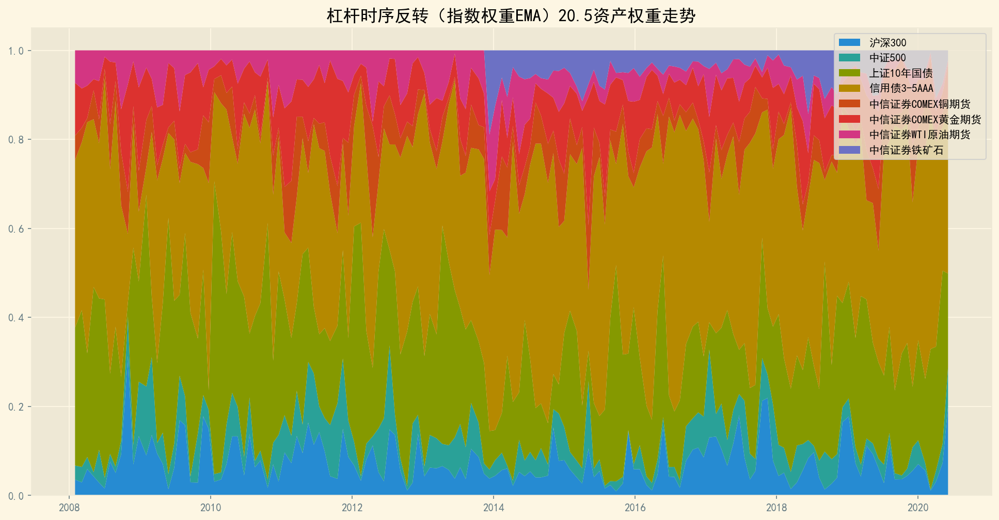

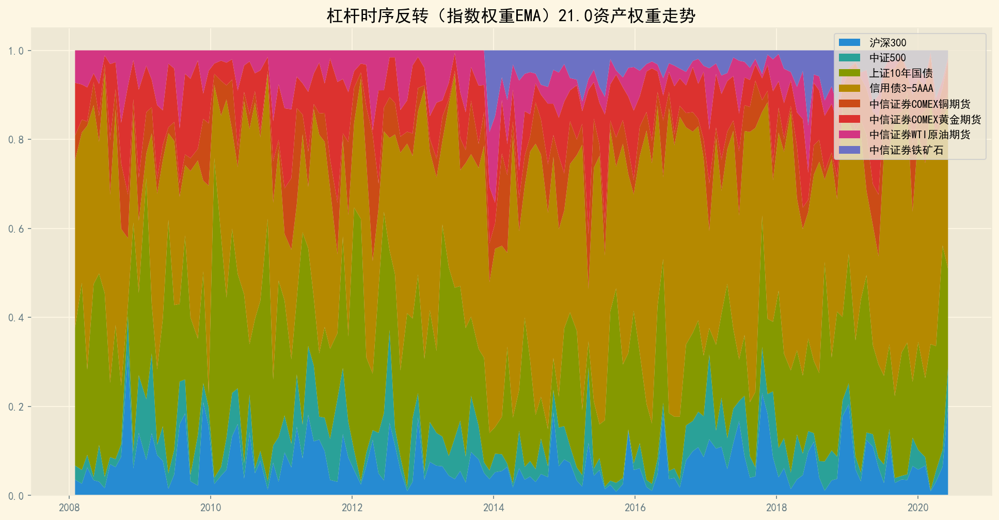

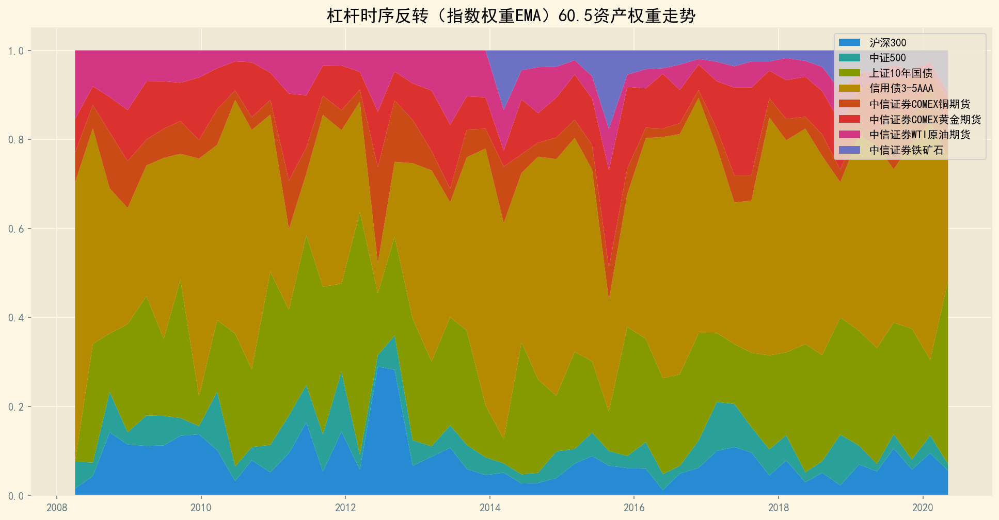

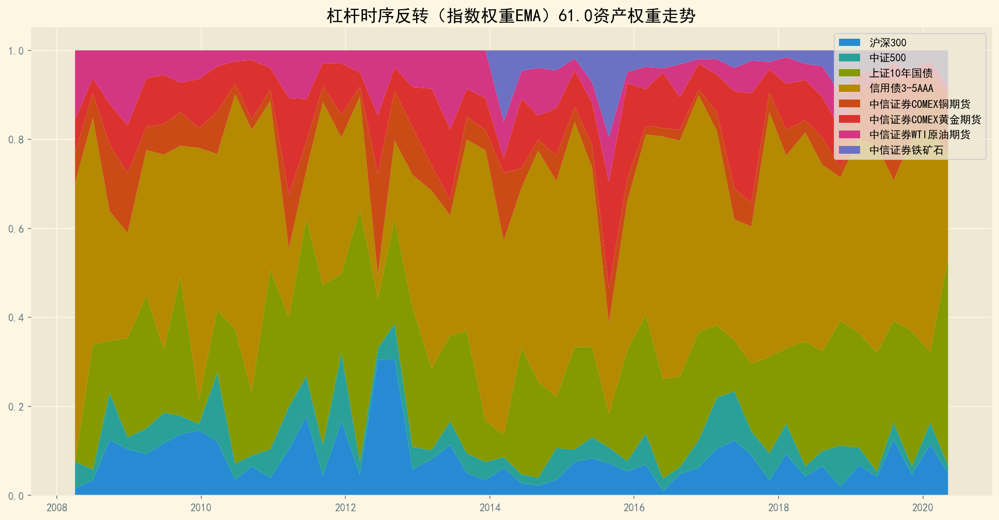

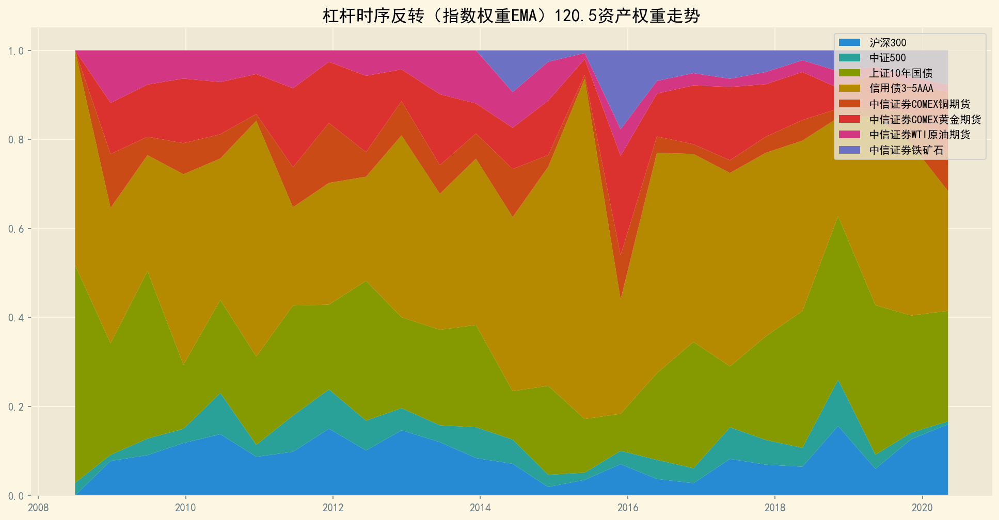

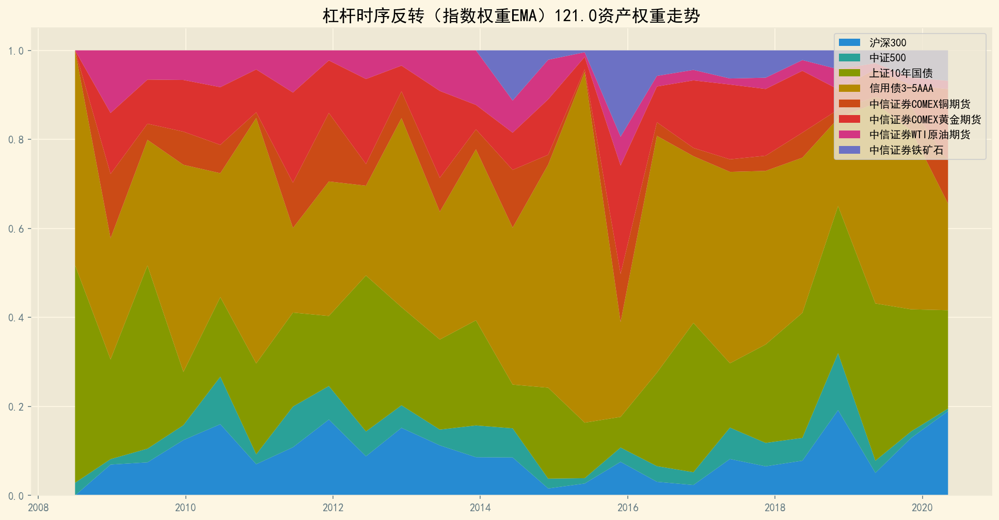

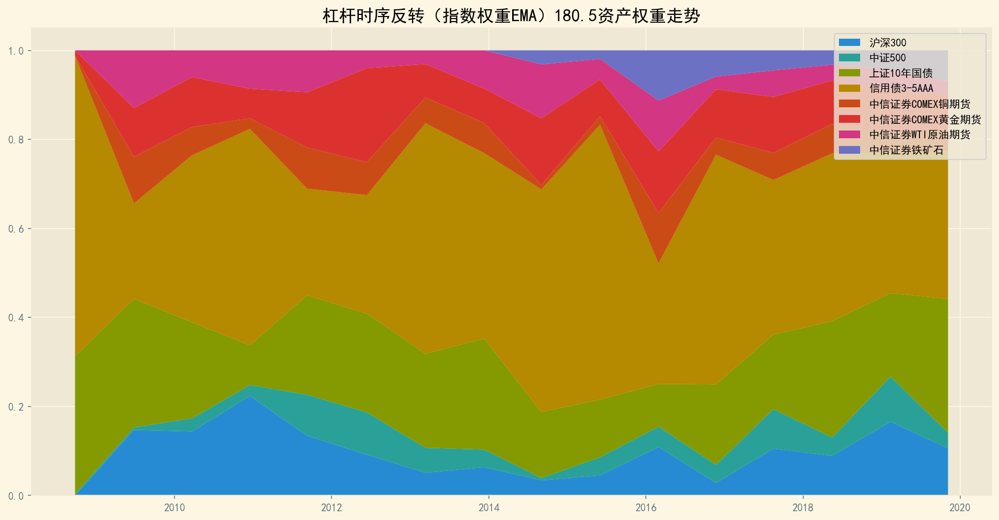

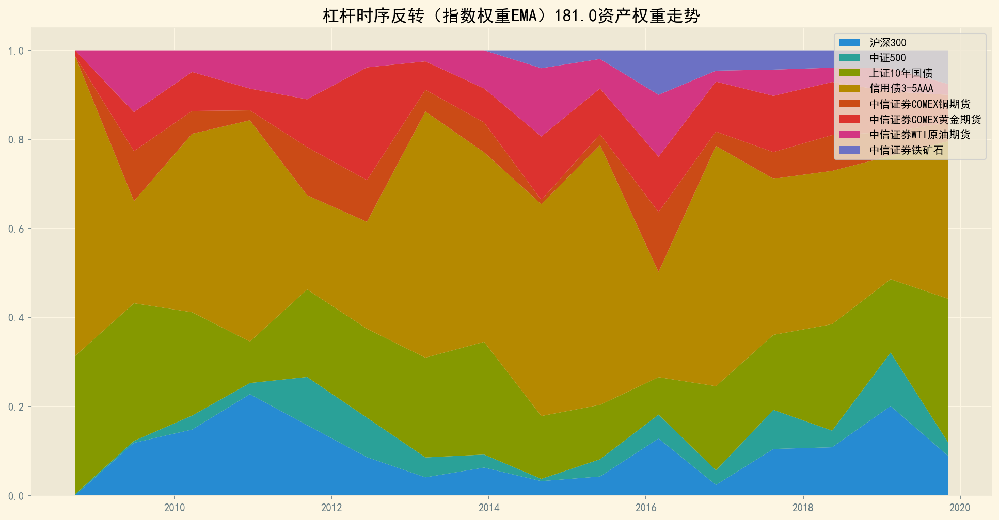

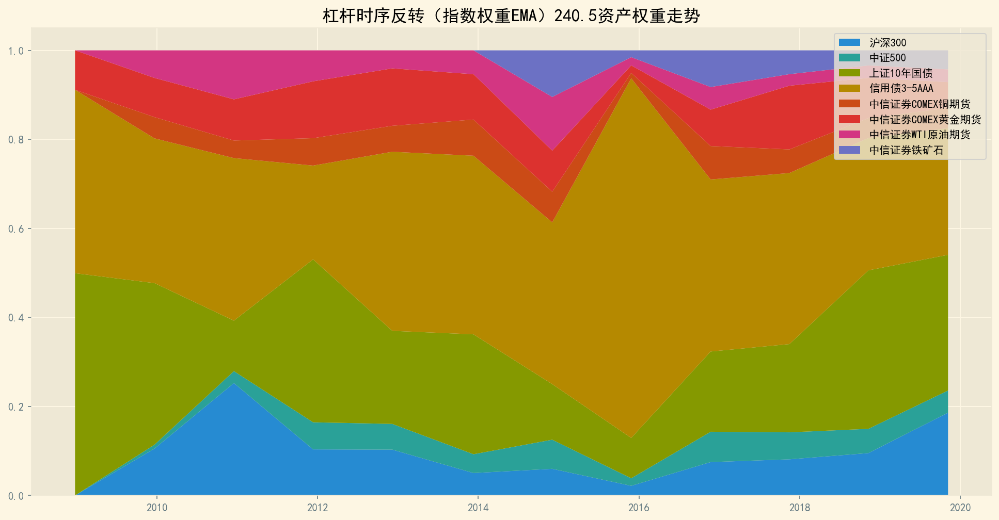

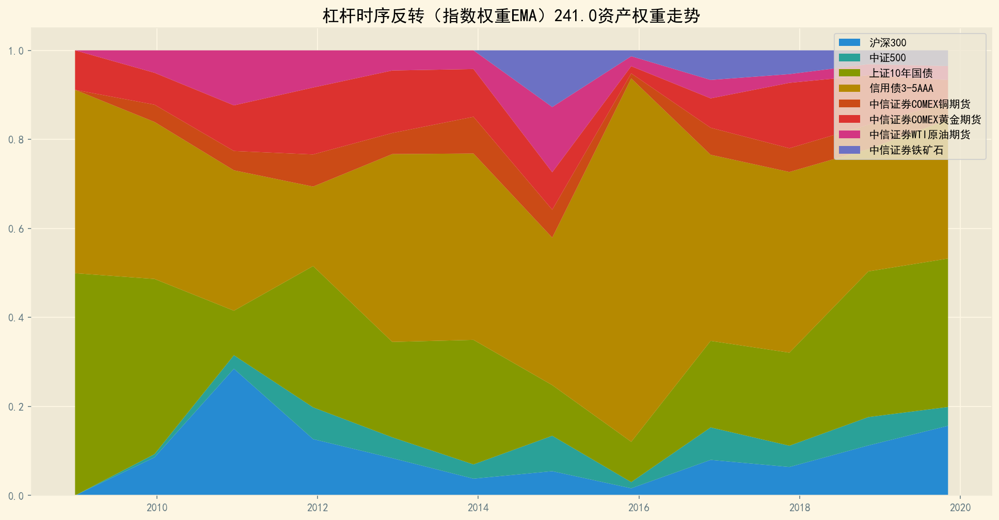

In [72]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
           'reverseX':False, 'reverseT':True, 
           'turnover':False,
           'copperGold':False, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='ema', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆时序反转（指数权重EMA）'+str(t+u))

        leverNetValueDF_reverseT.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_reverseT.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_reverseT.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [73]:
# 汇总
leverSummaryDF_reverseT = pd.DataFrame(index=multiIDX)

leverSummaryDF_reverseT["年平均收益率"] = leverDailyPnlDF_reverseT.mean(axis=0).values * 250
leverSummaryDF_reverseT["年平均标准差"] = leverDailyPnlDF_reverseT.std(axis=0).values * np.sqrt(250)
leverSummaryDF_reverseT["无基准夏普比率"] = leverSummaryDF_reverseT["年平均收益率"] / leverSummaryDF_reverseT["年平均标准差"]
leverSummaryDF_reverseT["最大回撤"] = leverDrawDownDF_reverseT.min(axis=0).values

leverSummaryDF_reverseT

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.074133  0.076370  0.970702 -0.170253
     1.0   0.072317  0.079150  0.913676 -0.178286
60   0.5   0.081095  0.078346  1.035093 -0.148143
     1.0   0.078463  0.082831  0.947258 -0.169970
120  0.5   0.122507  0.079489  1.541170 -0.136299
     1.0   0.125159  0.083500  1.498919 -0.137296
180  0.5   0.084301  0.075543  1.115933 -0.131054
     1.0   0.078434  0.077630  1.010362 -0.148515
240  0.5   0.051629  0.066139  0.780614 -0.124043
     1.0   0.047408  0.067976  0.697424 -0.145823

### 各投资组合净值曲线

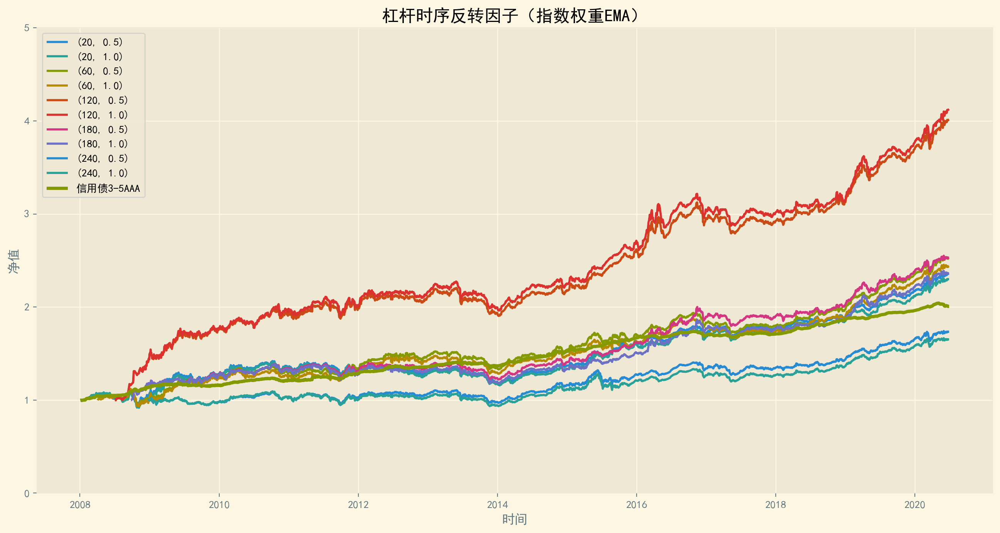

In [74]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_reverseT.columns:
    plt.plot(leverNetValueDF_reverseT.index, leverNetValueDF_reverseT[col], label=col)

plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')
    
plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆时序反转因子（指数权重EMA）')
plt.show()

## 情绪因子（股指换手率）

### 程序运行

In [75]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_turnover = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_turnover = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_turnover = pd.DataFrame(index=Returns.index, columns=multiIDX)

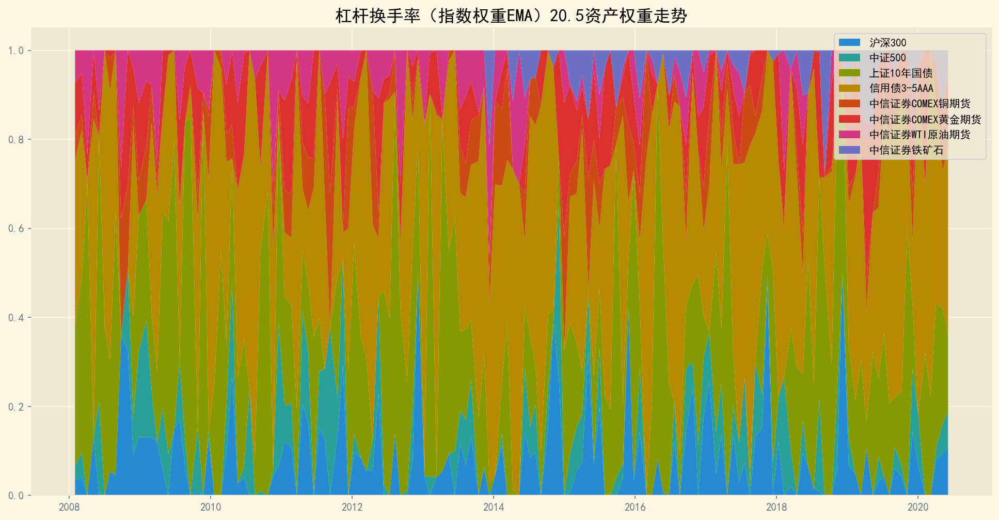

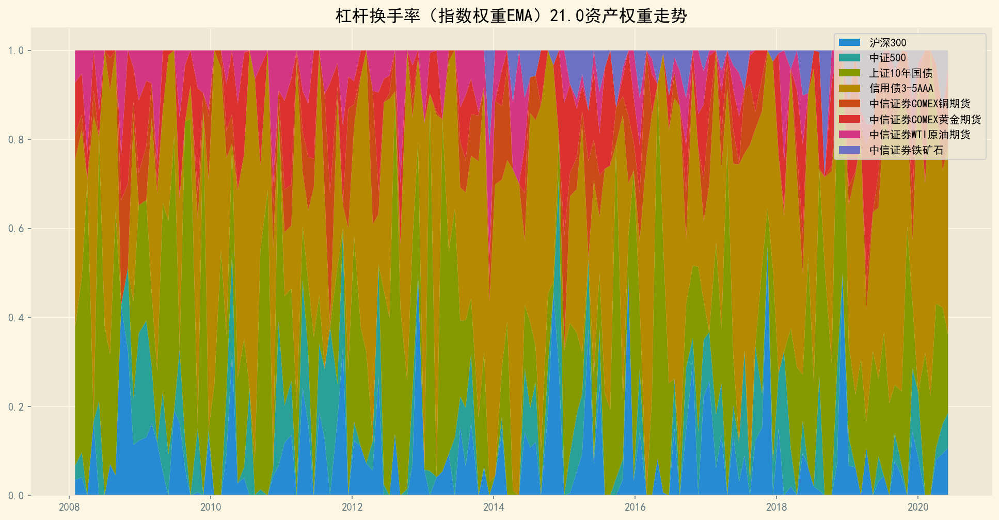

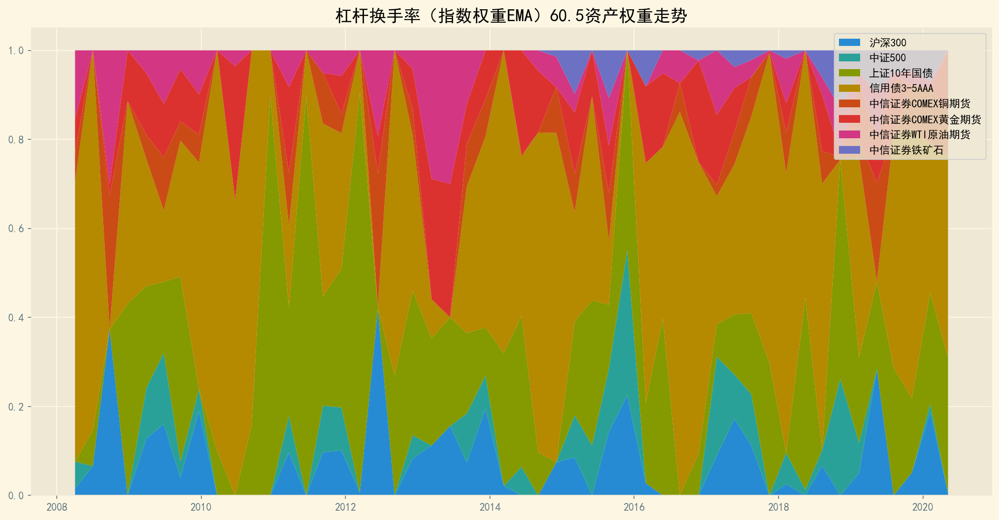

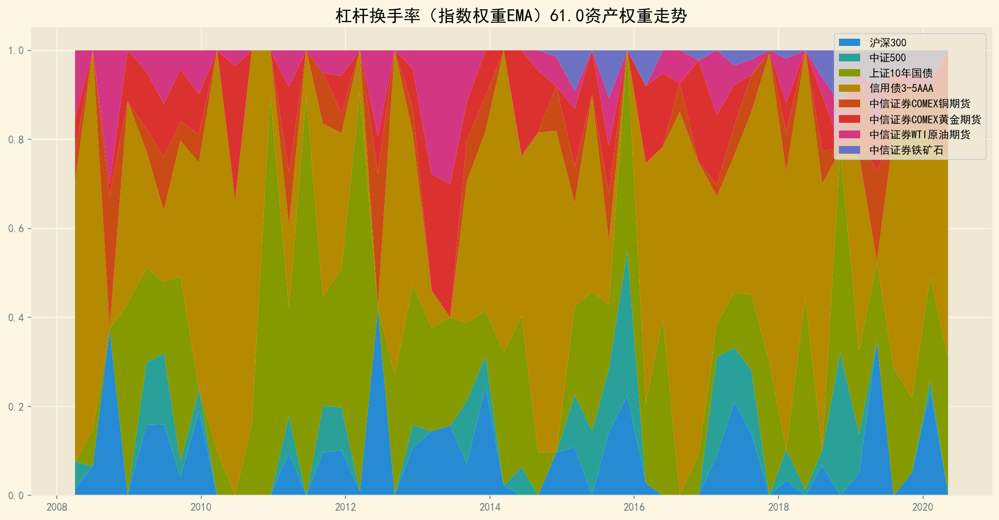

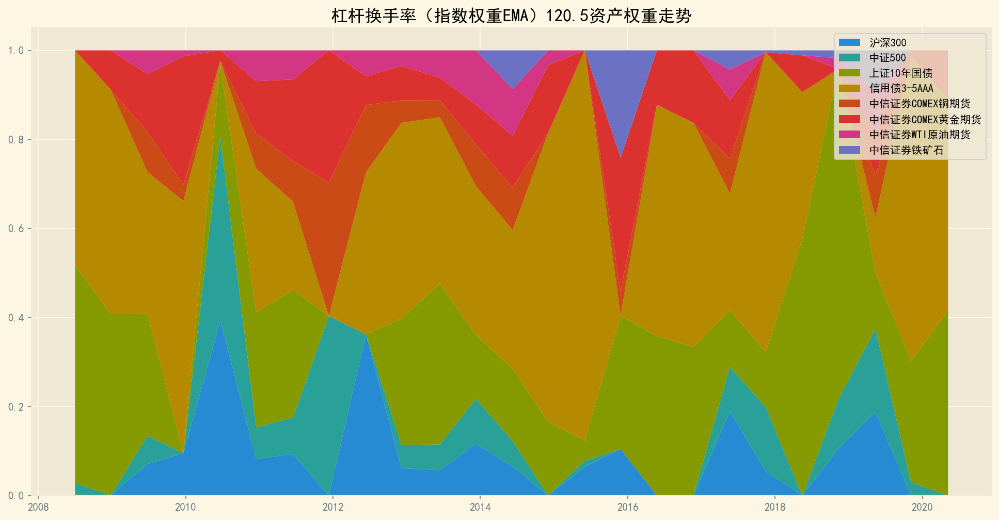

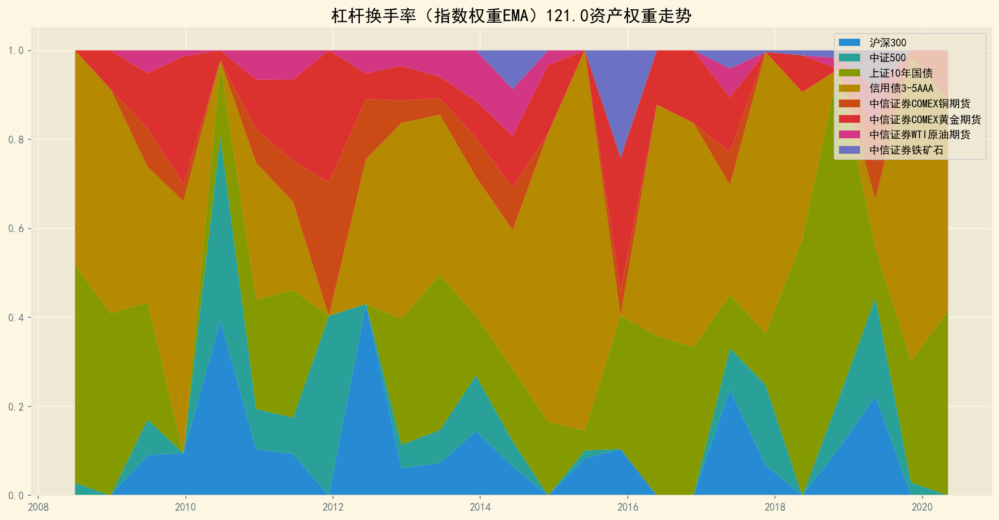

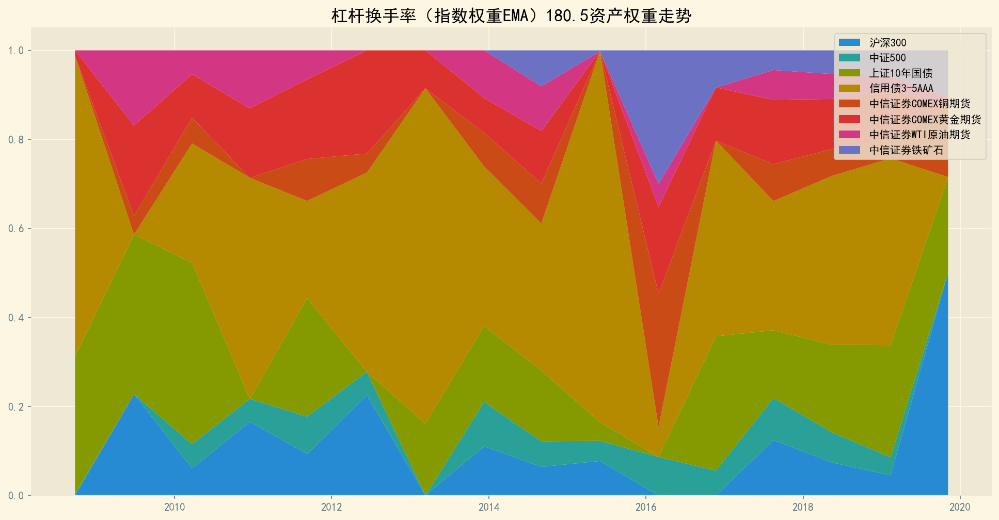

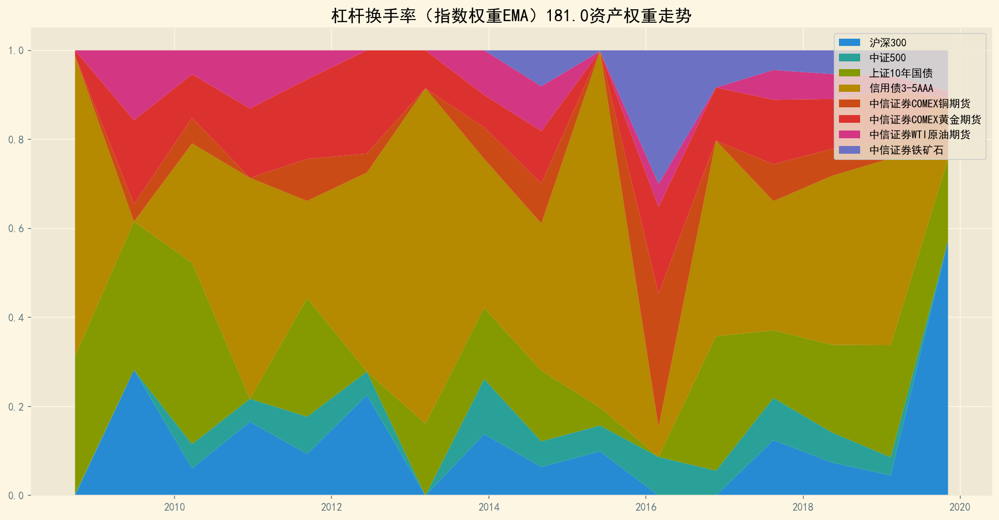

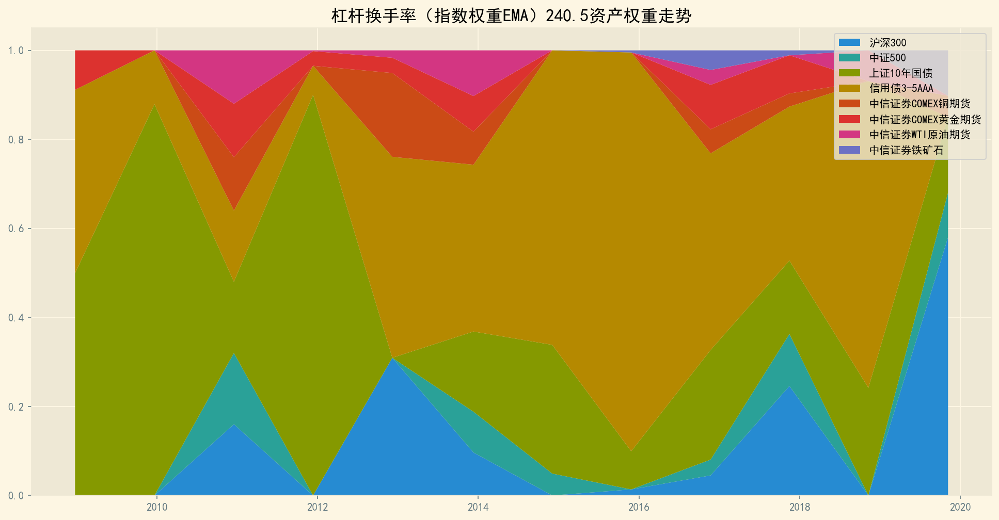

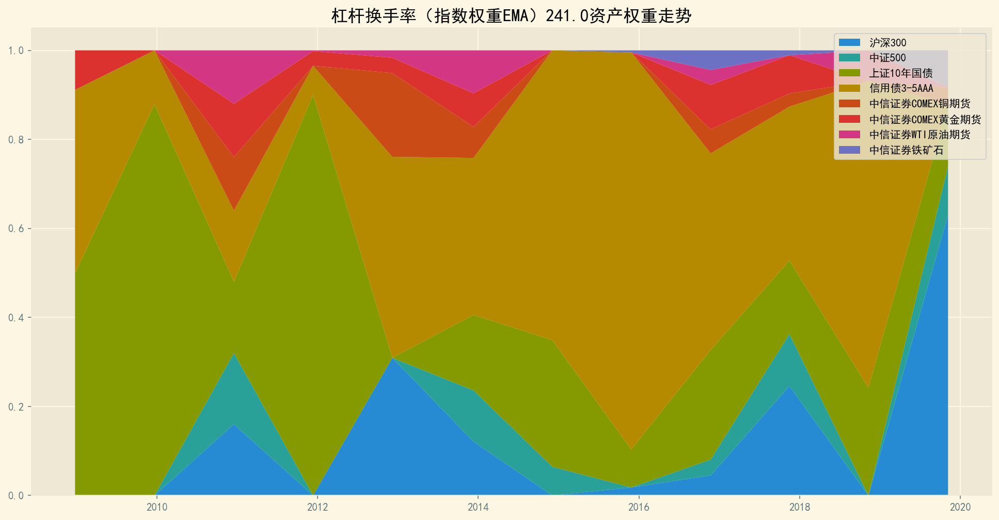

In [76]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
           'reverseX':False, 'reverseT':False, 
           'turnover':True, 
           'copperGold':False, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='plain', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆换手率（指数权重EMA）'+str(t+u))

        leverNetValueDF_turnover.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_turnover.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_turnover.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [77]:
# 汇总
leverSummaryDF_turnover = pd.DataFrame(index=multiIDX)

leverSummaryDF_turnover["年平均收益率"] = leverDailyPnlDF_turnover.mean(axis=0).values * 250
leverSummaryDF_turnover["年平均标准差"] = leverDailyPnlDF_turnover.std(axis=0).values * np.sqrt(250)
leverSummaryDF_turnover["无基准夏普比率"] = leverSummaryDF_turnover["年平均收益率"] / leverSummaryDF_turnover["年平均标准差"]
leverSummaryDF_turnover["最大回撤"] = leverDrawDownDF_turnover.min(axis=0).values

leverSummaryDF_turnover

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.055030  0.106420  0.517100 -0.336567
     1.0   0.057074  0.107588  0.530489 -0.328755
60   0.5   0.035643  0.113390  0.314338 -0.466683
     1.0   0.037482  0.114455  0.327485 -0.466683
120  0.5   0.106166  0.091828  1.156137 -0.221079
     1.0   0.104288  0.093207  1.118888 -0.228001
180  0.5   0.097196  0.089586  1.084945 -0.150278
     1.0   0.094748  0.091543  1.035007 -0.154202
240  0.5   0.052719  0.078213  0.674049 -0.212285
     1.0   0.052810  0.079819  0.661629 -0.212285

### 各投资组合净值曲线

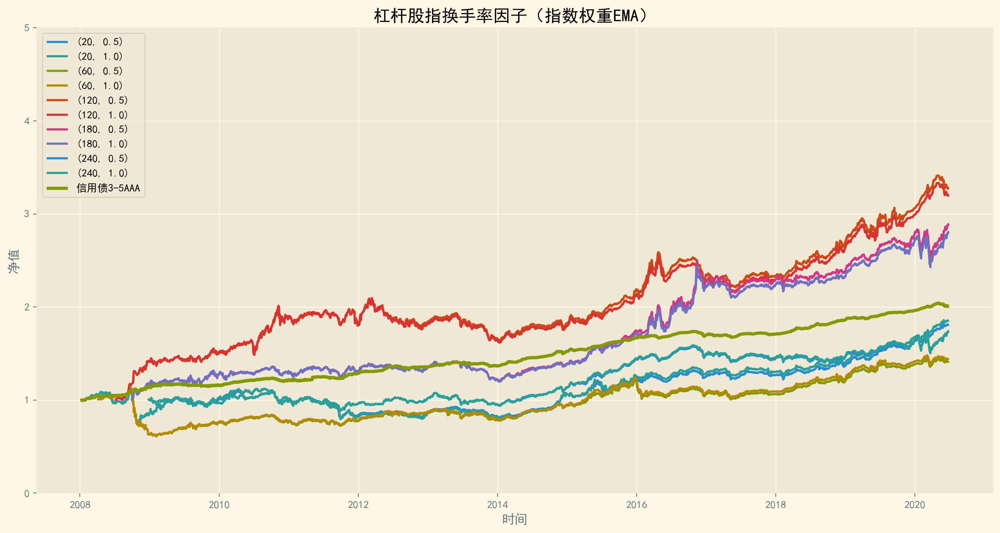

In [78]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_turnover.columns:
    plt.plot(leverNetValueDF_turnover.index, leverNetValueDF_turnover[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆股指换手率因子（指数权重EMA）')
plt.show()

## 铜金价格比因子（十年国债反转）

### 程序运行

In [79]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_copperGold = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_copperGold = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_copperGold = pd.DataFrame(index=Returns.index, columns=multiIDX)

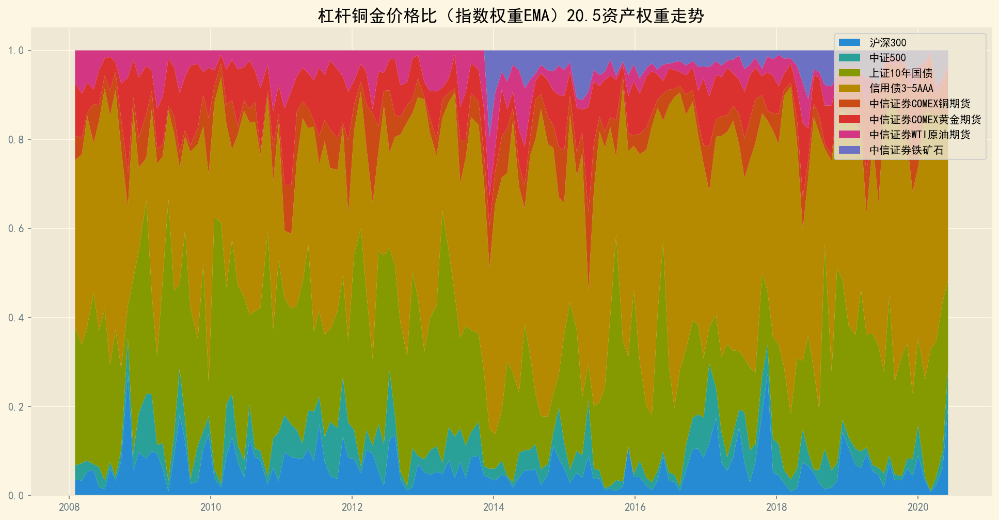

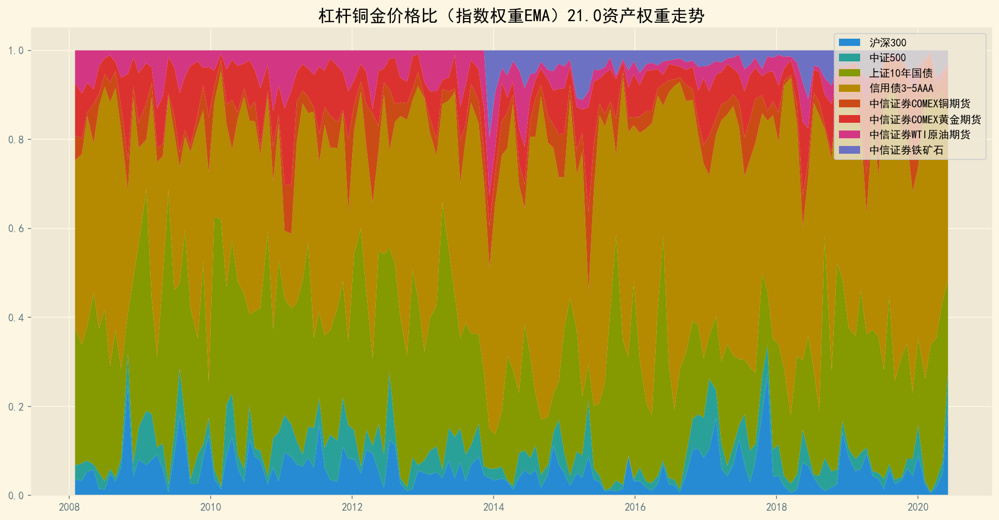

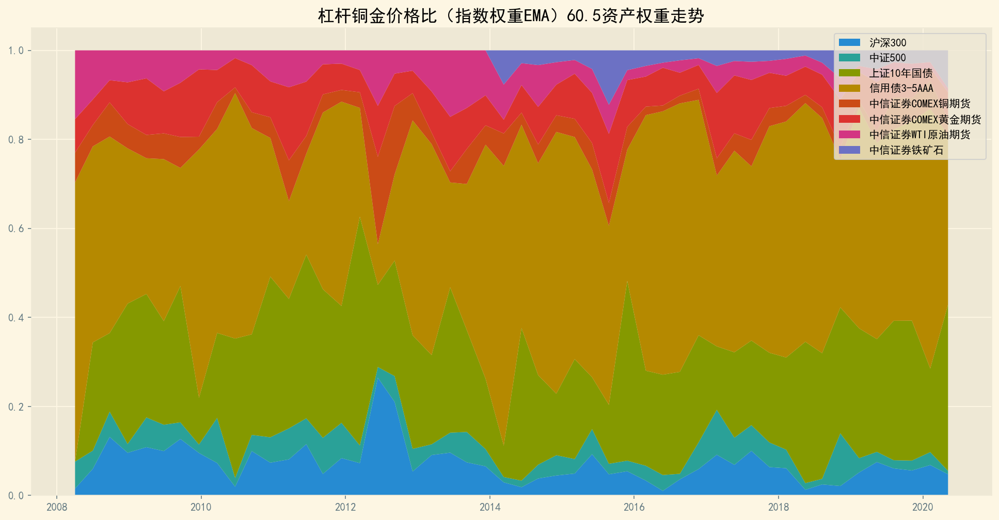

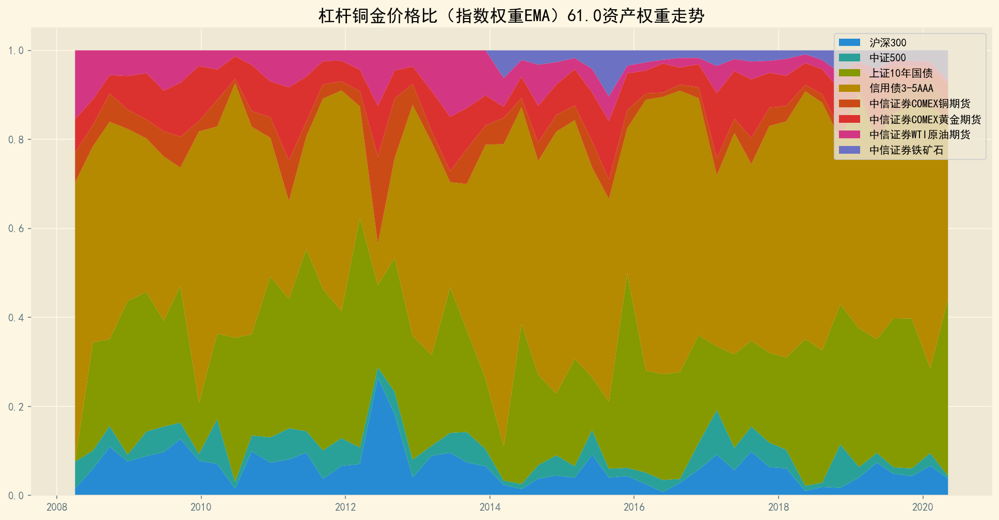

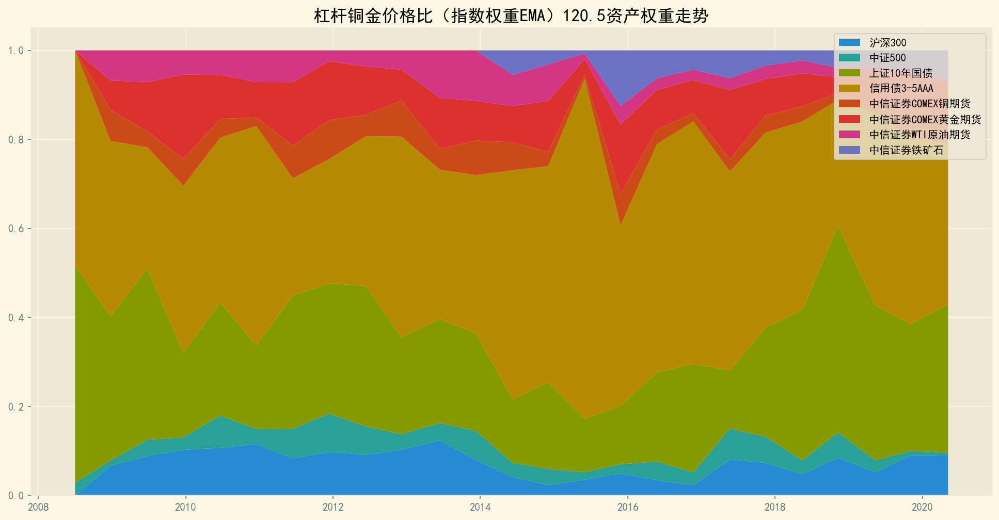

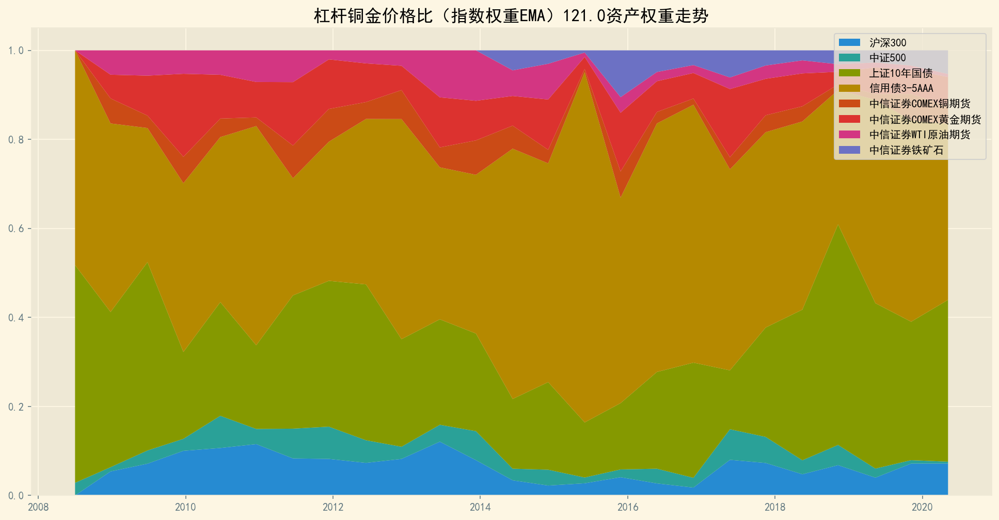

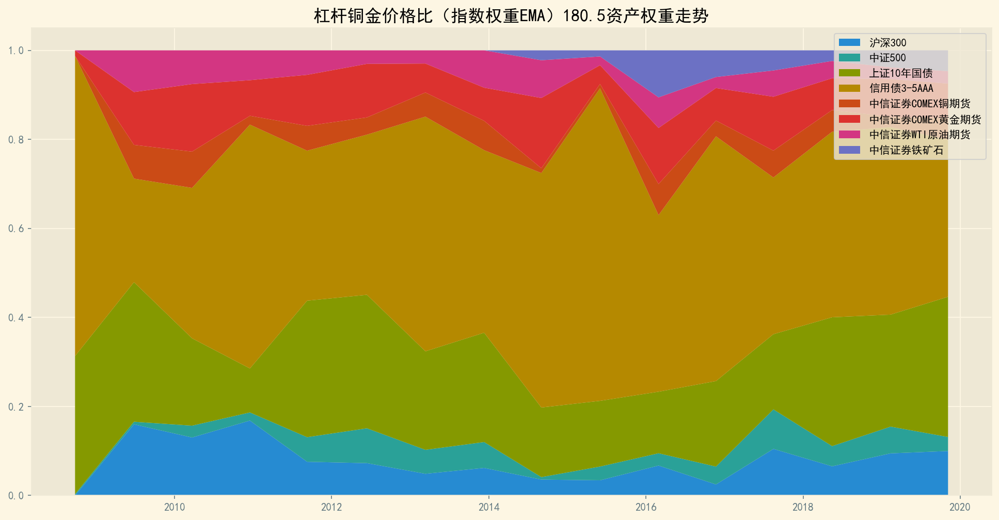

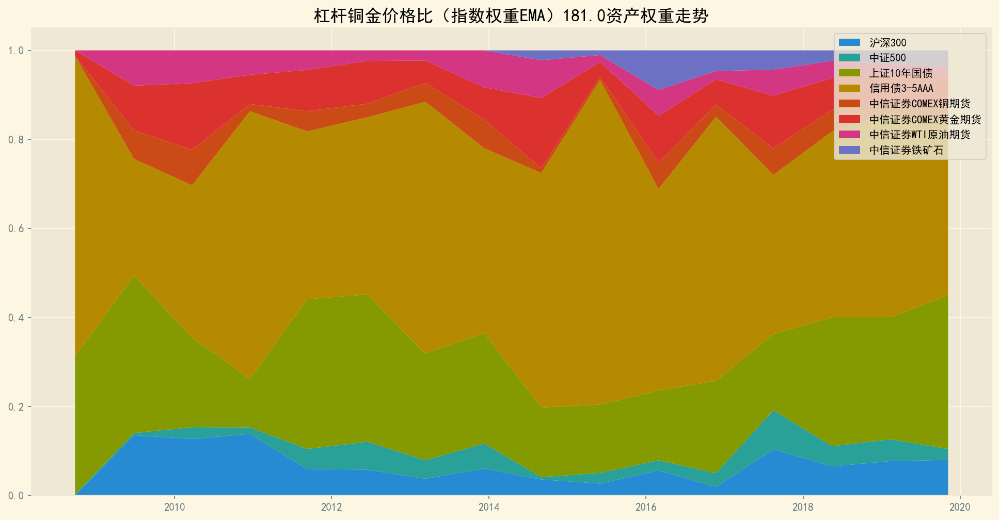

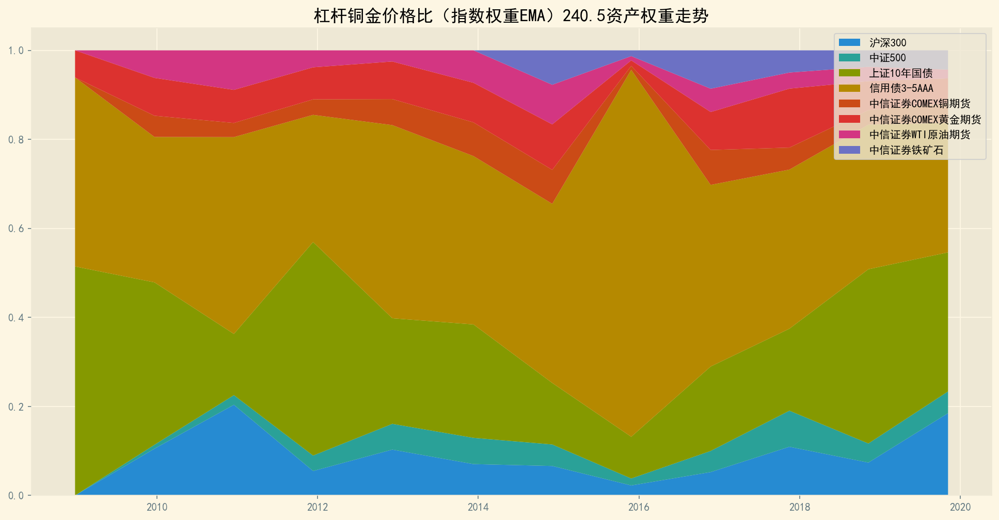

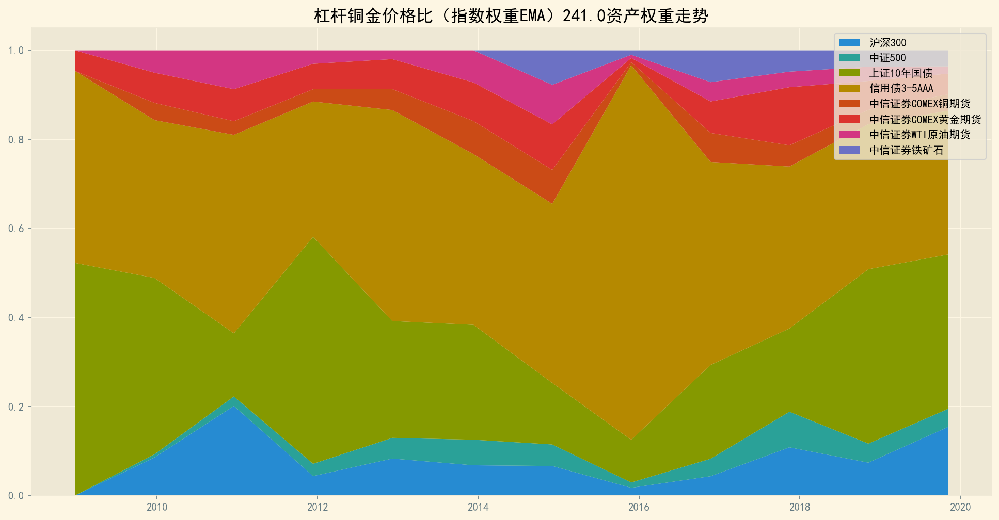

In [80]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
            'reverseX':False, 'reverseT':False,
            'turnover':False, 
            'copperGold':True, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='ema', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆铜金价格比（指数权重EMA）'+str(t+u))

        leverNetValueDF_copperGold.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_copperGold.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_copperGold.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [81]:
# 汇总
leverSummaryDF_copperGold = pd.DataFrame(index=multiIDX)

leverSummaryDF_copperGold["年平均收益率"] = leverDailyPnlDF_copperGold.mean(axis=0).values * 250
leverSummaryDF_copperGold["年平均标准差"] = leverDailyPnlDF_copperGold.std(axis=0).values * np.sqrt(250)
leverSummaryDF_copperGold["无基准夏普比率"] = leverSummaryDF_copperGold["年平均收益率"] / leverSummaryDF_copperGold["年平均标准差"]
leverSummaryDF_copperGold["最大回撤"] = leverDrawDownDF_copperGold.min(axis=0).values

leverSummaryDF_copperGold

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.079700  0.069026  1.154646 -0.144253
     1.0   0.081597  0.066541  1.226263 -0.148878
60   0.5   0.083099  0.069244  1.200090 -0.131484
     1.0   0.083076  0.066861  1.242519 -0.131301
120  0.5   0.114105  0.069913  1.632101 -0.131674
     1.0   0.111338  0.066931  1.663476 -0.129987
180  0.5   0.092155  0.068537  1.344605 -0.133301
     1.0   0.092002  0.065449  1.405694 -0.138250
240  0.5   0.054870  0.062508  0.877806 -0.130902
     1.0   0.053475  0.060732  0.880507 -0.136750

### 各投资组合净值曲线

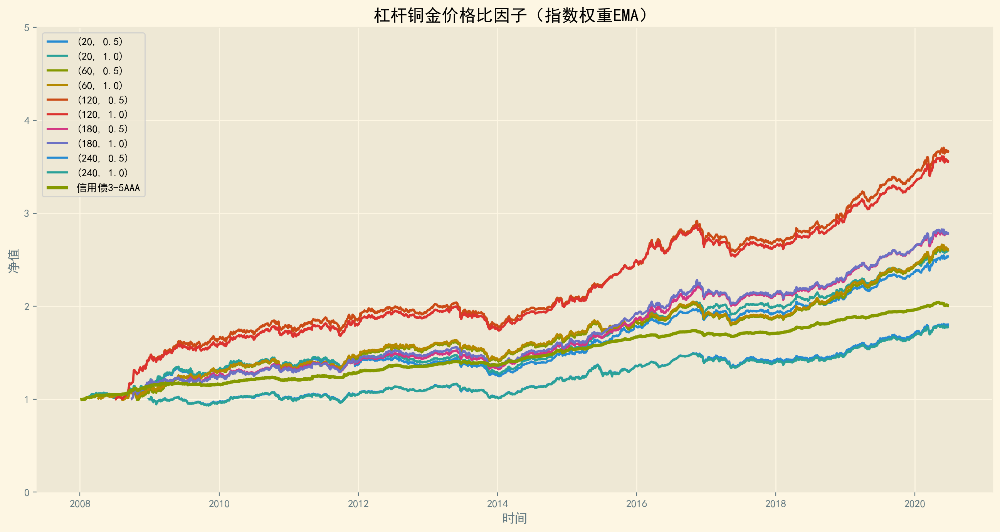

In [88]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_copperGold.columns:
    plt.plot(leverNetValueDF_copperGold.index, leverNetValueDF_copperGold[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆铜金价格比因子（指数权重EMA）')
plt.show()

## 铜油价格比因子（沪深300动量）

### 程序运行

In [22]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_copperGas = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_copperGas = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_copperGas = pd.DataFrame(index=Returns.index, columns=multiIDX)

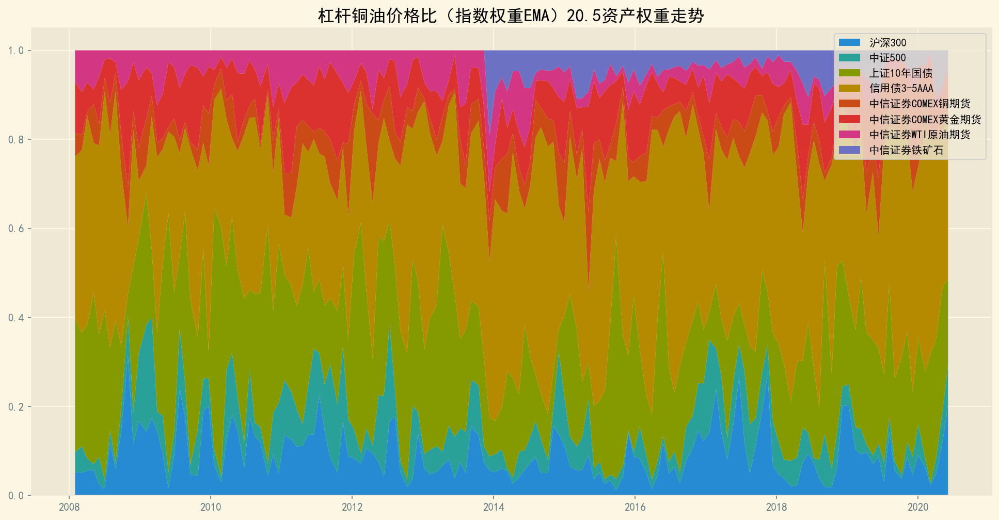

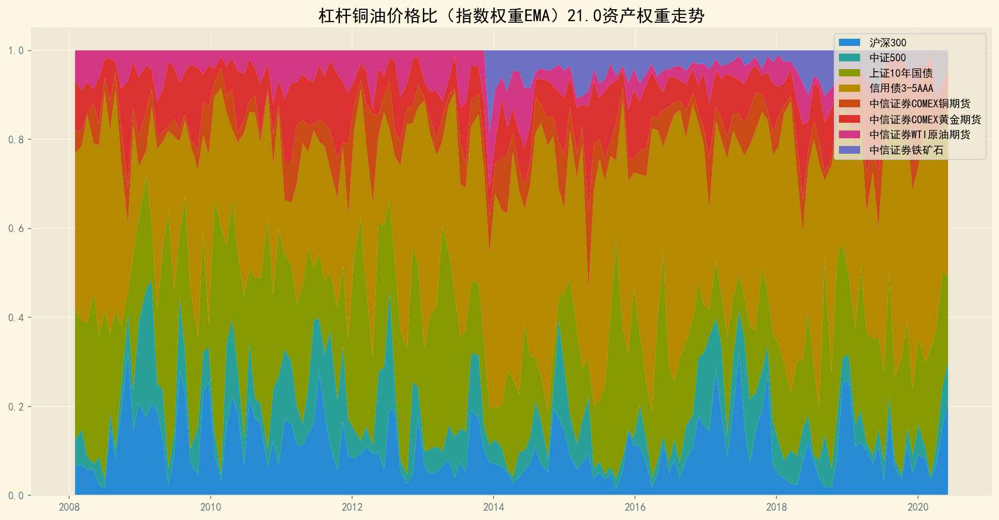

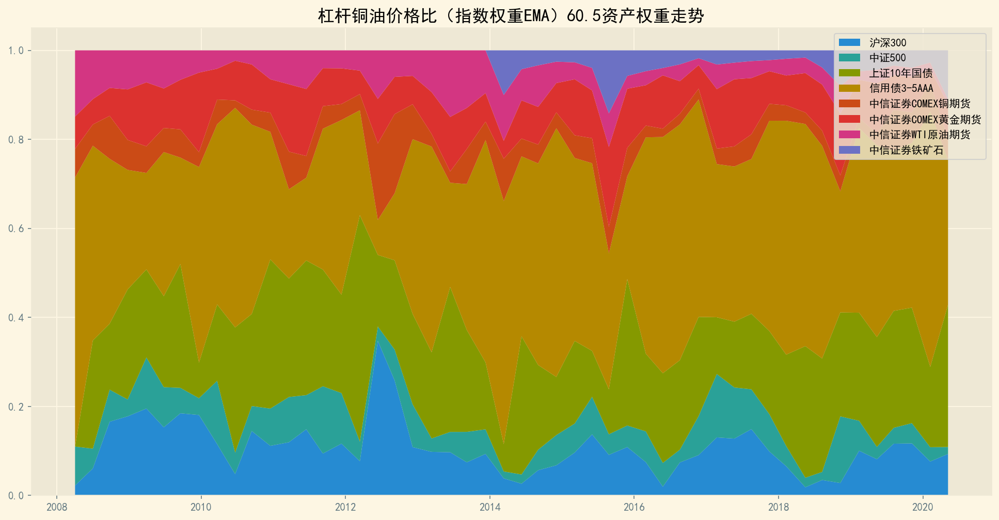

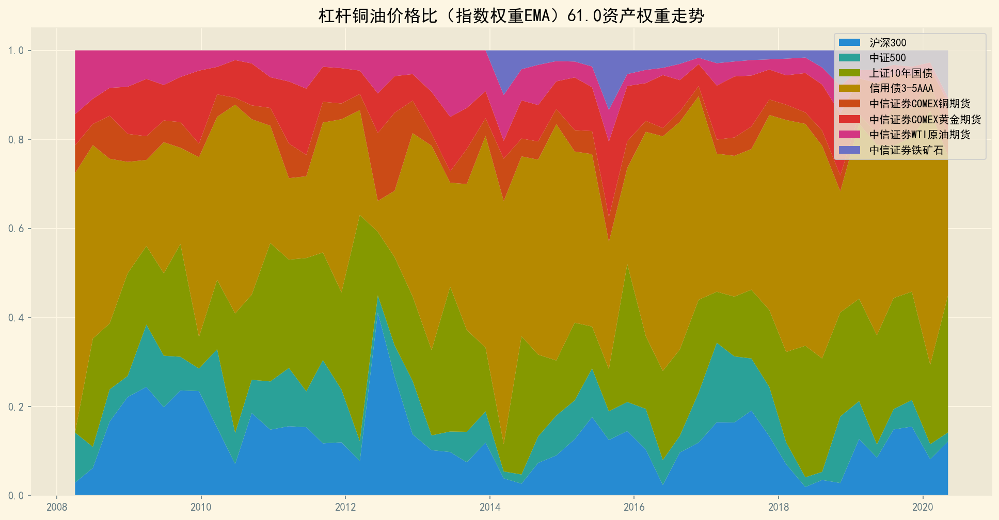

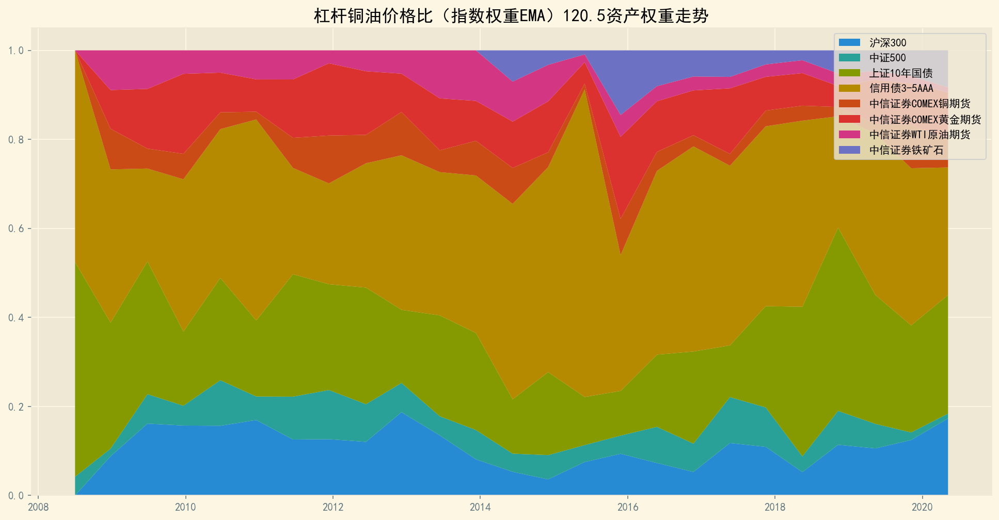

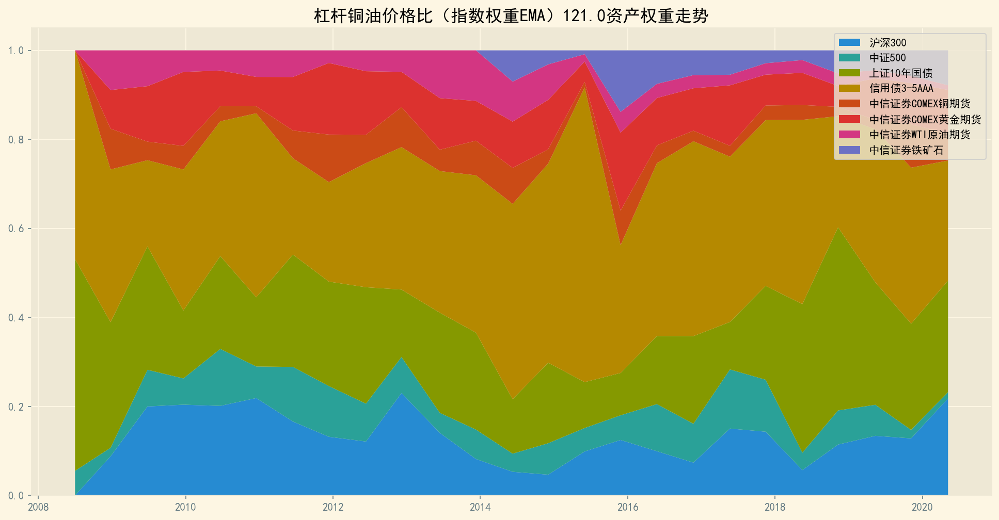

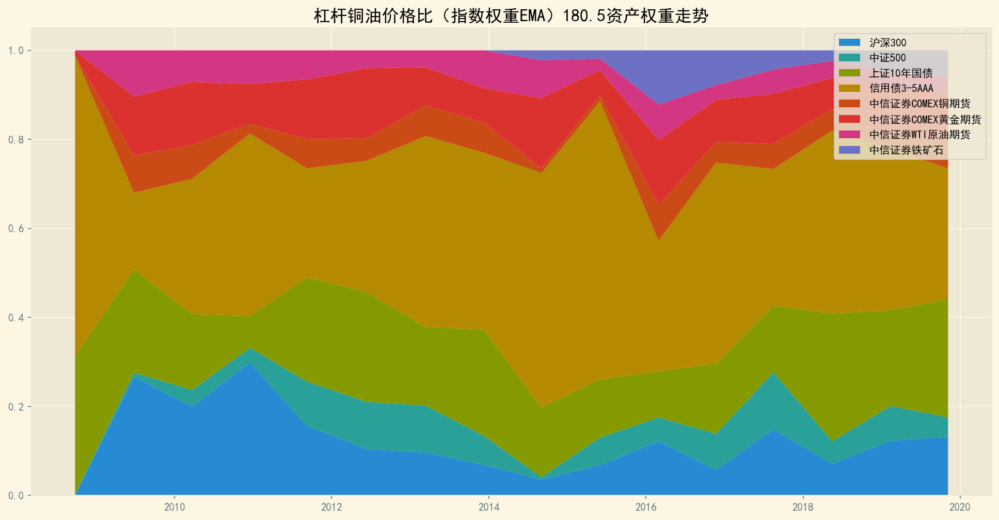

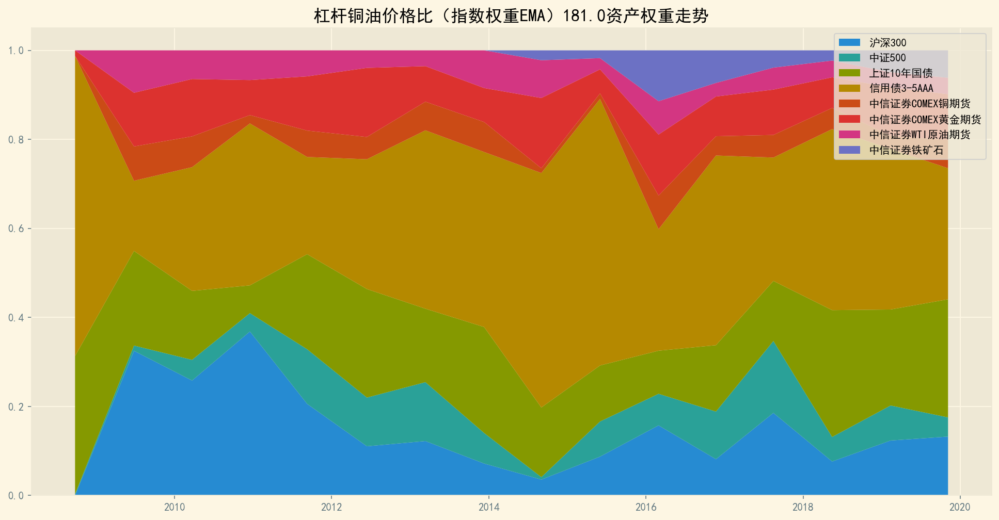

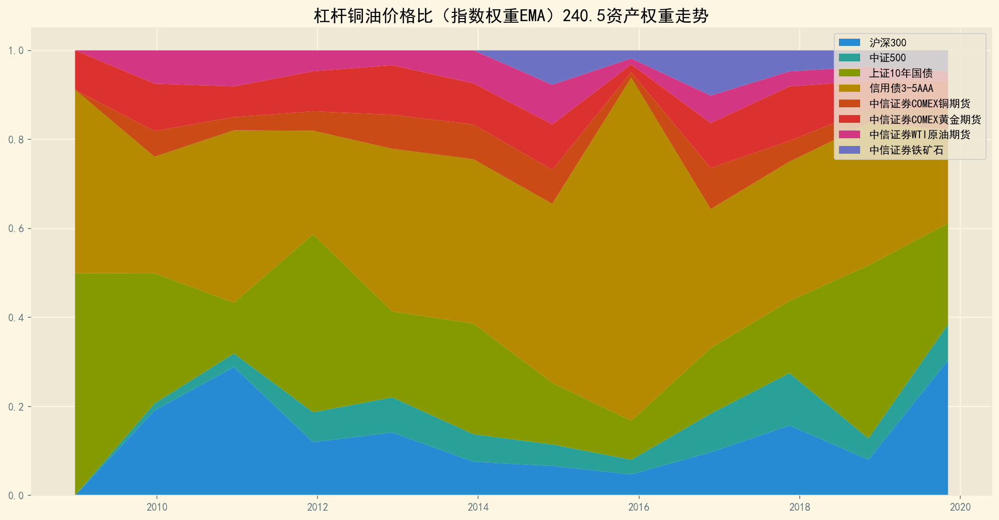

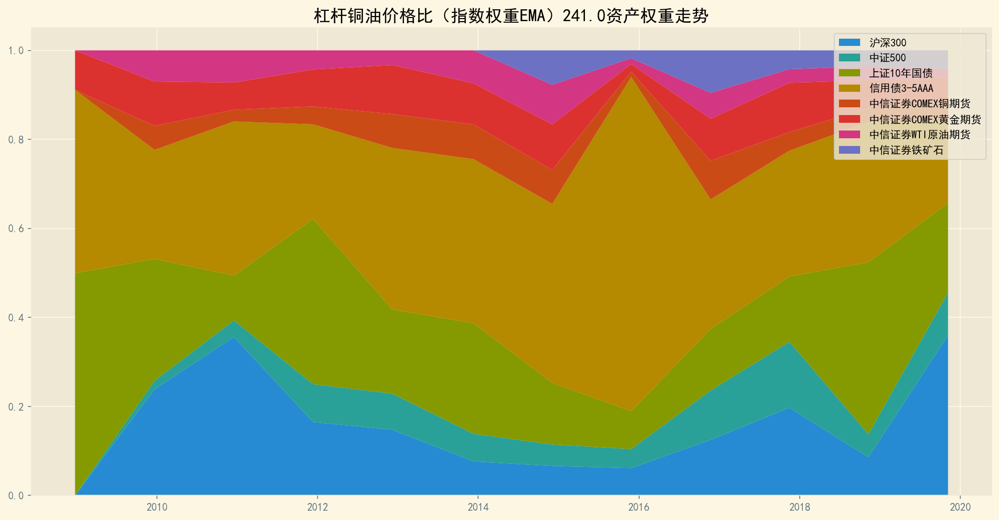

In [23]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
            'reverseX':False, 'reverseT':False,
            'turnover':False, 
            'copperGold':False, 'copperGas':True}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='ema', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆铜油价格比（指数权重EMA）'+str(t+u))

        leverNetValueDF_copperGas.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_copperGas.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_copperGas.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [24]:
# 汇总
leverSummaryDF_copperGas = pd.DataFrame(index=multiIDX)

leverSummaryDF_copperGas["年平均收益率"] = leverDailyPnlDF_copperGas.mean(axis=0).values * 250
leverSummaryDF_copperGas["年平均标准差"] = leverDailyPnlDF_copperGas.std(axis=0).values * np.sqrt(250)
leverSummaryDF_copperGas["无基准夏普比率"] = leverSummaryDF_copperGas["年平均收益率"] / leverSummaryDF_copperGas["年平均标准差"]
leverSummaryDF_copperGas["最大回撤"] = leverDrawDownDF_copperGas.min(axis=0).values

leverSummaryDF_copperGas

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.075285  0.078634  0.957414 -0.163152
     1.0   0.074451  0.083552  0.891079 -0.173524
60   0.5   0.084722  0.079402  1.066990 -0.134805
     1.0   0.086265  0.085366  1.010528 -0.137515
120  0.5   0.117454  0.079048  1.485868 -0.145058
     1.0   0.116034  0.082790  1.401544 -0.149289
180  0.5   0.087409  0.078512  1.113326 -0.119225
     1.0   0.083527  0.082885  1.007750 -0.127093
240  0.5   0.050869  0.069906  0.727683 -0.121835
     1.0   0.045337  0.073878  0.613677 -0.122363

### 各投资组合净值曲线

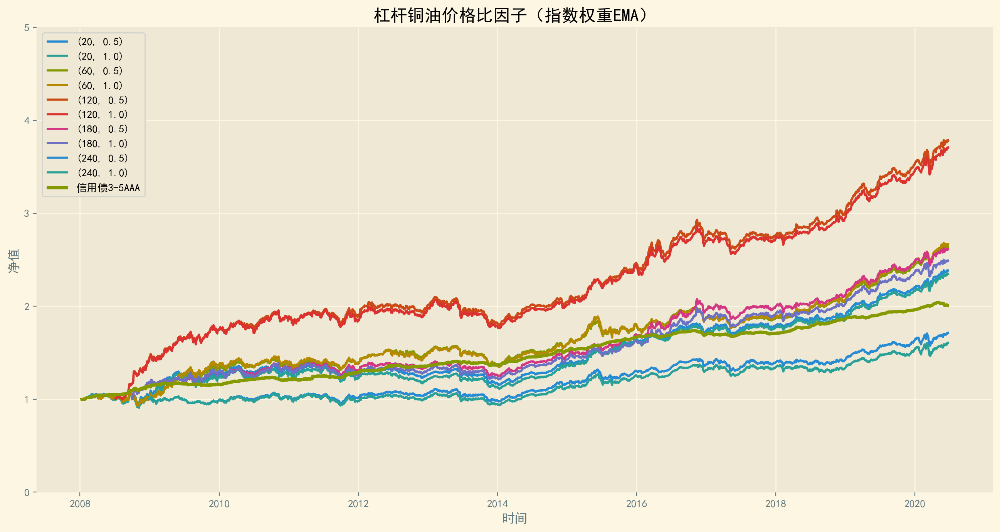

In [25]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_copperGas.columns:
    plt.plot(leverNetValueDF_copperGas.index, leverNetValueDF_copperGas[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆铜油价格比因子（指数权重EMA）')
plt.show()

# 风险平价+杠杆+多因子策略（指数平均EMA）

## 多因子（铜金 + 时序反转）

### 程序运行

In [102]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_multi = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_multi = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_multi = pd.DataFrame(index=Returns.index, columns=multiIDX)

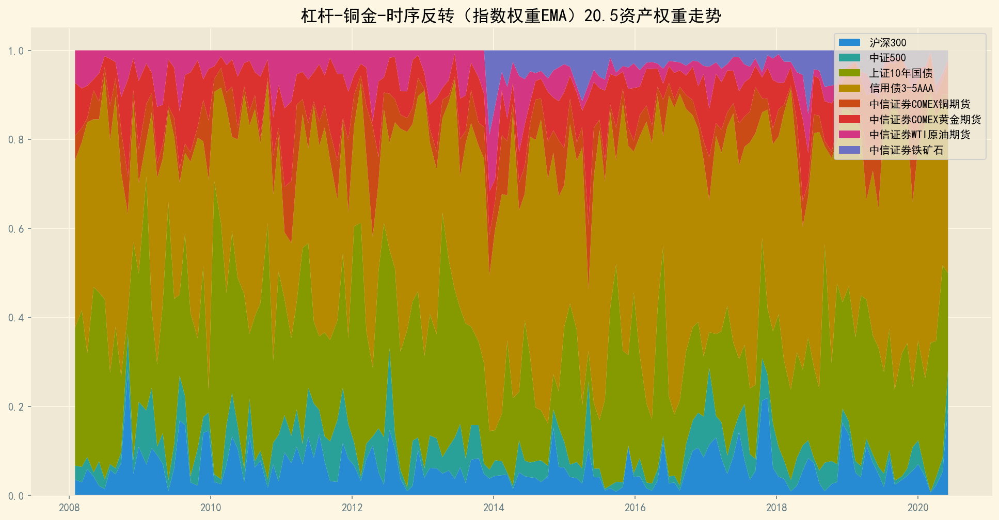

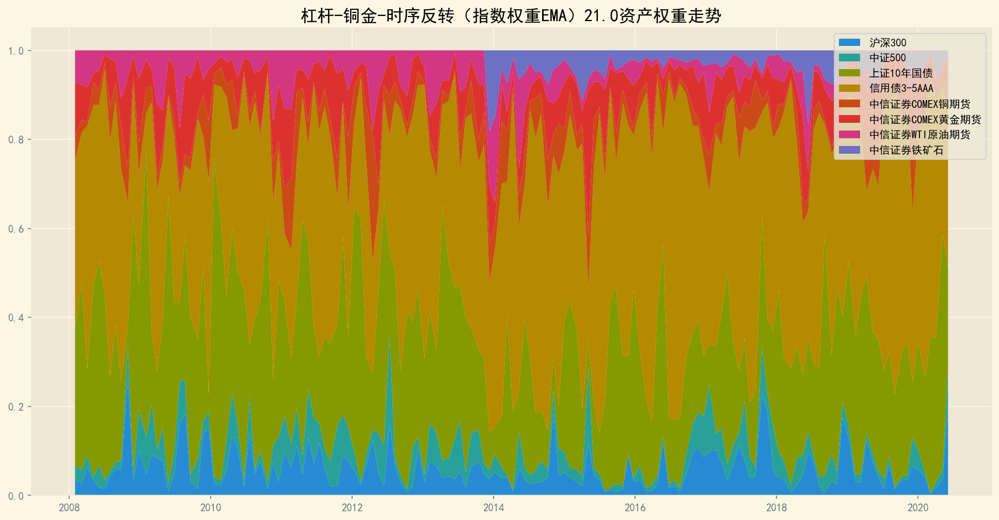

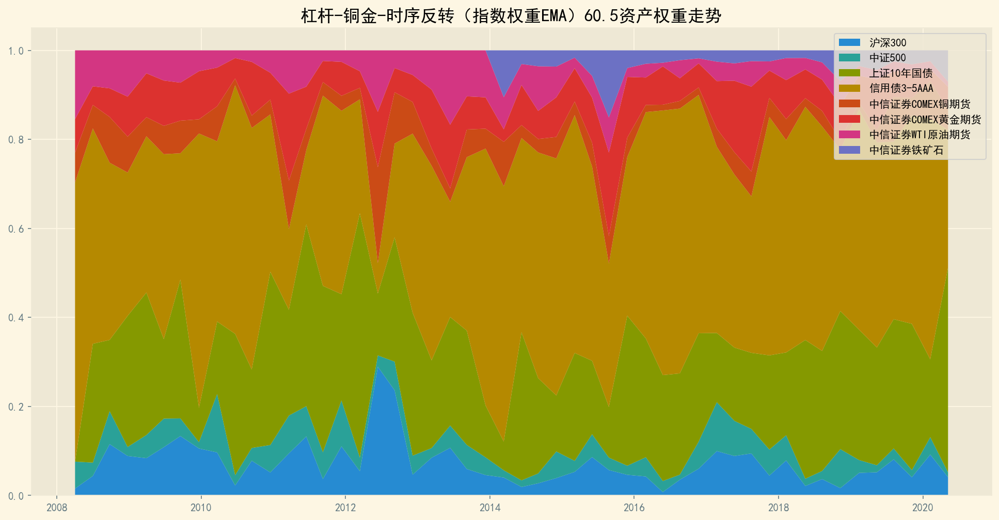

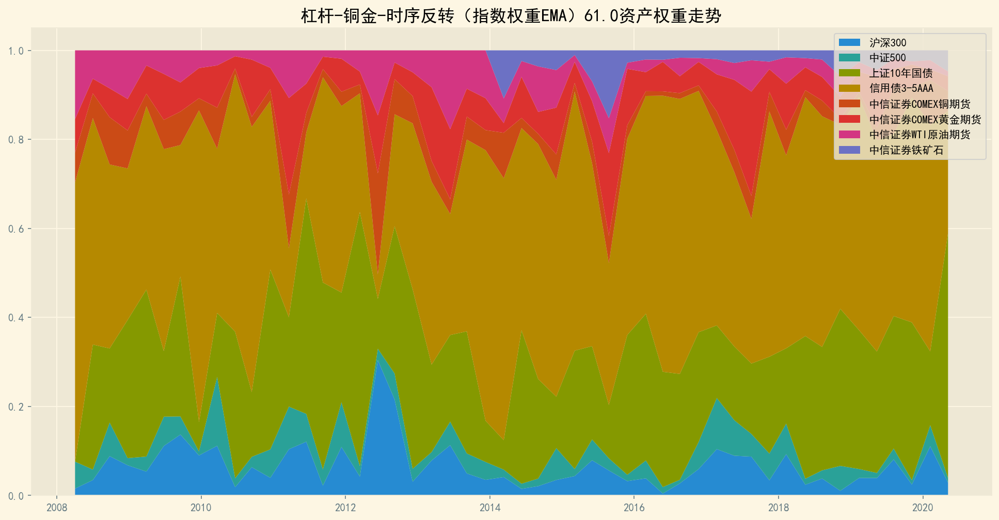

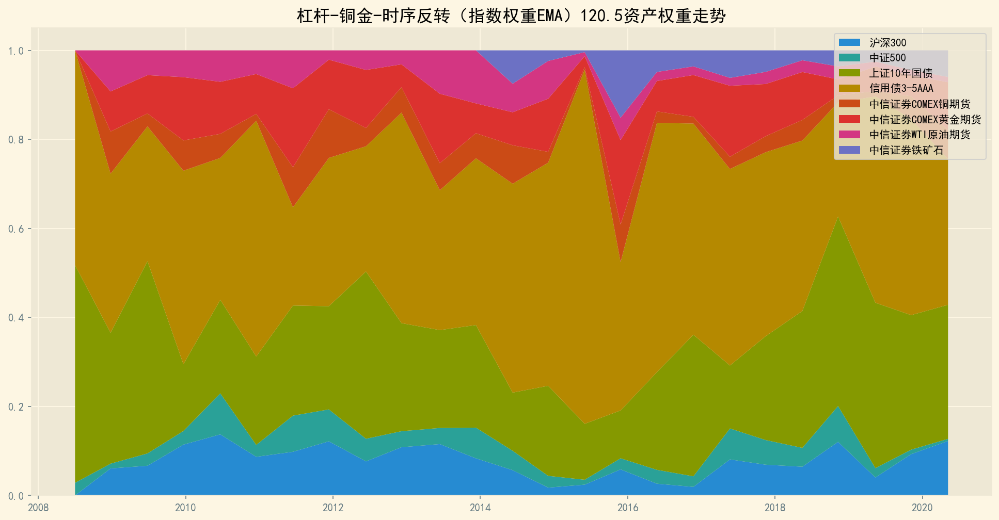

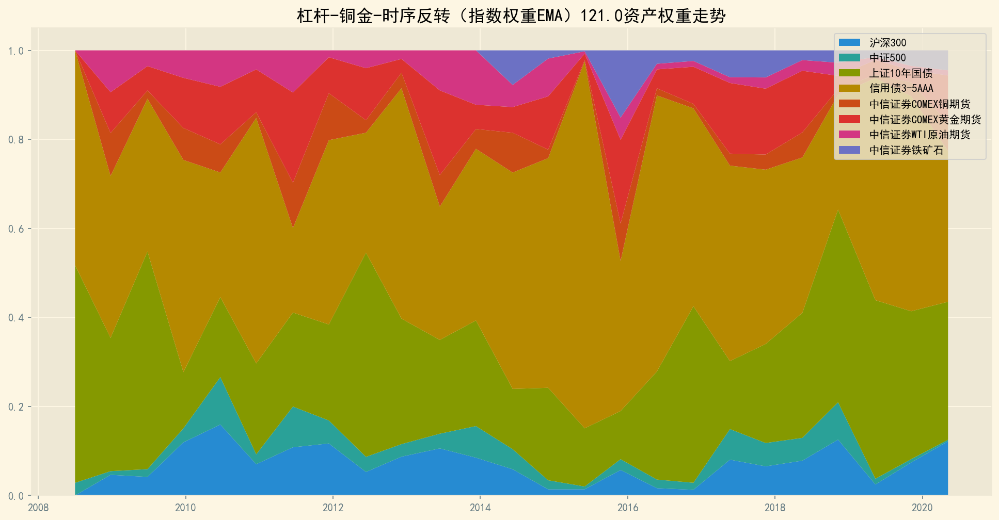

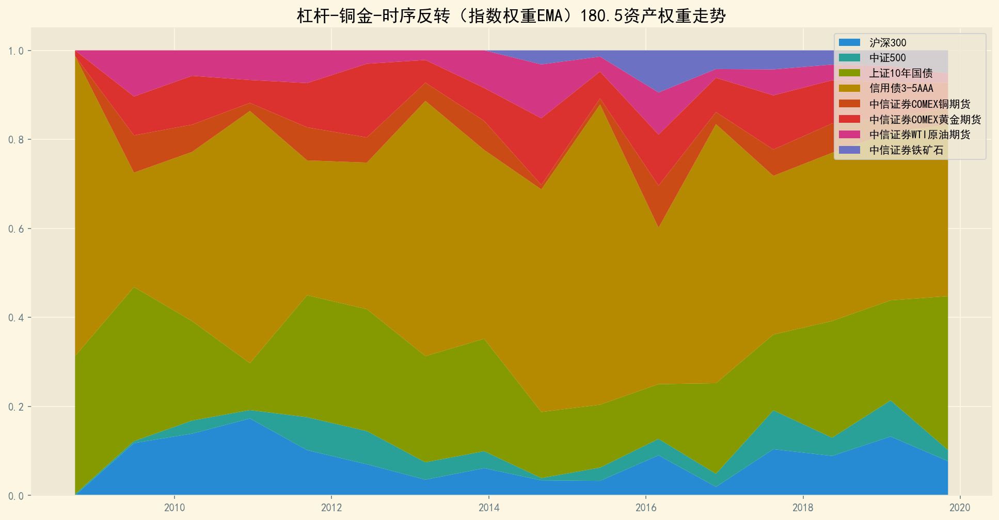

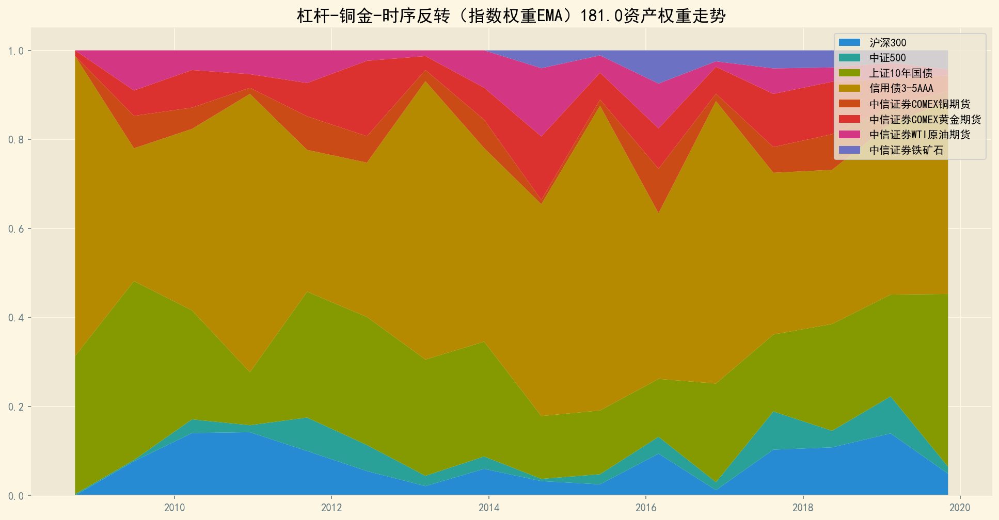

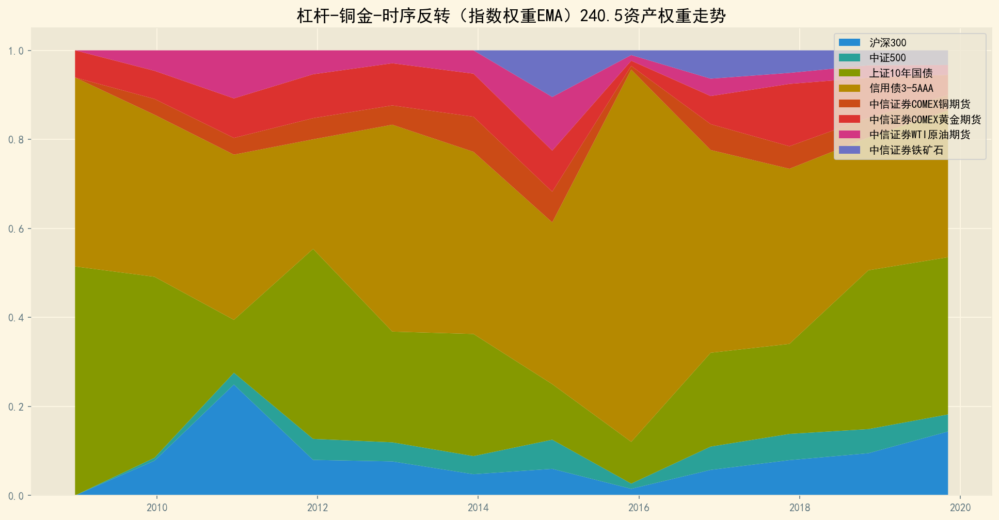

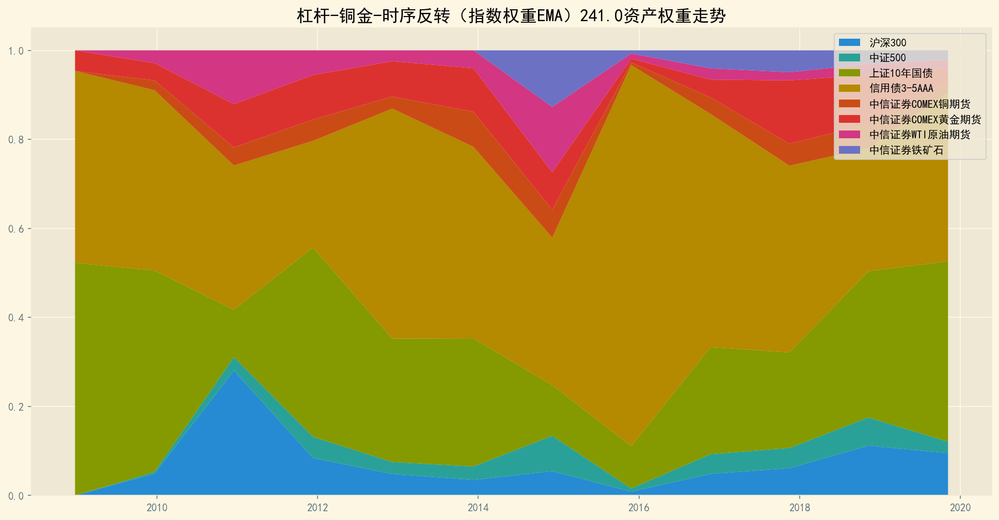

In [103]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
            'reverseX':False, 'reverseT':True,
            'turnover':False, 
            'copperGold':True, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='ema', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆-铜金-时序反转（指数权重EMA）'+str(t+u))

        leverNetValueDF_multi.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_multi.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_multi.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [104]:
# 汇总
leverSummaryDF_multi = pd.DataFrame(index=multiIDX)

leverSummaryDF_multi["年平均收益率"] = leverDailyPnlDF_multi.mean(axis=0).values * 250
leverSummaryDF_multi["年平均标准差"] = leverDailyPnlDF_multi.std(axis=0).values * np.sqrt(250)
leverSummaryDF_multi["无基准夏普比率"] = leverSummaryDF_multi["年平均收益率"] / leverSummaryDF_multi["年平均标准差"]
leverSummaryDF_multi["最大回撤"] = leverDrawDownDF_multi.min(axis=0).values

leverSummaryDF_multi

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.078351  0.070624  1.109413 -0.152369
     1.0   0.079793  0.069805  1.143086 -0.161434
60   0.5   0.080923  0.072199  1.120831 -0.122908
     1.0   0.078481  0.072447  1.083301 -0.121931
120  0.5   0.117373  0.073154  1.604460 -0.133174
     1.0   0.116343  0.073518  1.582513 -0.132216
180  0.5   0.085432  0.069140  1.235648 -0.138110
     1.0   0.081009  0.067544  1.199344 -0.144111
240  0.5   0.050049  0.063151  0.792531 -0.132870
     1.0   0.045807  0.064580  0.709303 -0.146103

### 各投资组合净值曲线

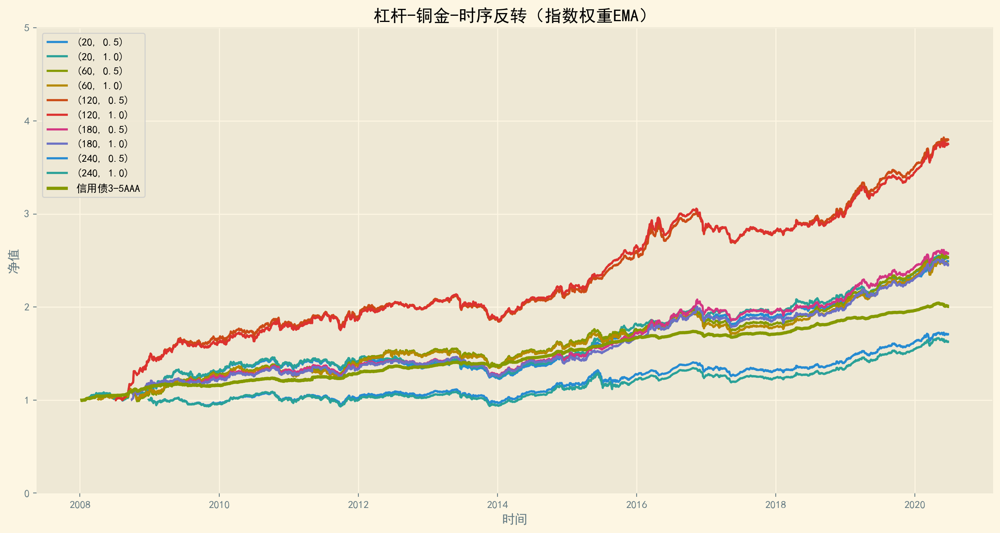

In [105]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_multi.columns:
    plt.plot(leverNetValueDF_multi.index, leverNetValueDF_multi[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆-铜金-时序反转（指数权重EMA）')
plt.show()

## 多因子（铜油 + 时序反转）

### 程序运行

In [106]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_multi2 = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_multi2 = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_multi2 = pd.DataFrame(index=Returns.index, columns=multiIDX)

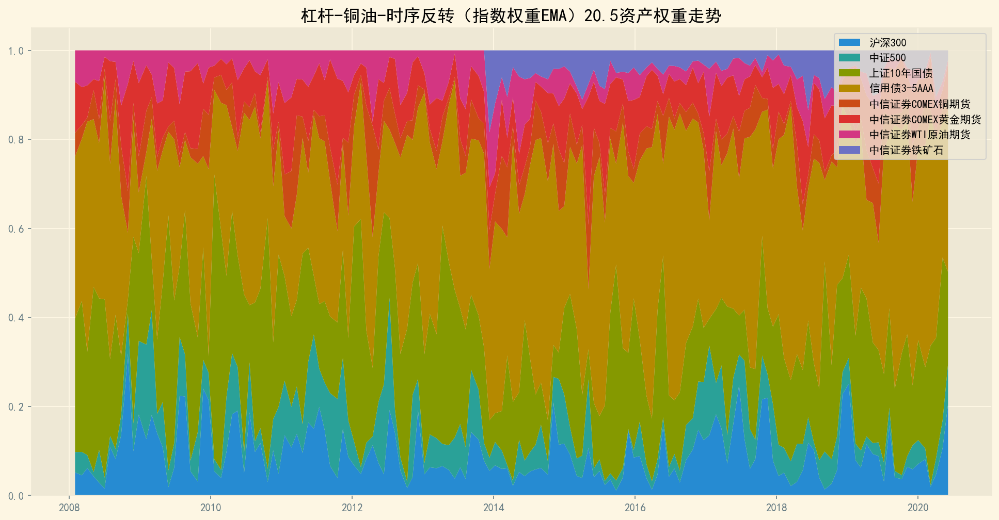

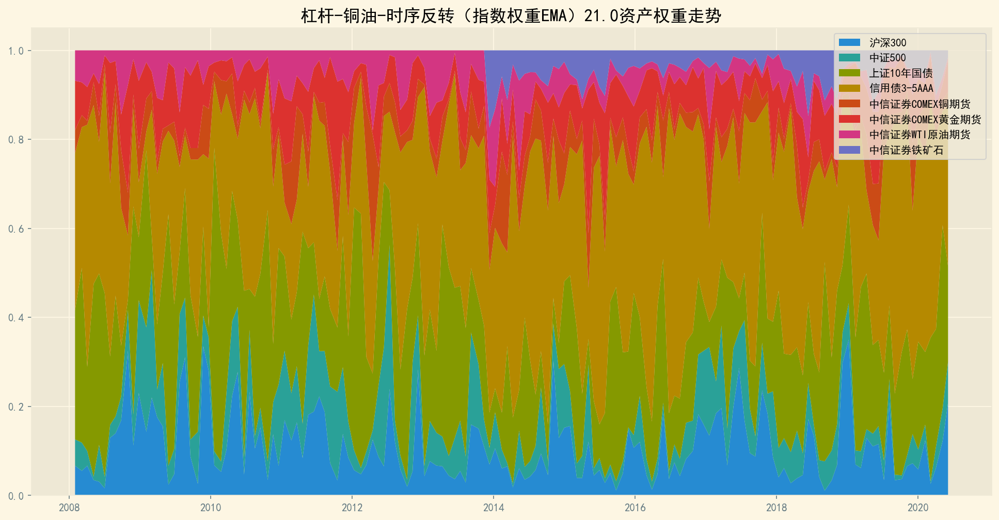

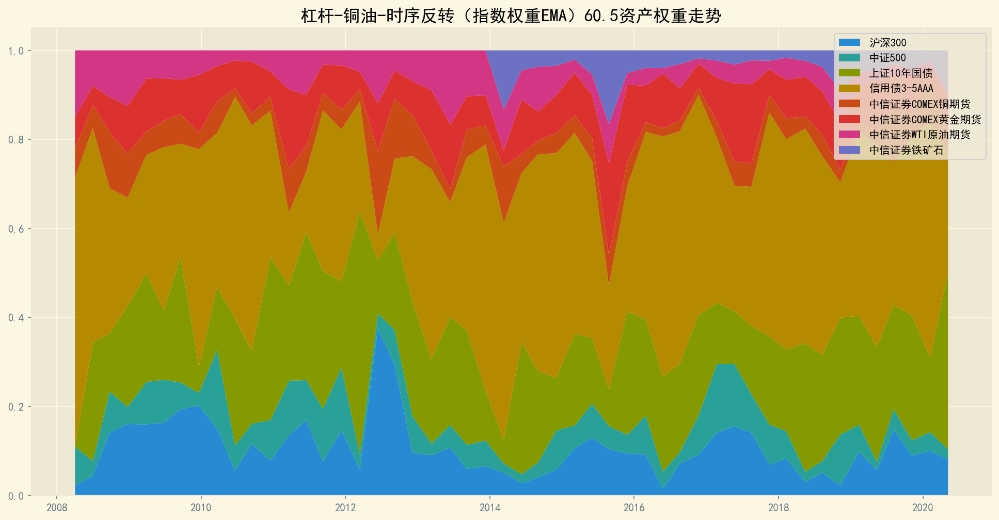

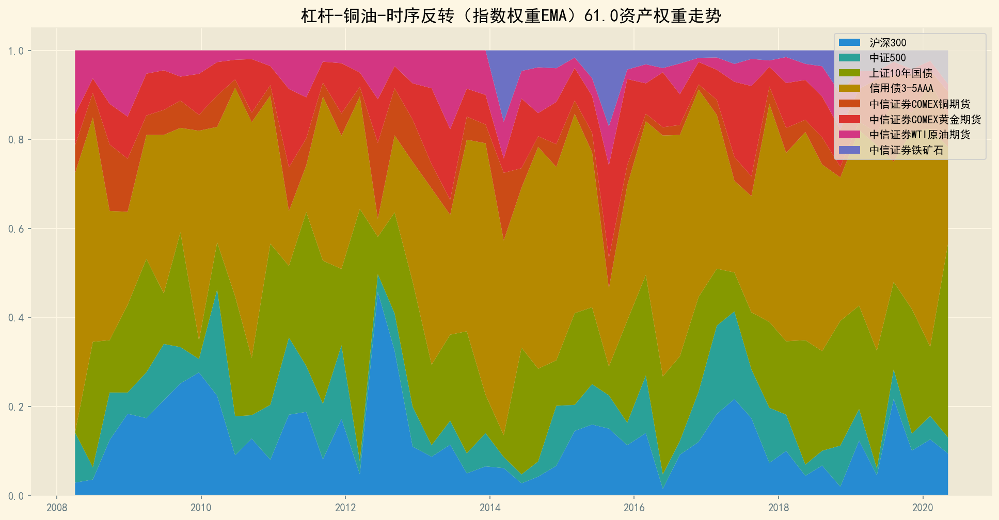

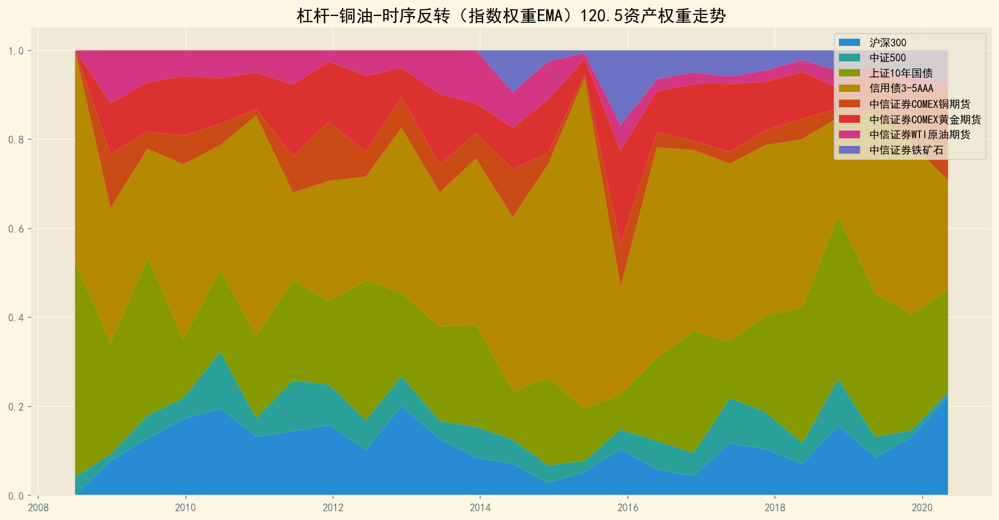

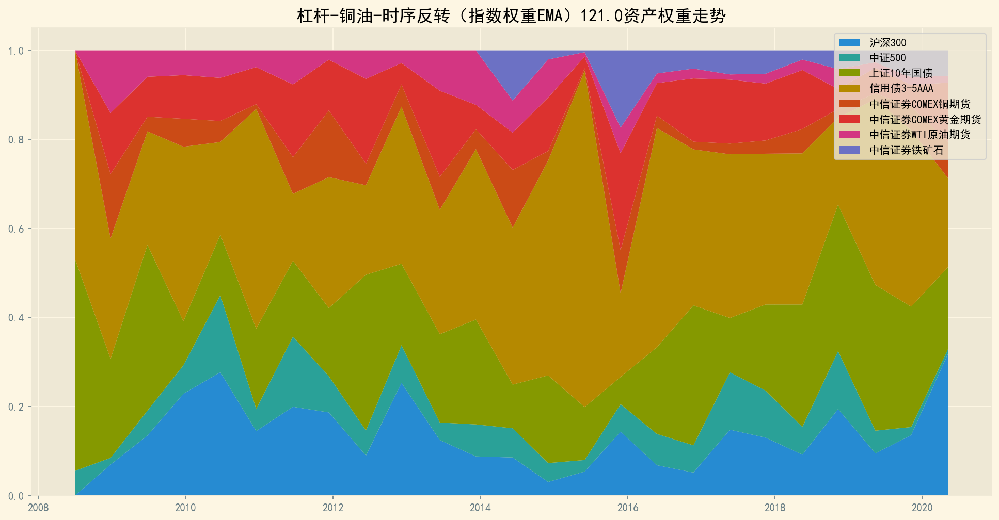

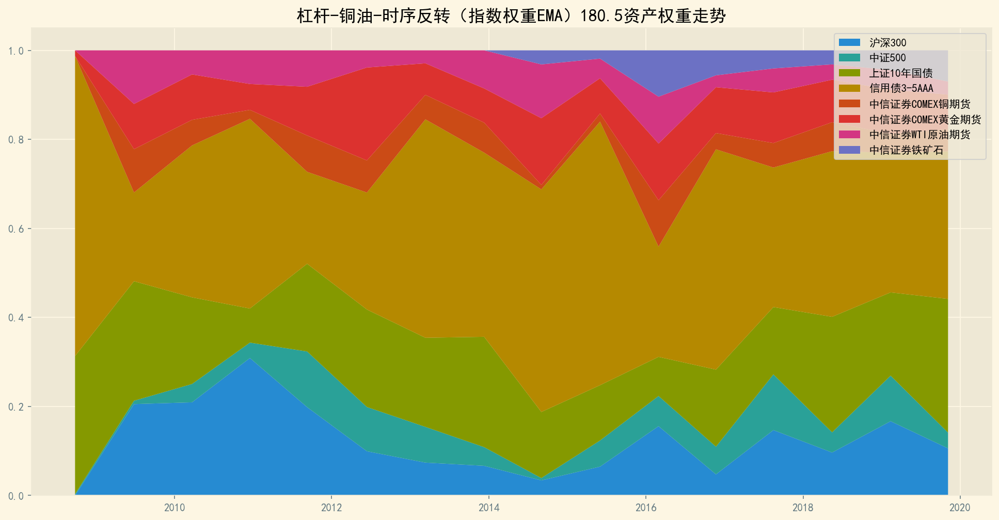

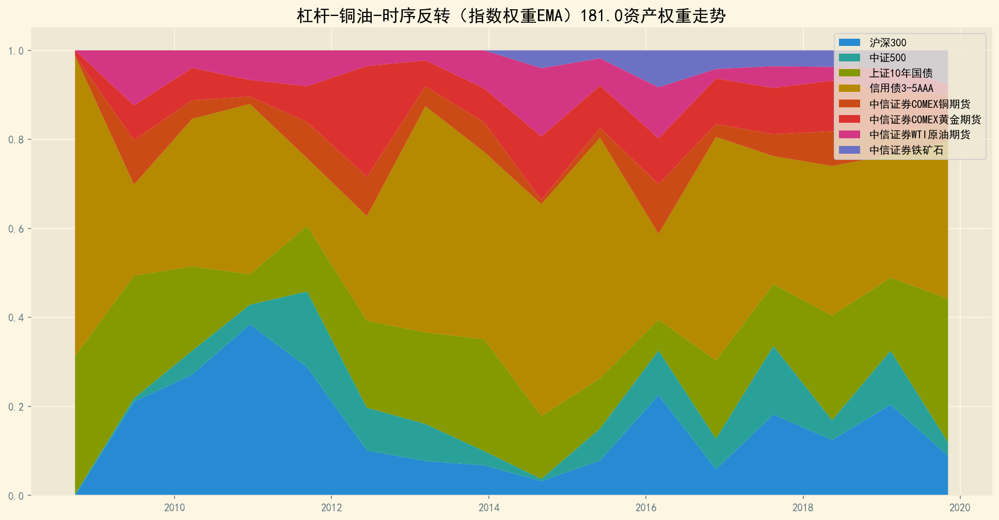

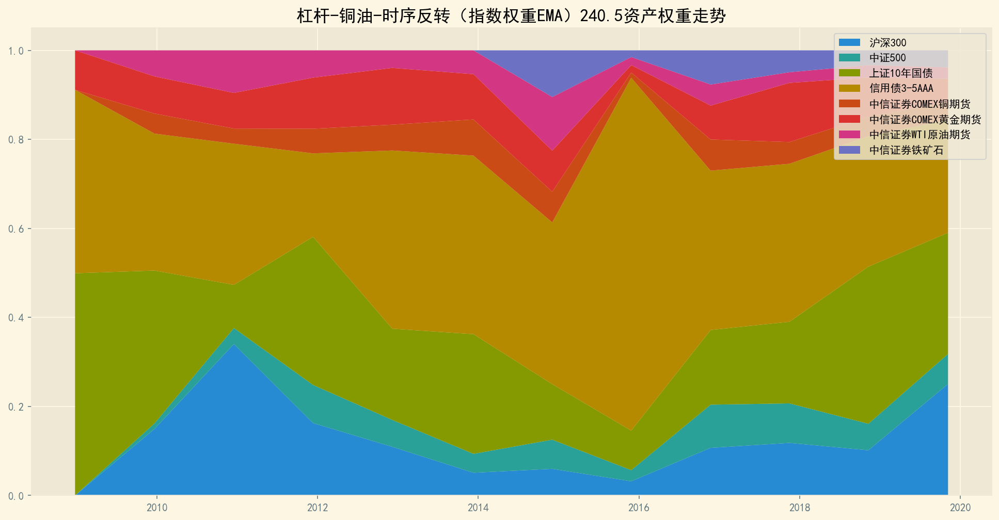

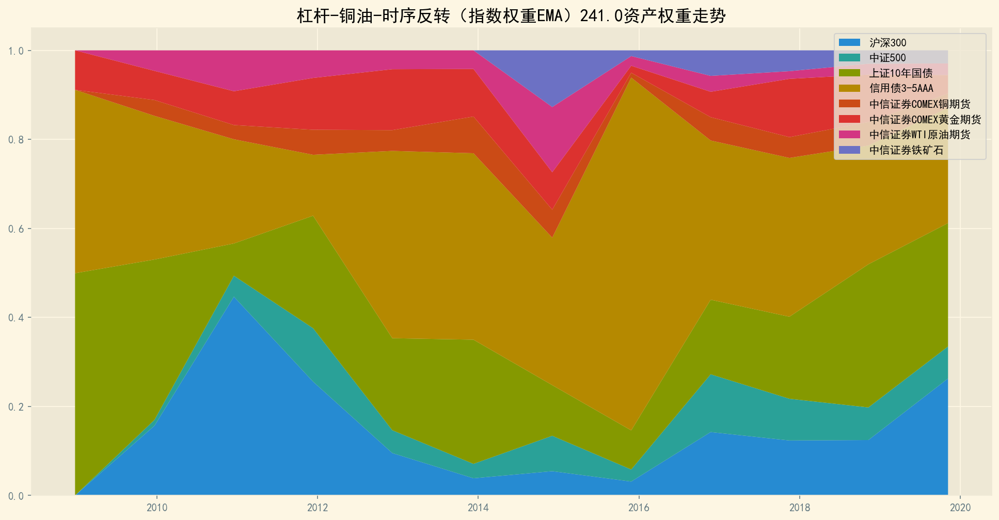

In [107]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
            'reverseX':False, 'reverseT':True,
            'turnover':False, 
            'copperGold':False, 'copperGas':True}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='ema', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆-铜油-时序反转（指数权重EMA）'+str(t+u))

        leverNetValueDF_multi2.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_multi2.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_multi2.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [108]:
# 汇总
leverSummaryDF_multi2 = pd.DataFrame(index=multiIDX)

leverSummaryDF_multi2["年平均收益率"] = leverDailyPnlDF_multi2.mean(axis=0).values * 250
leverSummaryDF_multi2["年平均标准差"] = leverDailyPnlDF_multi2.std(axis=0).values * np.sqrt(250)
leverSummaryDF_multi2["无基准夏普比率"] = leverSummaryDF_multi2["年平均收益率"] / leverSummaryDF_multi2["年平均标准差"]
leverSummaryDF_multi2["最大回撤"] = leverDrawDownDF_multi2.min(axis=0).values

leverSummaryDF_multi2

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.073678  0.080547  0.914724 -0.170837
     1.0   0.071836  0.087713  0.818993 -0.194546
60   0.5   0.082396  0.082533  0.998339 -0.148288
     1.0   0.081081  0.091314  0.887931 -0.170177
120  0.5   0.121191  0.082181  1.474681 -0.140693
     1.0   0.121984  0.089072  1.369498 -0.145509
180  0.5   0.079757  0.078905  1.010794 -0.143620
     1.0   0.070158  0.084657  0.828731 -0.190738
240  0.5   0.045858  0.069294  0.661785 -0.143862
     1.0   0.037521  0.074583  0.503081 -0.208614

### 各投资组合净值曲线

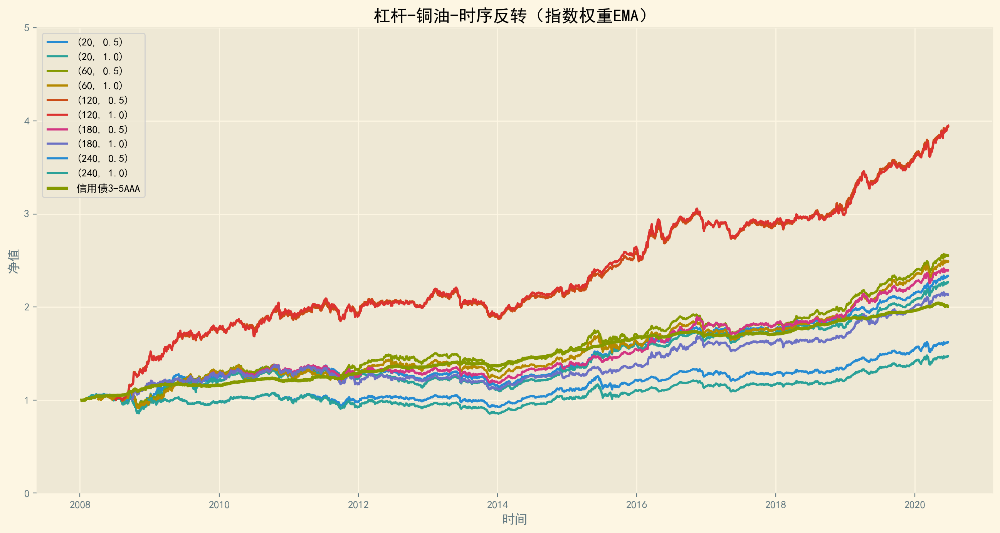

In [109]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_multi2.columns:
    plt.plot(leverNetValueDF_multi2.index, leverNetValueDF_multi2[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆-铜油-时序反转（指数权重EMA）')
plt.show()

# 最佳组合（杠杆+时序动量+铜金）

## 程序运行

In [45]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_best = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_best = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_best = pd.DataFrame(index=Returns.index, columns=multiIDX)

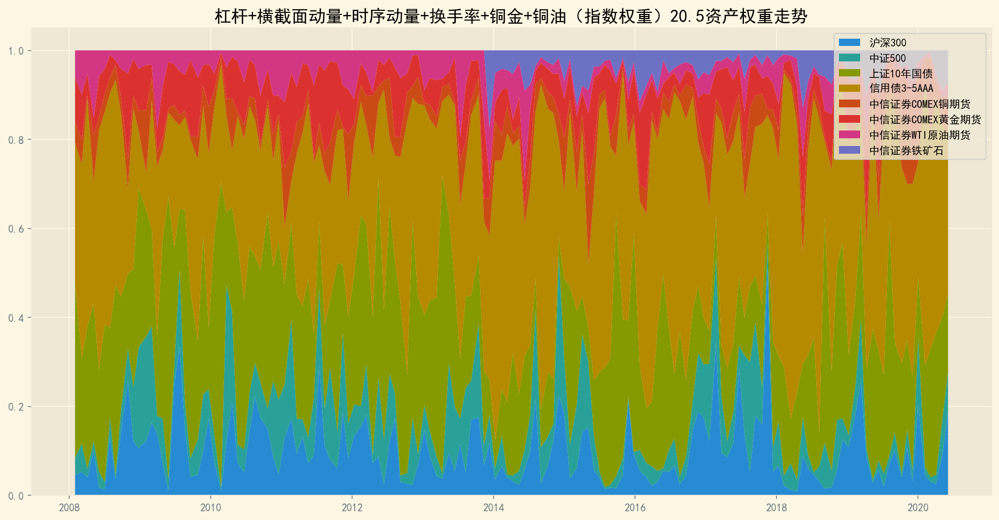

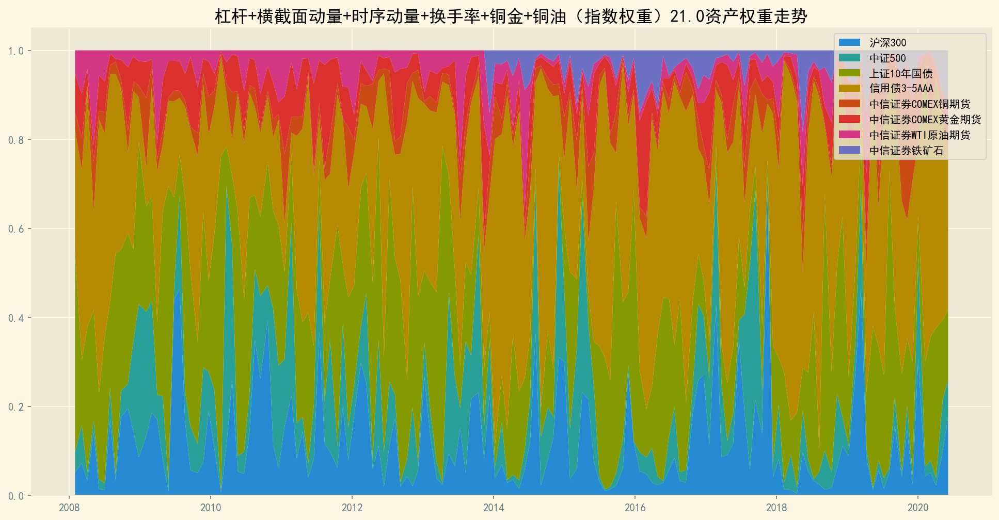

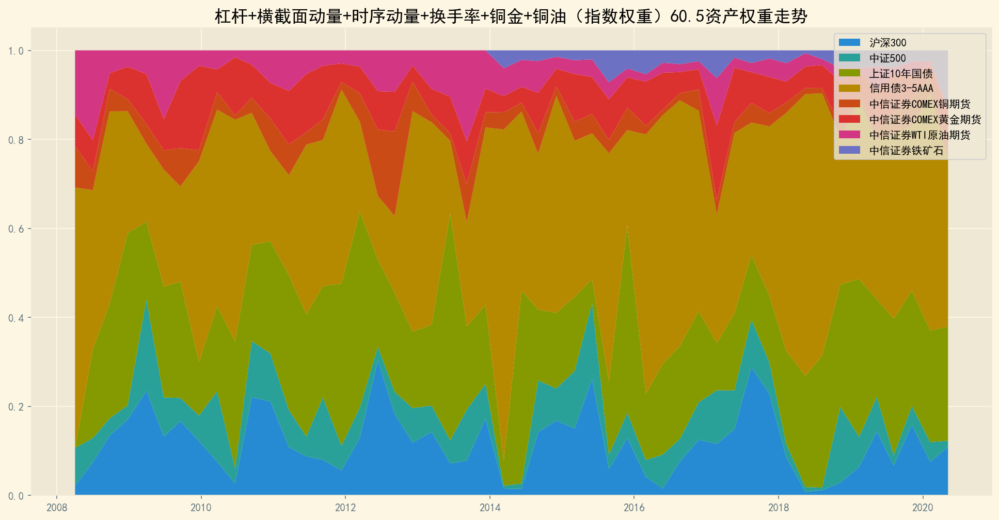

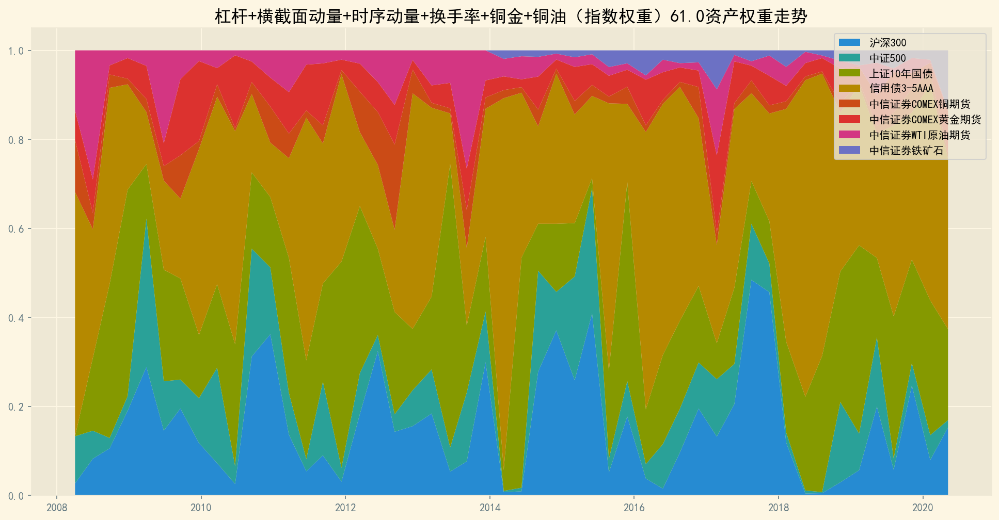

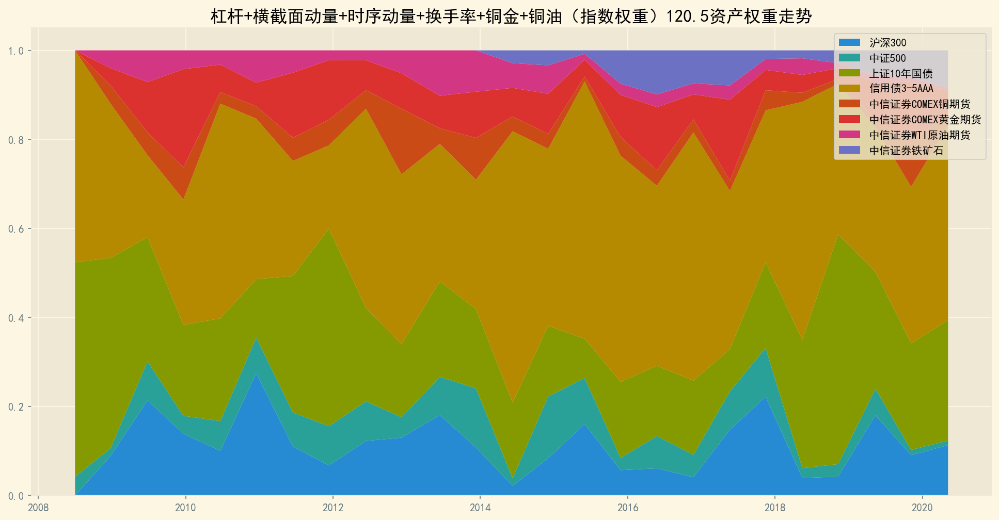

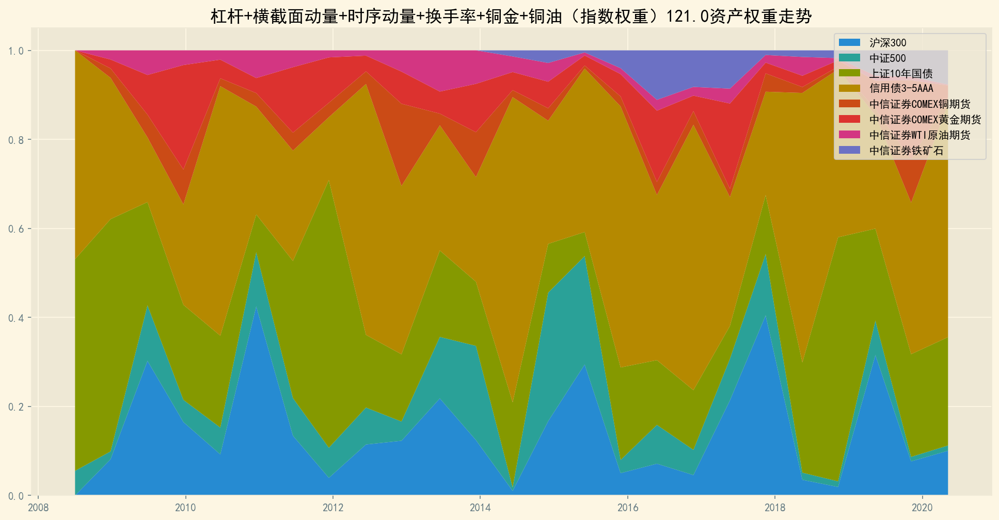

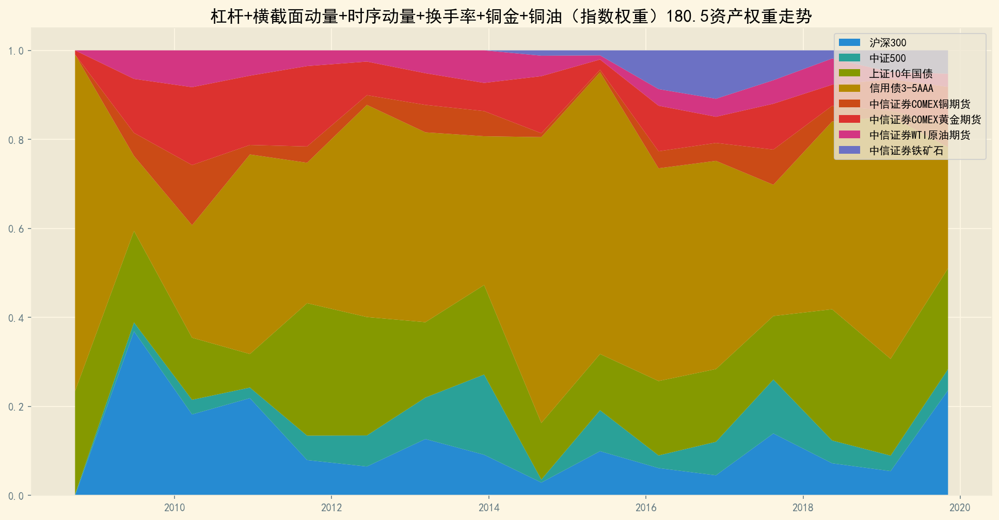

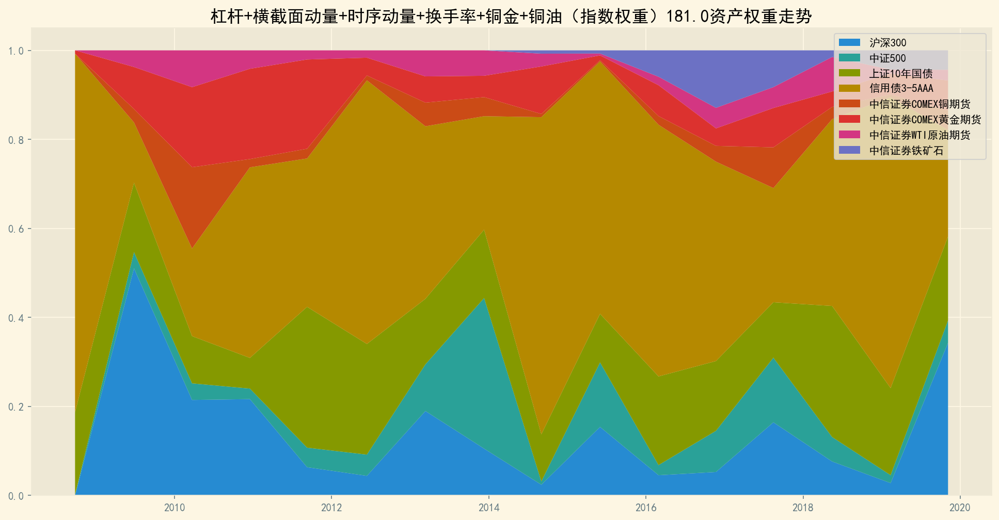

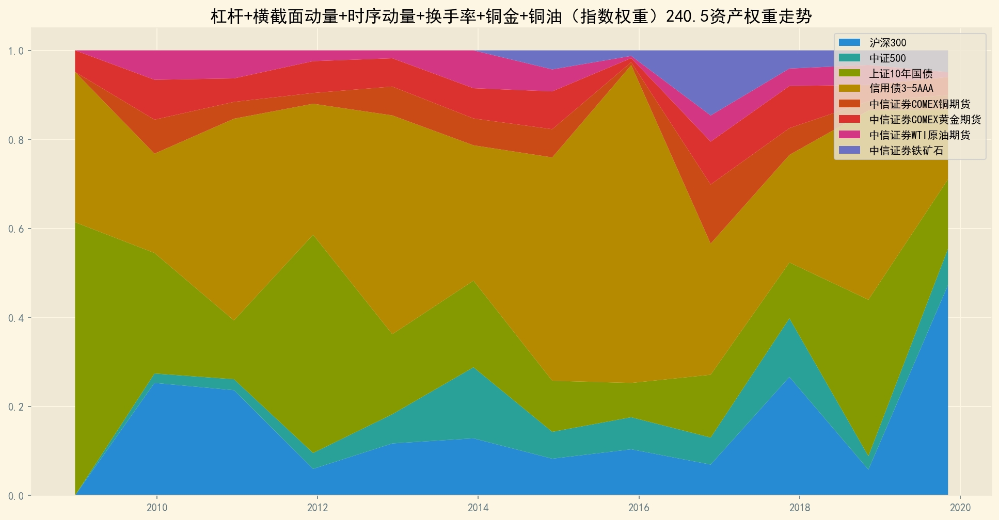

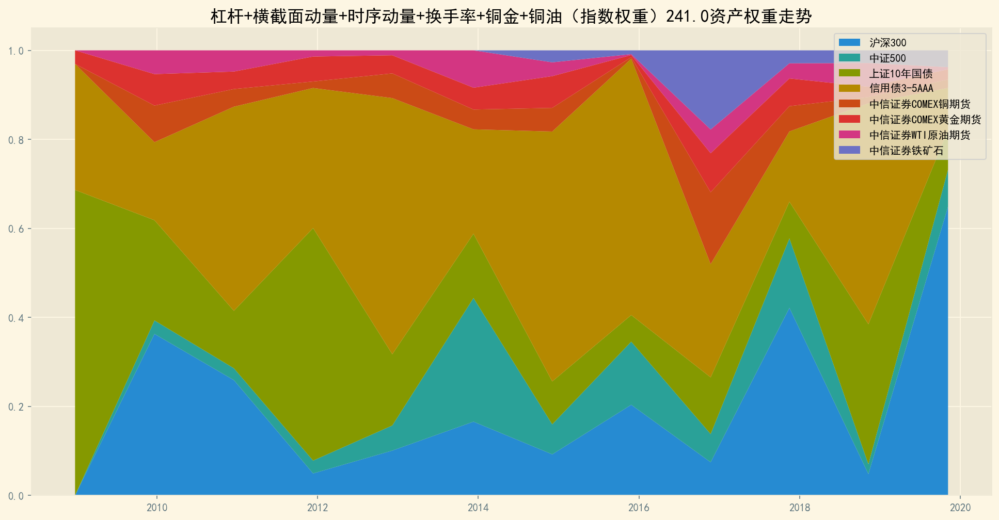

In [46]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':True, 'momentumT':True, 
            'reverseX':False, 'reverseT':False,
            'turnover':True, 
            'copperGold':True, 'copperGas':True}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='ema', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆+横截面动量+时序动量+换手率+铜金+铜油（指数权重）'+str(t+u))

        leverNetValueDF_best.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_best.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_best.loc[:, (t, u)] = tradeDF['最大回撤']                      

## 回测表现汇总

In [47]:
# 汇总
leverSummaryDF_best = pd.DataFrame(index=multiIDX)

leverSummaryDF_best["年平均收益率"] = leverDailyPnlDF_best.mean(axis=0).values * 250
leverSummaryDF_best["年平均标准差"] = leverDailyPnlDF_best.std(axis=0).values * np.sqrt(250)
leverSummaryDF_best["无基准夏普比率"] = leverSummaryDF_best["年平均收益率"] / leverSummaryDF_best["年平均标准差"]
leverSummaryDF_best["最大回撤"] = leverDrawDownDF_best.min(axis=0).values

leverSummaryDF_best

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.086181  0.080905  1.065220 -0.176782
     1.0   0.092382  0.095073  0.971692 -0.215558
60   0.5   0.084084  0.083536  1.006558 -0.185857
     1.0   0.083554  0.105545  0.791644 -0.300383
120  0.5   0.111865  0.078696  1.421489 -0.134323
     1.0   0.110002  0.097514  1.128063 -0.217345
180  0.5   0.090177  0.078904  1.142875 -0.125546
     1.0   0.086929  0.089916  0.966776 -0.148364
240  0.5   0.051708  0.076032  0.680088 -0.134919
     1.0   0.045055  0.090164  0.499698 -0.168114

## 各投资组合净值曲线

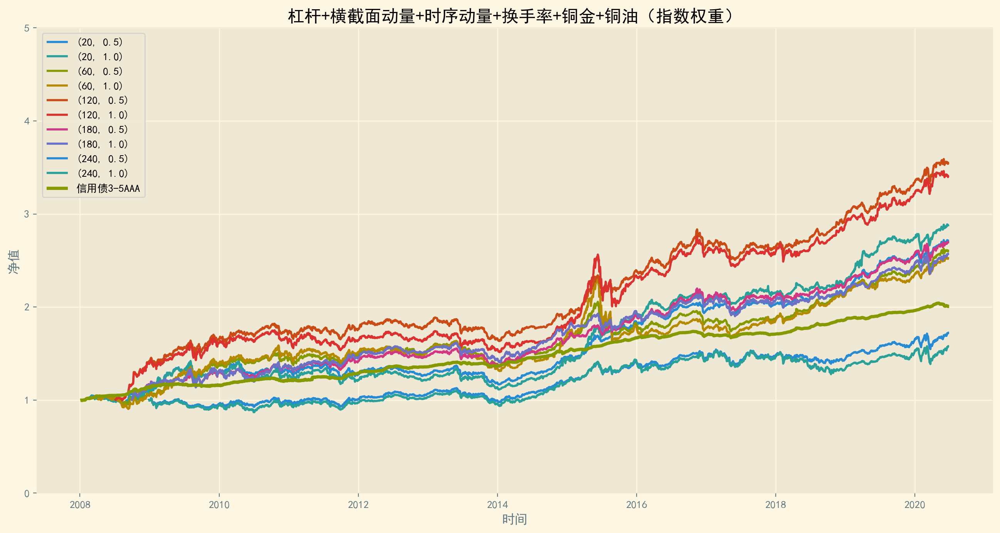

In [48]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_best.columns:
    plt.plot(leverNetValueDF_best.index, leverNetValueDF_best[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆+横截面动量+时序动量+换手率+铜金+铜油（指数权重）')
plt.show()